In [93]:
library('hdp')
library('clusterCrit')
library('grid')
library('gridExtra')
library('ggplot2')
library('ggrepel')
library('RColorBrewer')
library('dplyr')
library('reshape2')
library('IRdisplay')
library('scales')
library('survival')
library('corrplot')
library('Hmisc')
source('../../../src/tools.R')     # custom tools function
source('../../../src/hdp_tools_yanis.R')
###       
source("../../../src/merge_df.R")
source("../../../src/my_toolbox.R")
source("../../../src/my_components.R")
source("../../../src/my_utils.R")
source("../../../src/ggstyles.R")
source("../../../src/my_hotspots.R")
###


theme_set(theme_minimal())

# set jupyer notebook parameters
options(repr.plot.res        = 100, # set a medium-definition resolution for the jupyter notebooks plots (DPI)
        repr.matrix.max.rows = 200, # set the maximum number of rows displayed
        repr.matrix.max.cols = 200) # set the maximum number of columns displayed


---

# Some useful functions 


In [2]:
correlates <- c("gender","age","ahd","perf_status","bm_blasts","secondary","wbc","hb","plt","os","cr","os_status","cod")
binary_correlates <- c("gender","ahd","perf_status","secondary","os_status","cr")
continuous_correlates <- c("age","wbc","hb","plt","bm_blasts","os","cod")
val=c("grey45", "#e79f00", "#009E73","#0072B2",  "#CC79A7",
                                      "#9ad0f3", "#D55E00","lightskyblue","mistyrose4", "darkseagreen","lightgoldenrod","lightsalmon","#F0E442","firebrick3","#000000")

In [3]:
plottings_comparison <-function(df1,df2=NULL,df3=NULL,df4=NULL,df5=NULL,df6=NULL,x1="", x2="",x3="",x4="",x5="",x6="",many=2,width=8,height=2){
        
    print (paste(paste("Count",x1,sep=" : "),toString(dim(df1)[1]),sep=" : "))
    print (paste(paste("Count",x2,sep=" : "),toString(dim(df2)[1]),sep=" : "))    
    if(many>=3){print(paste(paste("Count",x3,sep=" : "),toString(dim(df3)[1]),sep=" : "))}
    if(many>=4){print(paste(paste("Count",x4,sep=" : "),toString(dim(df4)[1]),sep=" : "))}
    if(many>=5){print(paste(paste("Count",x5,sep=" : "),toString(dim(df5)[1]),sep=" : "))}
    if(many>=6){print(paste(paste("Count",x6,sep=" : "),toString(dim(df6)[1]),sep=" : "))}
    
    vals=c("0" = "grey45", "1" = "#e79f00", "2" = "#009E73", "3" ="#0072B2", "4"="#CC79A7")
    set_notebook_plot_size(width,height)
    theme_1 = theme(axis.text.x = element_blank(),axis.ticks.x = element_blank())
    
    for (col in binary_correlates){ 
        p1 <-ggplot(df1, aes(factor(comparison), fill = factor(df1[,col]))) + 
            geom_bar(position = "fill") +scale_y_continuous(labels = scales::percent)+labs(x=x1,fill=col)+
            scale_fill_manual(values = vals) + theme_1
        if (many==1){
            plot(p1)
        }else if (many==2){
            p2 <-ggplot(df2, aes(factor(comparison), fill = factor(df2[,col]))) + 
                geom_bar(position = "fill") +scale_y_continuous(labels = scales::percent)+labs(x=x2,fill=col)+
                scale_fill_manual(values = vals) + theme_1
            grid.arrange(p1,p2,nrow=1)
        }else if (many==3){
            p2 <-ggplot(df2, aes(factor(comparison), fill = factor(df2[,col]))) + 
                geom_bar(position = "fill") +scale_y_continuous(labels = scales::percent)+labs(x=x2,fill=col)+
                scale_fill_manual(values = vals) + theme_1
            p3 <-ggplot(df3, aes(factor(comparison), fill = factor(df3[,col]))) + 
                geom_bar(position = "fill") +scale_y_continuous(labels = scales::percent)+labs(x=x3,fill=col)+
                scale_fill_manual(values = vals) + theme_1
            grid.arrange(p1,p2,p3,nrow=1)
        }else if (many==4){
            p2 <-ggplot(df2, aes(factor(comparison), fill = factor(df2[,col]))) + 
                geom_bar(position = "fill") +scale_y_continuous(labels = scales::percent)+xlab(x2)+labs(x=x2,fill=col)+
                scale_fill_manual(values = vals) + theme_1
            p3 <-ggplot(df3, aes(factor(comparison), fill = factor(df3[,col]))) + 
                geom_bar(position = "fill") +scale_y_continuous(labels = scales::percent)+labs(x=x3,fill=col)+
                scale_fill_manual(values = vals) + theme_1
            p4 <-ggplot(df4, aes(factor(comparison), fill = factor(df4[,col]))) + 
                geom_bar(position = "fill") +scale_y_continuous(labels = scales::percent)+labs(x=x4,fill=col)+
                scale_fill_manual(values = vals) + theme_1
            grid.arrange(p1,p2,p3,p4,nrow=1)
        }
    }
    for (col in continuous_correlates){
        mini=suppressWarnings(min(min(df1[,col],na.rm=T),min(df2[,col],na.rm=T),min(df3[,col],na.rm=T),min(df4[,col],na.rm=T),na.rm=T))
        maxi=suppressWarnings(max(max(df1[,col],na.rm=T),max(df2[,col],na.rm=T),max(df3[,col],na.rm=T),max(df4[,col],na.rm=T),na.rm=T))
 
        p1 <- ggplot(df1,aes(x=factor(comparison),y=df1[,col],fill=comparison)) +
                geom_boxplot(aes(fill = factor(comparison))) +  ylab(col)+xlab(x1)+ylim(mini,maxi) + theme_1 + scale_fill_manual(values=c("grey45","#e79f00")) 
        if (many==1){
            suppressWarnings(plot(p1))
        }else if(many==2){
            p2 <- ggplot(df2,aes(x=factor(comparison),y=df2[,col],fill=comparison)) +
                    geom_boxplot(aes(fill = factor(comparison))) +  ylab(col)+xlab(x2)+ylim(mini,maxi) + theme_1 + scale_fill_manual(values=c("grey45","#e79f00")) 
            suppressWarnings(grid.arrange(p1,p2,nrow=1))
        }else if(many==3){
            p2 <- ggplot(df2,aes(x=factor(comparison),y=df2[,col],fill=comparison)) +
                    geom_boxplot(aes(fill = factor(comparison))) +  ylab(col)+xlab(x2)+ylim(mini,maxi) + theme_1 + scale_fill_manual(values=c("grey45","#e79f00")) 
            p3 <- ggplot(df3,aes(x=factor(comparison),y=df3[,col],fill=comparison)) +
                    geom_boxplot(aes(fill = factor(comparison))) +  ylab(col)+xlab(x3)+ylim(mini,maxi) + theme_1 + scale_fill_manual(values=c("grey45","#e79f00")) 
            suppressWarnings(grid.arrange(p1,p2,p3,nrow=1))
        }else if(many==4){
            p2 <- ggplot(df2,aes(x=factor(comparison),y=df2[,col],fill=comparison)) +
                    geom_boxplot(aes(fill = factor(comparison))) +  ylab(col)+xlab(x2)+ylim(mini,maxi) + theme_1 + scale_fill_manual(values=c("grey45","#e79f00")) 
            p3 <- ggplot(df3,aes(x=factor(comparison),y=df3[,col],fill=comparison)) +
                    geom_boxplot(aes(fill = factor(comparison))) +  ylab(col)+xlab(x3)+ylim(mini,maxi) + theme_1 + scale_fill_manual(values=c("grey45","#e79f00")) 
            p4 <- ggplot(df4,aes(x=factor(comparison),y=df4[,col],fill=comparison)) +
                    geom_boxplot(aes(fill = factor(comparison))) +  ylab(col)+xlab(x4)+ylim(mini,maxi) + theme_1 + scale_fill_manual(values=c("grey45","#e79f00")) 
            suppressWarnings(grid.arrange(p1,p2,p3,p4,nrow=1))
        }
    }
}

In [4]:
plottings <-function(df1,df2=NULL,df3=NULL,df4=NULL,df5=NULL,df6=NULL,x1="with NPM1", x2="without NPM1",x3="",x4="",x5="",x6="",many=2,width=8,height=2){
    print (paste(paste("Count",x1,sep=" : "),toString(dim(df1)[1]),sep=" : "))
    print (paste(paste("Count",x2,sep=" : "),toString(dim(df2)[1]),sep=" : "))    
    if(many>=3){print(paste(paste("Count",x3,sep=" : "),toString(dim(df3)[1]),sep=" : "))}
    if(many>=4){print(paste(paste("Count",x4,sep=" : "),toString(dim(df4)[1]),sep=" : "))}
    if(many>=5){print(paste(paste("Count",x5,sep=" : "),toString(dim(df5)[1]),sep=" : "))}
    if(many>=6){print(paste(paste("Count",x6,sep=" : "),toString(dim(df6)[1]),sep=" : "))}
    
    vals=c("0" = "grey45", "1" = "#e79f00", "2" = "#009E73", "3" ="#0072B2", "4"="#CC79A7")
    set_notebook_plot_size(width,height)
    theme_1 = theme(axis.text.x = element_blank(),axis.ticks.x = element_blank())
    
    for (col in binary_correlates){ 
        p1 <-ggplot(df1, aes(factor(predicted_component), fill = factor(df1[,col]))) + 
            geom_bar(position = "fill") +scale_y_continuous(labels = scales::percent)+labs(x=x1,fill=col)+
            scale_fill_manual(values = vals) + theme_1  # set ymin to 0 (Elli's request)
        
        if (many==1){
            plot(p1)
        }else if (many==2){
            p2 <-ggplot(df2, aes(factor(predicted_component), fill = factor(df2[,col]))) + 
                geom_bar(position = "fill") +scale_y_continuous(labels = scales::percent)+labs(x=x2,fill=col)+
                scale_fill_manual(values = vals) + theme_1 
            grid.arrange(p1,p2,nrow=1)
        }else if (many==3){
            p2 <-ggplot(df2, aes(factor(predicted_component), fill = factor(df2[,col]))) + 
                geom_bar(position = "fill") +scale_y_continuous(labels = scales::percent)+labs(x=x2,fill=col)+
                scale_fill_manual(values = vals) + theme_1
            p3 <-ggplot(df3, aes(factor(predicted_component), fill = factor(df3[,col]))) + 
                geom_bar(position = "fill") +scale_y_continuous(labels = scales::percent)+labs(x=x3,fill=col)+
                scale_fill_manual(values = vals) + theme_1
            grid.arrange(p1,p2,p3,nrow=1)
        }else if (many==4){
            p2 <-ggplot(df2, aes(factor(predicted_component), fill = factor(df2[,col]))) + 
                geom_bar(position = "fill") +scale_y_continuous(labels = scales::percent)+xlab(x2)+labs(x=x2,fill=col)+
                scale_fill_manual(values = vals) + theme_1
            p3 <-ggplot(df3, aes(factor(predicted_component), fill = factor(df3[,col]))) + 
                geom_bar(position = "fill") +scale_y_continuous(labels = scales::percent)+labs(x=x3,fill=col)+
                scale_fill_manual(values = vals) + theme_1
            p4 <-ggplot(df4, aes(factor(predicted_component), fill = factor(df4[,col]))) + 
                geom_bar(position = "fill") +scale_y_continuous(labels = scales::percent)+labs(x=x4,fill=col)+
                scale_fill_manual(values = vals) + theme_1
            grid.arrange(p1,p2,p3,p4,nrow=1)
        }
    }
    for (col in continuous_correlates){
        mini=suppressWarnings(min(min(df1[,col],na.rm=T),min(df2[,col],na.rm=T),min(df3[,col],na.rm=T),min(df4[,col],na.rm=T),na.rm=T))
        maxi=suppressWarnings(max(max(df1[,col],na.rm=T),max(df2[,col],na.rm=T),max(df3[,col],na.rm=T),max(df4[,col],na.rm=T),na.rm=T))
 
        p1 <- ggplot(df1,aes(x=factor(predicted_component),y=df1[,col],fill=predicted_component)) +
                geom_boxplot(aes(fill = factor(predicted_component))) +  ylab(col)+xlab(x1)+ylim(mini,maxi) + theme_1 + scale_fill_manual(values=c("grey45","#e79f00")) 
        if (many==1){
            suppressWarnings(plot(p1))
        }else if(many==2){
            p2 <- ggplot(df2,aes(x=factor(predicted_component),y=df2[,col],fill=predicted_component)) +
                    geom_boxplot(aes(fill = factor(predicted_component))) +  ylab(col)+xlab(x2)+ylim(mini,maxi) + theme_1 + scale_fill_manual(values=c("grey45","#e79f00")) 
            suppressWarnings(grid.arrange(p1,p2,nrow=1))
        }else if(many==3){
            p2 <- ggplot(df2,aes(x=factor(predicted_component),y=df2[,col],fill=predicted_component)) +
                    geom_boxplot(aes(fill = factor(predicted_component))) +  ylab(col)+xlab(x2)+ylim(mini,maxi) + theme_1 + scale_fill_manual(values=c("grey45","#e79f00")) 
            p3 <- ggplot(df3,aes(x=factor(predicted_component),y=df3[,col],fill=predicted_component)) +
                    geom_boxplot(aes(fill = factor(predicted_component))) +  ylab(col)+xlab(x3)+ylim(mini,maxi) + theme_1 + scale_fill_manual(values=c("grey45","#e79f00")) 
            suppressWarnings(grid.arrange(p1,p2,p3,nrow=1))
        }else if(many==4){
            p2 <- ggplot(df2,aes(x=factor(predicted_component),y=df2[,col],fill=predicted_component)) +
                    geom_boxplot(aes(fill = factor(predicted_component))) +  ylab(col)+xlab(x2)+ylim(mini,maxi) + theme_1 + scale_fill_manual(values=c("grey45","#e79f00")) 
            p3 <- ggplot(df3,aes(x=factor(predicted_component),y=df3[,col],fill=predicted_component)) +
                    geom_boxplot(aes(fill = factor(predicted_component))) +  ylab(col)+xlab(x3)+ylim(mini,maxi) + theme_1 + scale_fill_manual(values=c("grey45","#e79f00")) 
            p4 <- ggplot(df4,aes(x=factor(predicted_component),y=df4[,col],fill=predicted_component)) +
                    geom_boxplot(aes(fill = factor(predicted_component))) +  ylab(col)+xlab(x4)+ylim(mini,maxi) + theme_1 + scale_fill_manual(values=c("grey45","#e79f00")) 
            suppressWarnings(grid.arrange(p1,p2,p3,p4,nrow=1))
        }
    }
}

In [5]:
plot_surv <-function(df_surv,title="",width=15,height=6){
    set_notebook_plot_size(width,height)
    surv_object <- Surv(time = df_surv$os, event = df_surv$os_status)
    fit1 <- survfit(surv_object ~ comparison, data = df_surv)
    ggsurvplot(fit1, data = df_surv, pval = TRUE,risk.table = TRUE,ggtheme = theme_minimal(),
    risk.table.y.text.col = T,
    risk.table.y.text = T,break.time.by = 1,title= title,palette=as.vector(val[1:length(unique(df_surv$comparison))]))
}

---

# I-Heatmap with inv3 as requested by Elli

##### This is the heatmap after active learning HDP Clustering 
##### Why active learning? Because after our optimised HDP Clustering selected with a GridSearch, we were only able to find maximum 11 components (including component 0).

##### Among those 11 components, I decided to reapply a clustering algorithm to component 0, 2 and 4 . At the end, we were able to have 15 components and the component 0 disappeared.

##### The continuous blue line separates the clusters from the first HDP and the dot ones are formed when we reapply HDP to component 0,2 and 4.

In [6]:
df_all_components <- read.table("../../../data/updated_dataset/all_components.tsv",sep = '\t' , header = T)
df_all_components$complex <-NULL
tmp <- read.table("../../prognosis/InitialPrognosis/df_prognosis.tsv")
df_all_components <-merge(df_all_components,tmp["new_complex"],by=0)
rownames(df_all_components) <- df_all_components$Row.names
df_all_components <- df_all_components[,-1]
colnames(df_all_components)[colnames(df_all_components)=="new_complex"] <- "complex"
df_initial <- read.table("../../../data/initial_dataset/Master_04_10_2019.csv",sep = ',' , header = T)

In [7]:
rownames(df_initial) <- df_initial$data_pd
df_initial <- df_initial[,-1:-4]

In [8]:
tmp_all <- df_all_components[order(df_all_components$predicted_component),]
transp_df_all <-(as.data.frame(t(tmp_all)))
transp_df_all$features <- rownames(transp_df_all)
transp_df_all <- transp_df_all[! row.names(transp_df_all) == "predicted_component",]
melt.data_all<-melt(transp_df_all,id.vars ="features", variable_name=colnames(transp_df_all))

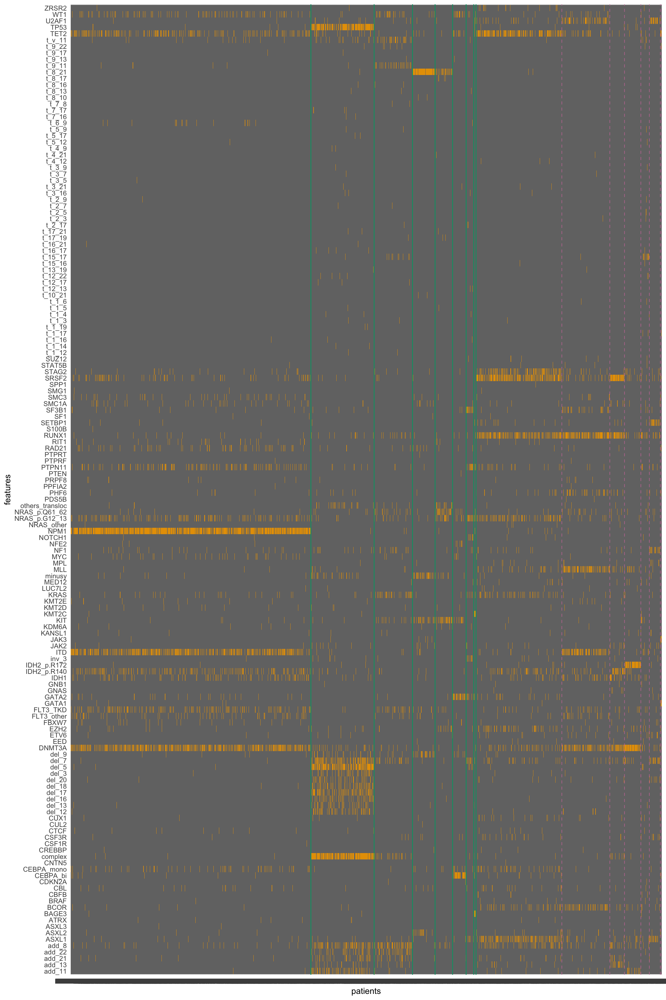

In [9]:
options(repr.plot.res = 200)
set_notebook_plot_size(12, 18)
col_sep <- tabulate(df_all_components$predicted_component)   ## to separate by component
# plot the heatmap
ggplot(melt.data_all, aes(variable,features)) +
geom_raster(aes(fill = factor(value)), show.legend = FALSE) +
scale_fill_manual(values = c("0" = "grey45", "1" = "#e79f00")) +
geom_vline(xintercept = cumsum(col_sep)[1:8] + 0.5, col = "#009E73", linetype = 1, size = 0.5) +
geom_vline(xintercept = cumsum(col_sep)[9:15] + 0.5, col = "#CC79A7", linetype = 2, size = 0.3) +
labs(x = 'patients') 

##### This allows us to find the component that Elli wanted :SF3BP1 and inv3

# II-Clinical correlates whole cohort

# II.1 - Prepare dataframe with correlates

In [10]:
df_w_correlates <- merge(df_initial[correlates],df_all_components['predicted_component'],by=0)
rownames(df_w_correlates) <- df_w_correlates$Row.names
df_w_correlates <- df_w_correlates [,-1]

# II.2 - Clinical correlates for categorical variables

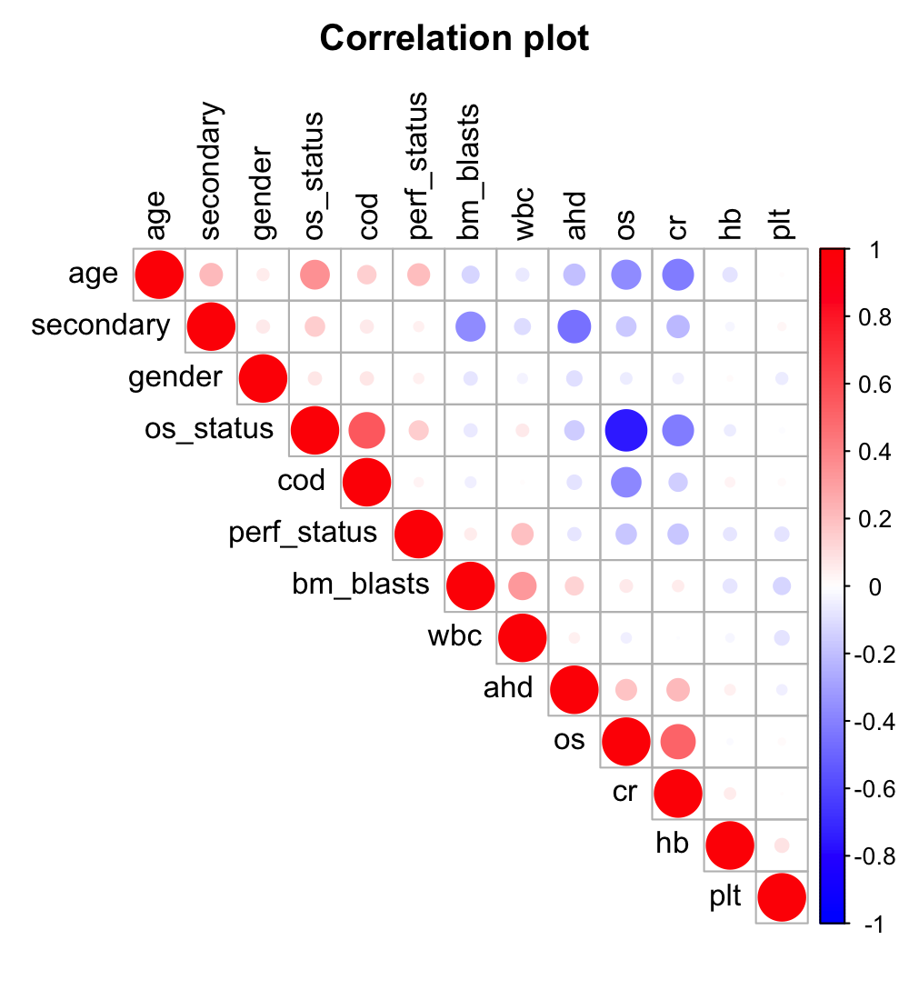

In [11]:
set_notebook_plot_size(5,5.5)
corrplot(rcorr(as.matrix(df_w_correlates[,!names(df_w_correlates) %in% "predicted_component"]))$r,type="upper", order = "hclust", 
         tl.col = "black",col=colorRampPalette(c("blue","white","red"))(200),mar=c(0,0,2,0),title="Correlation plot")

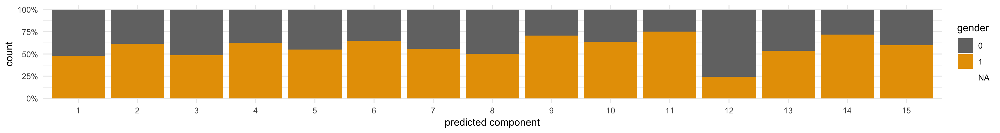

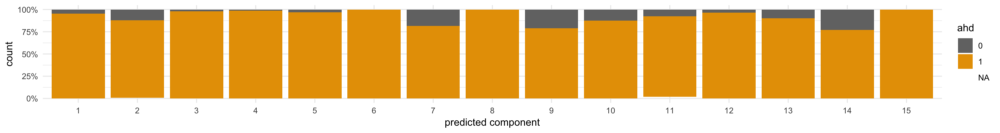

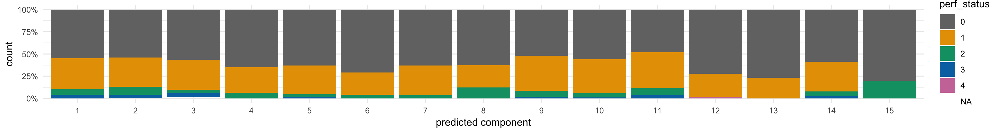

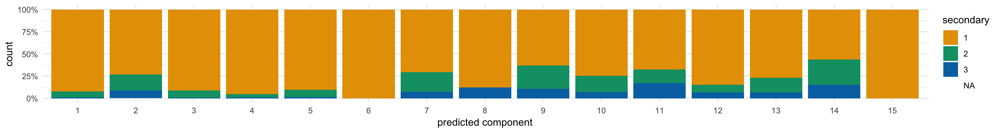

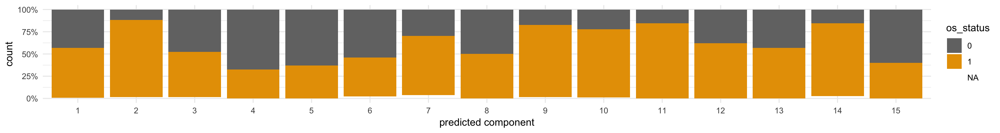

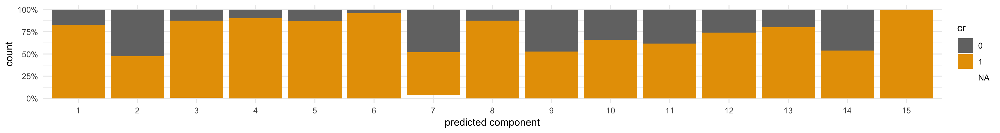

In [12]:
set_notebook_plot_size(15,2)
v=c("0" = "grey45", "1" = "#e79f00", "2" = "#009E73", "3" ="#0072B2", "4"="#CC79A7")
for (col in binary_correlates){
p <- ggplot(df_w_correlates, aes(factor(predicted_component), fill = factor(df_w_correlates[,col]))) +
  geom_bar(position = "fill") +
  scale_y_continuous(labels = scales::percent)+
  xlab("predicted component")+scale_fill_manual(values = v)+
  labs(fill=col)
    plot(p)
}

# II.3 - Clinical correlates for continuous variables

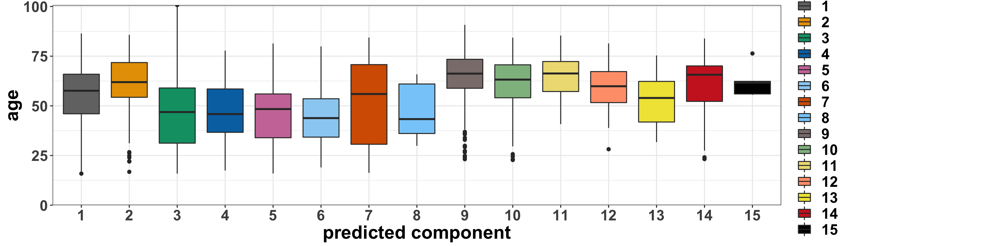

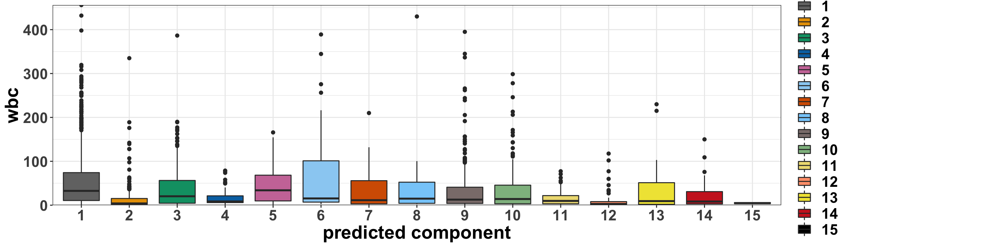

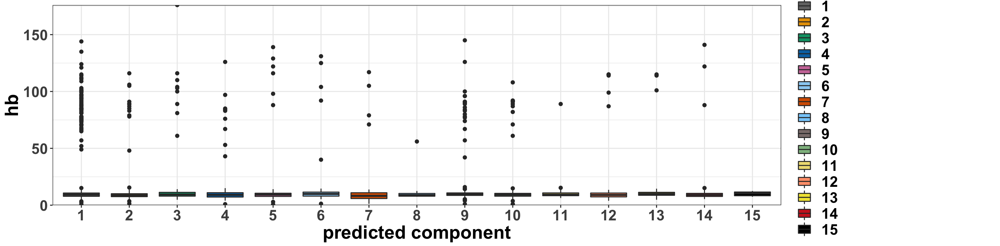

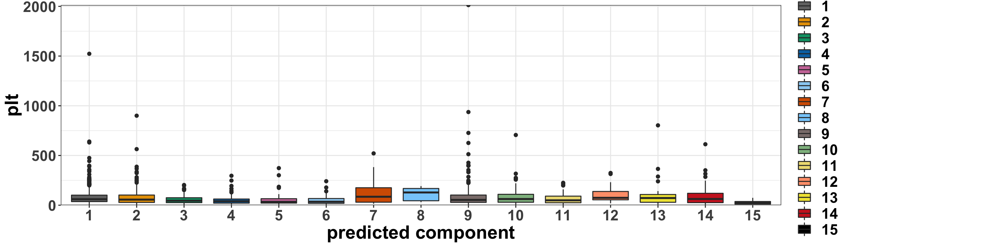

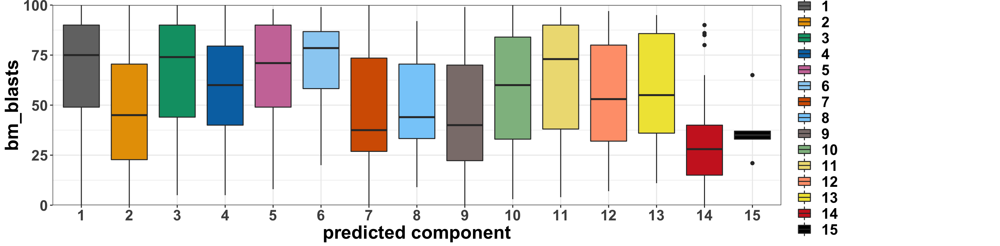

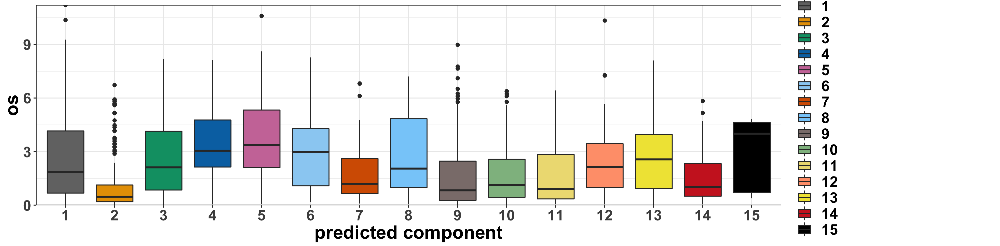

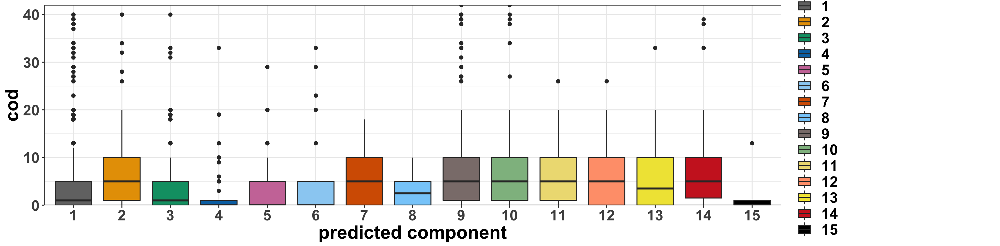

In [13]:
set_notebook_plot_size(15,3.7)
for (col in continuous_correlates){
    p <- ggplot(df_w_correlates,aes(x=factor(predicted_component),y=df_w_correlates[,col],fill=predicted_component)) +
    geom_boxplot(aes(fill = factor(predicted_component))) + 
    theme1+scale_fill_manual(values=c("grey45", "#e79f00", "#009E73","#0072B2",  "#CC79A7",
                                      "#9ad0f3", "#D55E00","lightskyblue","mistyrose4", "darkseagreen","lightgoldenrod","lightsalmon","#F0E442","firebrick3","#000000"))+
    ylab(col)+xlab("predicted component")+scale_y_continuous(limits = c(0, NA), expand = c(0,0)) # set ymin to 0 (Elli's request)
    suppressWarnings(plot(p))
    
}

In [14]:
surv_object <- Surv(time = df_w_correlates$os, event = df_w_correlates$os_status)


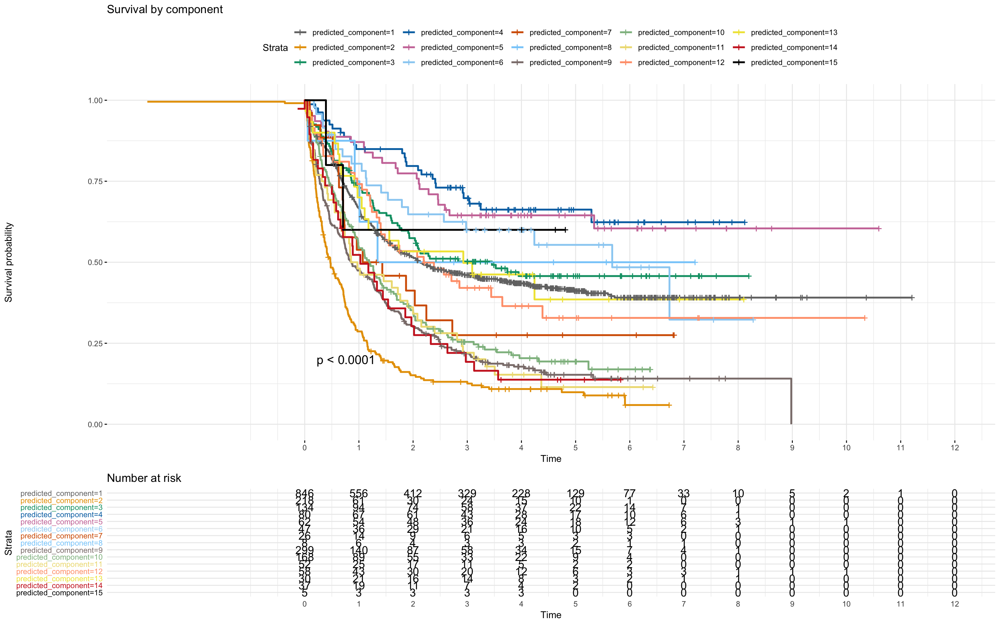

In [15]:

set_notebook_plot_size(16,10)
fit1 <- survfit(surv_object ~ predicted_component, data = df_w_correlates)

ggsurvplot(fit1, data = df_w_correlates, pval = TRUE,risk.table = TRUE,ggtheme = theme_minimal(),
 risk.table.y.text.col = T,
  risk.table.y.text = T,break.time.by = 1,title= "Survival by component",palette=c("grey45", "#e79f00", "#009E73","#0072B2",  "#CC79A7",
                                      "#9ad0f3", "#D55E00","lightskyblue","mistyrose4", "darkseagreen","lightgoldenrod","lightsalmon","#F0E442","firebrick3","#000000"))


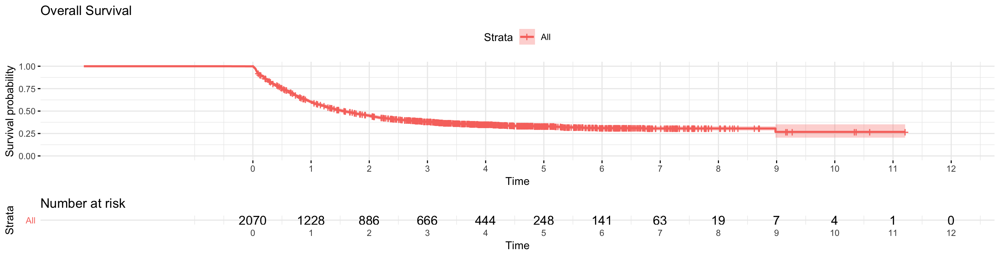

In [16]:
set_notebook_plot_size(14,3.6)
fit_all <- survfit(surv_object ~1, data = df_w_correlates)
ggsurvplot(fit_all, data = df_w_correlates, risk.table = TRUE,ggtheme = theme_minimal(),
 risk.table.y.text.col = T,
  risk.table.y.text = T,break.time.by = 1,title="Overall Survival")



## II.4- Clinical categorical correlates for each component VS others

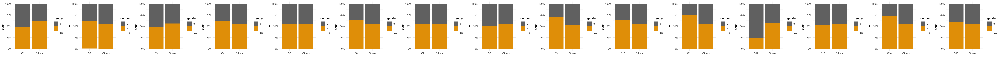

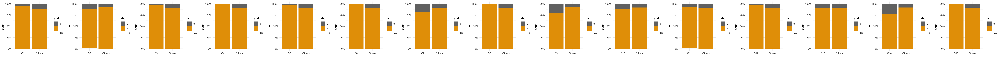

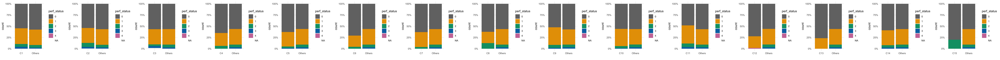

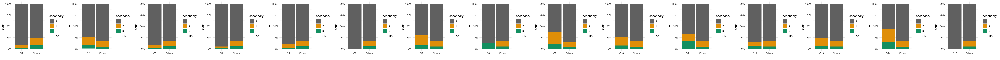

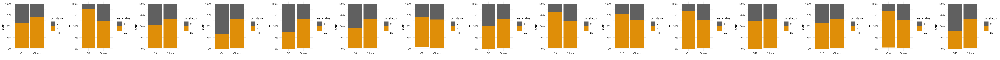

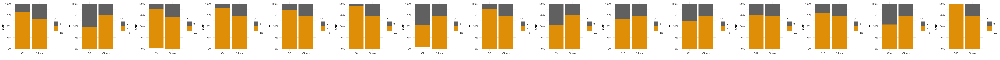

In [17]:
set_notebook_plot_size(50,3)
tmp <-df_w_correlates
categlist <- list()
for (col in binary_correlates){
    for (i in 1:15){
    tmp$comparison <- ifelse((tmp$predicted_component==i),sprintf("C%d",i),"Others") 
    categlist[[i]]<- ggplot(tmp, aes(factor(comparison), fill = factor(tmp[,col]))) + 
                geom_bar(position = "fill") +scale_y_continuous(labels = scales::percent)+labs(x="",fill=col)+
                scale_fill_manual(values = val) 

    }
    grid.arrange(grobs=categlist,ncol=15)
}

# II.5 Clinical continuous correlates for each component VS others

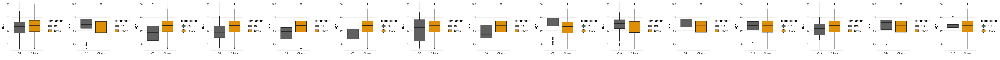

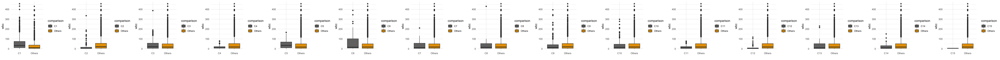

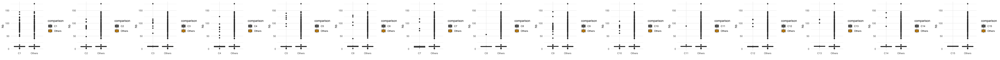

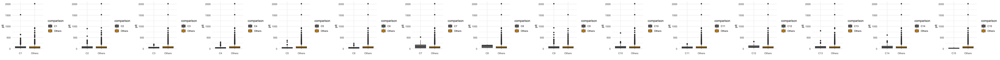

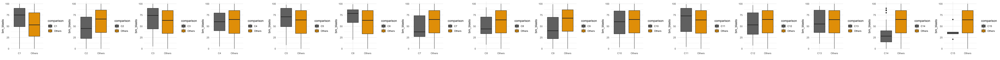

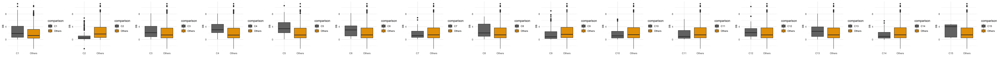

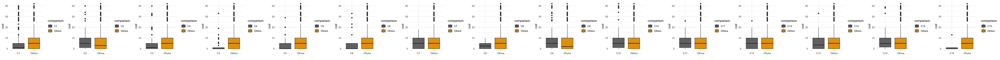

In [18]:
set_notebook_plot_size(50,3)
categlist <- list()
contlist <- list()
for (col in continuous_correlates){
    for (i in 1:15){
    tmp$comparison <- ifelse((tmp$predicted_component==i),sprintf("C%d",i),"Others") 
    contlist[[i]]<- ggplot(tmp,aes(x=factor(comparison),y=tmp[,col],fill=comparison)) +
                geom_boxplot(aes(fill = factor(comparison))) +  ylab(col)+xlab("")+scale_fill_manual(values=c("grey45","#e79f00")) 

    }
    suppressWarnings(grid.arrange(grobs=contlist,ncol=15))
}

## II.6- Survival Plot for each component VS others

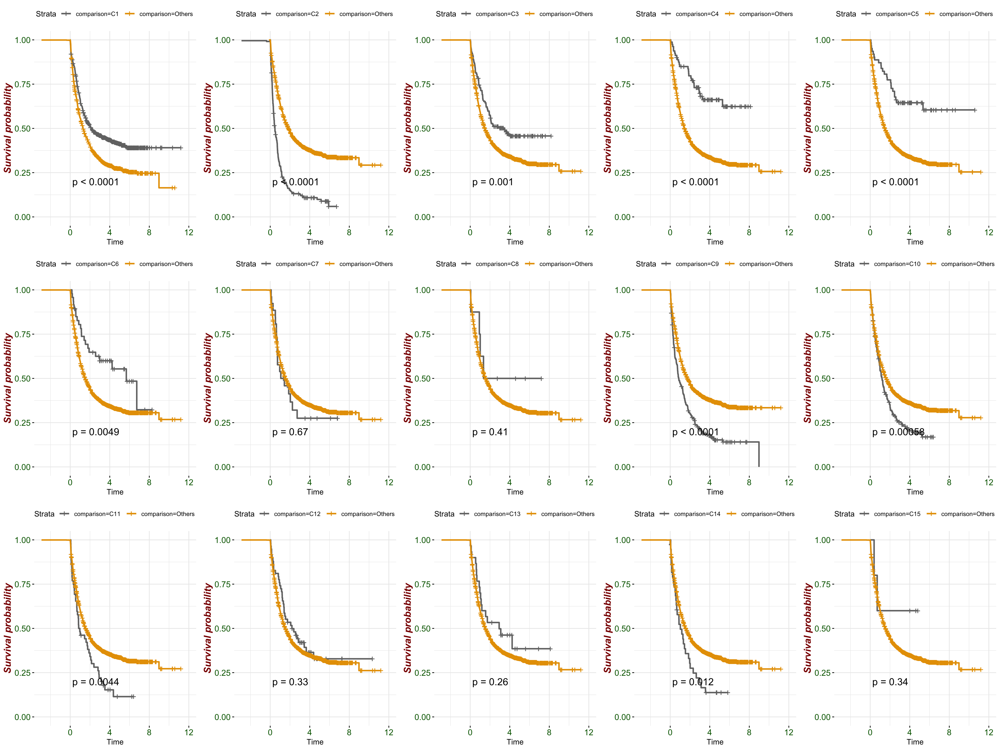

In [19]:
set_notebook_plot_size(20,15)
#par(mfrow = c(5,3))
survlist <- list()
for (i in 1:15){
tmp$comparison <- ifelse((tmp$predicted_component==i),sprintf("C%d",i),"Others") 
surv_object <- Surv(time = tmp$os, event = tmp$os_status)
fit <- survfit(surv_object ~ comparison, data = tmp)
survlist[[i]]<-ggsurvplot(fit, data = tmp, pval = TRUE,ggtheme = theme_minimal(),main = "Survival curve",
   font.main = c(16, "bold", "darkblue"),
   font.y = c(14, "bold.italic", "darkred"),  
   palette = c("grey45","#e79f00"),
   font.tickslab = c(12, "plain", "darkgreen"))$plot
}
grid.arrange(grobs=survlist,ncol=5)

# II.7- Genetical and cytogenetical frequency within components

In [109]:
tmp_cat <- as.data.frame(sapply(df_all_components, as.numeric))
categories_repartition <- data.frame(category = colnames(tmp_cat))
#/nrow(tmp_cat[tmp_cat$predicted_component ==i,]
for (i in 1:15)
    categories_repartition[sprintf('component_%d', i)] <- apply(categories_repartition, 1, function(s) (sum(tmp_cat[tmp_cat$predicted_component == i, s['category']])/nrow(tmp_cat[tmp_cat$predicted_component ==i,])))
categories_repartition <- categories_repartition[! categories_repartition$category == "predicted_component",]
#categories_repartition['total_count'] <- rowSums(categories_repartition[,-1])
#categories_repartition <- categories_repartition[order(categories_repartition$total_count, decreasing = TRUE),]
head(categories_repartition)


category,component_1,component_2,component_3,component_4,component_5,component_6,component_7,component_8,component_9,component_10,component_11,component_12,component_13,component_14,component_15
inv_3,0.001175088,0.022321429,0.007352941,0.0000,0.00000000,0.0000,0.2962963,0.125,0.013157895,0.00000000,0.01923077,0.00000000,0.00000000,0.02564103,0.0
ASXL1,0.010575793,0.022321429,0.029411765,0.0250,0.01612903,0.0625,0.1851852,0.000,0.345394737,0.05882353,0.05769231,0.12068966,0.10000000,0.33333333,0.0
ASXL2,0.004700353,0.000000000,0.000000000,0.1875,0.00000000,0.0000,0.0000000,0.125,0.026315789,0.03529412,0.01923077,0.01724138,0.03333333,0.02564103,0.2
ASXL3,0.002350176,0.000000000,0.000000000,0.0000,0.00000000,0.0000,0.0000000,0.000,0.000000000,0.00000000,0.00000000,0.00000000,0.00000000,0.00000000,0.0
ATRX,0.005875441,0.008928571,0.000000000,0.0000,0.00000000,0.0000,0.0000000,0.000,0.009868421,0.00000000,0.00000000,0.00000000,0.00000000,0.00000000,0.0
BAGE3,0.001175088,0.004464286,0.000000000,0.0000,0.00000000,0.0000,0.0000000,1.000,0.000000000,0.00000000,0.00000000,0.00000000,0.03333333,0.00000000,0.0


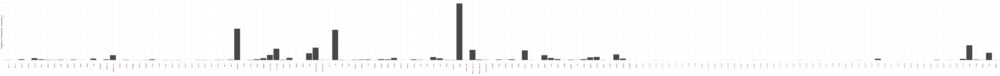

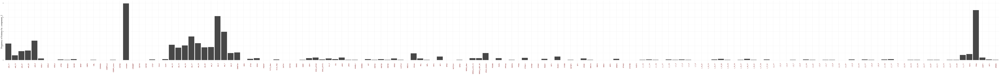

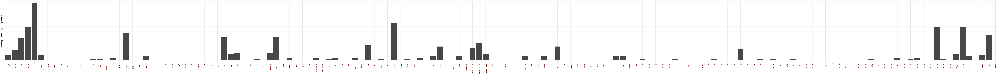

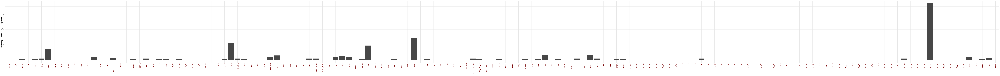

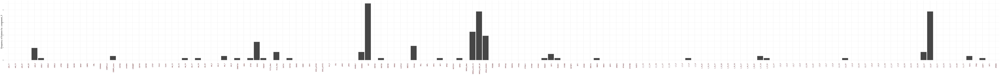

...

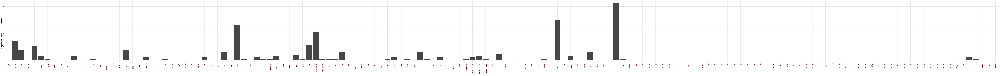

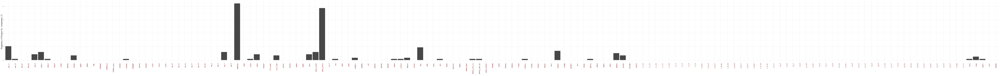

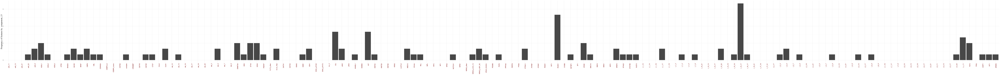

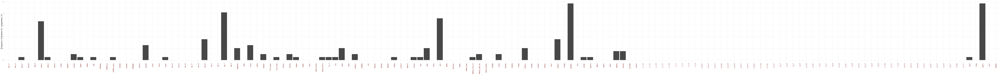

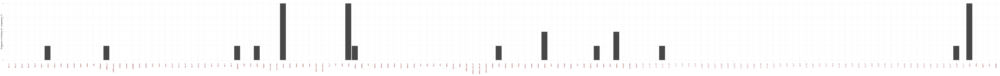

In [110]:
set_notebook_plot_size(130,10)
i <-1
for (col in colnames(categories_repartition)[-1]){
    plot(ggplot(categories_repartition,aes(factor(category),y=categories_repartition[,col]))+geom_bar(stat='identity')+xlab("")+scale_fill_manual(values="#e79f00")
     +ylab(paste("Frequency of features by ",col))+theme(axis.text.x = element_text(angle = 90, hjust = 1, size=13,color="darkred"))
     +theme(axis.title.y = element_text(family="serif", size = 20, angle = 90, vjust = 0.25)))
    i <-i+1
    }


# Takeaways of the analysis:

### Elli's request for NRAS decomposition by codons:
##### It seems that combination of mutations in codon 12-13 with NPM1 has a significant positive impact on survival

##### They concluded : Patients with NRASmutant had no significant improved clinical outcome than patients without mutation
##### But they do not have a lot of patients (39)
##### In our cohort, not only the results are significant but also , the number of patients is high :90 with NPM1 and NRAS mutation in codon 12-13

### [<font color=green>Prognostic Significance of NRAS Gene Mutations in Children with Acute Myelogenous Leukemia</font>](https://www.ncbi.nlm.nih.gov/pmc/articles/PMC3248332/)

----
###  [For Component 1](#comp1):
##### We have identified that __NPM1__ mutation has a significantly positive impact on survival outcome compared to people without __NPM1__ in component 1 and all others without __NPM1__.
##### However, for people not in component 1 the survival outcome with __NPM1__ is bad (but not significant since only 14 samples for people not in C1 with __NPM1__ whereas almost 700 for component 1 with __NPM1__)



### [<font color=green>Article in NCBI for favorable prognostic in AML for patients with NPM1</font>](https://www.ncbi.nlm.nih.gov/pmc/articles/PMC3917771/)
---


----
###  [For Component 2](#comp2):
##### Combination of __TP53__ and __complex__ has a negative impact on survival outcome . 
##### __TP53__ without __complex__ seems to be the main driver for the negative impact because it still has a negative impact on survival outcome whereas
##### __complex__ without __TP53__ seems to follow the overall survival curve.


###  [Confirmation of conclusion of component 2 with component 3 for TP53 and complex](#comp2-3):
##### Whereas __complex__ only performs slightly better than overall for component 3 , the combination of __complex__ and __TP53__ of component 2 has a significant negative impact on survival.
##### Regarding clinical correlates, the comparison shows that complete remission is very high for component 3 with __complex__ whereas very low for component 2 with __complex__ and __TP53__.

###  [All components conclusion for TP53 and complex](#tp53_comp):
##### As expected, when we look at over all components, we have a significant negative effect of __complex__ combined with __TP53__ followed very closely by __TP53__ only. 
##### __Complex__ only have no effect on survival outcome since it follows the overall survival curve.

### [<font color=green>Article from the blood journal with same survival conlusion for TP53 and complex</font>](http://www.bloodjournal.org/content/124/21/532)

----
----
###  [For Component 3](#comp3):
##### It seems that translocations __t_v_11__ and __t_9_11__ performs similarly for survival outcomes with a slightly positive effect. 
##### For translocation __t_15_17__, it seems to have as well a positive impact on the overall survival.
##### Regarding overlaps, there is only one patient with __t_v_11__ and __t_9_11__ so we can not draw conclusions.

---
---


###  [For Component 4](#comp4minusy):
#### [Component 4 minusy with translocation(8,21) ](#comp4minusy):
##### The survival when __minusy__ is 0 and with __translocation(8,21)__ is slightly better than the survival when __minusy__ is 1 with this __translocation(8,21)__.
##### Overall, whatever the outcome of __minusy__ , the survival is positively impacted by __translocation(8,21)__.  
#### [Component 4 KIT with translocation(8,21) ](#comp4KIT):
##### __Translocation(8,21)__ combined with mutation __KIT__ performs less well than __translocation(8,21)__ without this mutation. Overall, the survival curves for both have still a positive impact on survival.
##### This means that __translocation(8,21)__ has a dominant positive effect over mutation __KIT__.

###  [Confirmation of conclusion of component 4 with component 5](#comp4-5):
##### Again, we can see that __translocation(8,21)__ has a clear positive impact on survival outcome . The combination with the mutation __KIT__ tends to shrink slightly this positive impact
##### and it is still true that the __translocation(8,21)__ is dominant over __KIT__ mutation.

###  [All component KIT and t(8,21)](#t_8_21):
##### This concludes our previous remarks: __translocation(8,21)__ significantly increases the overall survival . When combined with __KIT__ mutation , the survival tends to go down but the effect of 
##### this __translocation(8,21)__ is still widely dominating 

### [<font color=green>Article from nature: KIT mutation brings t(8;21) AML from low to intermediate risk</font>](https://www.nature.com/articles/s41408-018-0116-1)
---

---
---
###  [For Component 5](#comp5):
##### __NRAS__ seems to have a similar impact as __KIT__ when combined with the __translocation(8,21)__. Indeed, the combination seems to reduce the survival but the __translocation(8,21)__
##### impact is dominating so the overall impact is positive.


###  [All component NRAS and t(8,21)](#NRAS):
##### Same conclusion as mutation __KIT__:  __translocation(8,21)__ significantly increases the overall survival . When combined with __NRAS__ mutation , the survival tends to go down but the effect of 
##### this __translocation(8,21)__ is still widely dominating 

### [<font color=green>Blood Journal: Detection of RAS, KIT and FLT3 Gene Mutations in t(8;21)-Positive Acute Myeloid Leukemia (AML): Evaluation of the Clinical Relevance.</font>](http://www.bloodjournal.org/content/108/11/2301?sso-checked=true&utm_source=TrendMD&utm_medium=cpc&utm_campaign=Blood_TrendMD_0)
##### This article was able to detect that additional genetic lesions have an impact on the prognosis : __RAS__, __KIT__ and __FLT3__. 
##### I think we have new findings in our cohort because the article detect negative prognosis impact with __FLT3__ and __KIT__ but not __NRAS__.
---


---
###  [For Component 6](#comp6):
##### The mutations __GATA2__ and __CEBPAbi__ seems to have a positive impact on survival . When combined, the effect of those mutations is slightly reduced.

### [<font color=green>Blood Journal : Clinical Impact of GATA2 Mutations in AML Patients Harboring CEBPA Mutations:</font>](http://www.bloodjournal.org/content/122/21/1332?sso-checked=true)
#### Conclusion of the article : 
##### "In our study on a large cohort of CEBPA mutated AML pts we could confirm the high coincidence of GATA2 mutations, in particular in the subgroup of pts with CEBPA double mutations. However, GATA2 mutations had no impact on clinical outcome neither in the whole cohort nor in distinct pt subgroups."

#### In our study, we have found that the effect of GATA2 mutations on CEBPA mutated slightly reduce the OS .

---
---
###  [For Component 7](#comp7):
#### [SF3B1,inv3 and del7](#comp7):
##### All together, they seem to have a negative impact on the survival when combined. However, the results are not significant to draw conclusions since the number of patients with those 3 mutations is very low(3 patients).
#### [SF3B1,inv3](#comp7_bis):
##### They both have a negative impact on the OS. When we look at the combination of mutations of __SF3B1__ and __inv3__, we can deduce that the dominant negative effect comes from the __inv3__ .

### [All components SF3B1 and inv3](#inv3_sf3b1)
##### The survival plot validates our findings: __SF3B1__ and __inv3__ both have a negative impact on the survival. __Inv3__ have a more significant negative impact overall.

### [<font color=green>NCBI: Acute myeloid leukemia with inv(3)</font>](https://www.ncbi.nlm.nih.gov/pubmed/25680074)
##### Conclusions of article :"Although not yet recognized by the World Health Organization classification, 
##### our results are in agreement with the findings of other authors, who include __both subsets of AML together in the same group of adverse prognosis__."


---
---
###  [For Component 8](#comp8):
##### __BAGE3__ and __KMT2C__ are mutated together all the time in the whole cohort
---
---
---

###  [For New Component 1 and 2 ](#nc1-2):
##### We have compared new component 1 with __SRSF2__,__RUNX1__ and __STAG2__ mutations combined VS new component 1 for others VS new component 2 with __U2AF1__ and __MLL__
##### combined VS others from component 2 VS all others. Thanks to those comparisons, the results are significant and show demonstrate that the new component 2 with __U2AF1__ 
##### and __MLL__ has the worse negative impact on  the survival followed by the new component 1 with __SRSF2__,__RUNX1__ and __STAG2__ mutations followed by others in new component 1 and 2.
---
---
---

###  [For New Component 2 ](#nc2):
##### With high confidence , we can say that the survival of people with __DNMT3A__ and __ITD__ in the new component 2 is far worse then for other people with those mutations .
##### Also, it is far worse than other people in the new component 2 without those 2 mutations. 
##### This , leads us to ask another questions: what other mutations might be responsible for this poor prognosis when __DNMT3A__ and __ITD__ are mutated?


### [Investigation](#investigation):
##### To investigate this, we need to find the intersection between the features that have a high frequency in the new component 2 when __DNMT3A__ and __ITD__ are mutated 
##### but a low frequency in other components when __DNMT3A__ and __ITD__ are mutated.
##### The analysis shows that those features are those 2 mutated genes: __MLL__ and __RUNX1__ . Indeed, we can see that in new component 2 , those 2 mutations have a very high frequency,
##### whereas for other components, their frequencies are very low.
##### All together with the survival plot, it shows that the combination of those 4 mutations considerably reduce the survival.

### [<font color=green>NCBI: MLL and DNMT3A mutations are associated with poor prognosis</font>](https://www.ncbi.nlm.nih.gov/pmc/articles/PMC4741760/)
##### This article partially explain our findings associating MLL and DNMT3A with poor diagnosis.
---


---
### [Comparison new component 1 and new component 3](#nc1-3):
##### The new component 3 with __SRSF2__ mutation have a better survival outcome than new component 1 with __SRSF2__ mutation
---


---
### [For New Component 4](#nc4):
##### Mutation __IDH2__ tends to delay the death of patients that have the __DNMT3A__ mutation which is known as a bad mutation for survival prognosis. 

### [<font color=green>Nature: DNMT3A and IDH mutations in acute myeloid leukemia : association with prognosis</font>](https://www.nature.com/articles/leu2014124)
#### The conclusions from the article: "Most studies have shown a negative impact on outcomes such as CR rates, relapse rates, event-free survival, relapse-free survival and OS. However, not all studies have demonstrated a negative impact on clinical outcomes, perhaps due to different baseline characteristics or treatment courses"
---
---

### [For New component 5](#nc5):
##### __Translocation(15,17)__ significantly increase overall survival within the different components. 

### [<font color=green>prognosis in APL (90 % of the time relative to t(15,17))</font>](https://www.nature.com/articles/bcj201525)
##### Conclusions "APL has been transformed from the most fatal to the most curable form of acute leukemia in adults"


---
---
---
### [For New component 6](#nc6):
##### Mutations __U2AF1__ combined with __SETBP1__ are the worst combination for new component 6 and obviously performs worse than overall survival.
##### After that, there are mutations __U2AF1__ combined with __NF1__ that also performs worse than overall survival.
##### This leads to the next investigation: how does mutation __U2AF1__ performs for all the components and not just new component 6?

### [Investigation U2AF1](#u2af1):
##### As previously guessed, the mutation __U2AF1__ for the whole dataset and not only for new component 6 significantly decreases the survival.

### [<font color=green>U2AF1 mutations</font>](https://www.ncbi.nlm.nih.gov/pubmed/23029227)
##### Conclusions: "The overall survival (OS) of AML patients with U2AF1 mutation (median 3 months) was shorter than those without mutation (median 7 months) (P = 0.035)".

### [For New component 7](#nc7):
##### It seems that when __GATA1__ and __JAK3__ are mutated together, the survival is very low. However , a single mutation of __GATA1__ or __JAK3__ does not have this effect on the survival. 
##### Please be careful, that the number of patients for this conclusion is very low...

# III- Analysis by component

## Elli's request to check NPM1 and NRAS (12-13,61-62)  , t(8,21) and NRAS  (12-13,61-62) 

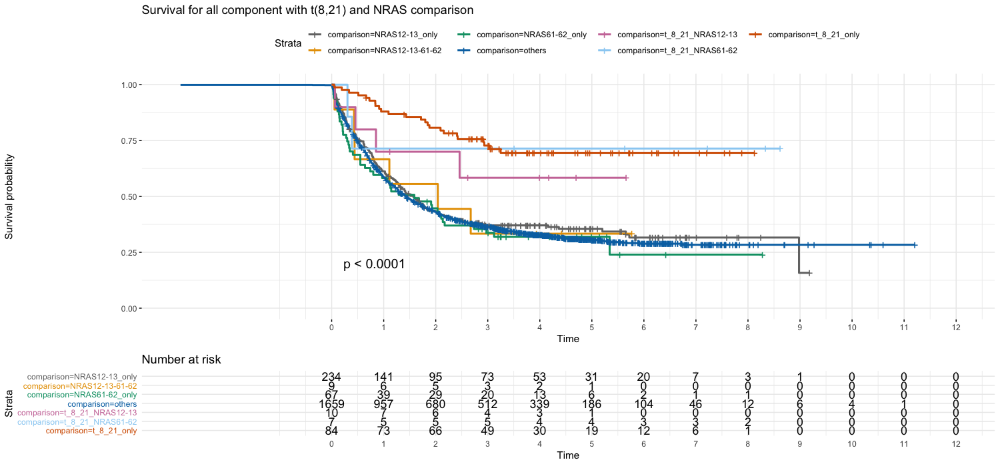

In [111]:
tmp <- merge(df_w_correlates,df_initial[c("NPM1","t_8_21","NRAS_p.G12_13","NRAS_p.Q61_62")],by=0)
rownames(tmp) <- tmp$Row.names
tmp <- tmp [,-1]
tmp$comparison <- ifelse((tmp$t_8_21==1) & (tmp$NRAS_p.Q61_62==1 & tmp$NRAS_p.G12_13==1), "t_8_21_NRAS12-13-61-62", 
                  ifelse((tmp$t_8_21==1) & (tmp$NRAS_p.Q61_62==0) & (tmp$NRAS_p.G12_13==1), "t_8_21_NRAS12-13",
                  ifelse((tmp$t_8_21==1) & (tmp$NRAS_p.Q61_62==1) & (tmp$NRAS_p.G12_13==0), "t_8_21_NRAS61-62" ,  
                  ifelse((tmp$NRAS_p.Q61_62==1 & tmp$NRAS_p.G12_13==1),"NRAS12-13-61-62",
                  ifelse((tmp$NRAS_p.Q61_62==0 & tmp$NRAS_p.G12_13==1),"NRAS12-13_only",
                  ifelse((tmp$NRAS_p.Q61_62==1 & tmp$NRAS_p.G12_13==0),"NRAS61-62_only",   
                  ifelse( (tmp$t_8_21==1) &(tmp$NRAS_p.Q61_62==0) & (tmp$NRAS_p.G12_13==0), "t_8_21_only",
                     "others")))))))
plot_surv(tmp,"Survival for all component with t(8,21) and NRAS comparison",15,7)

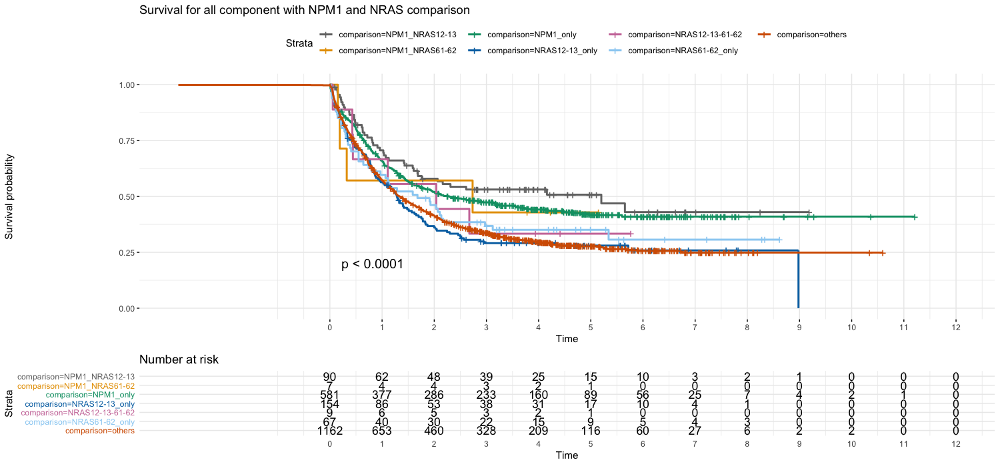

In [112]:
tmp <- merge(df_w_correlates,df_initial[c("NPM1","t_8_21","NRAS_p.G12_13","NRAS_p.Q61_62")],by=0)
rownames(tmp) <- tmp$Row.names
tmp <- tmp [,-1]
tmp$comparison <- ifelse((tmp$NPM1==1) & (tmp$NRAS_p.Q61_62==1 & tmp$NRAS_p.G12_13==1), "NPM1_NRAS12-13-61-62", 
                  ifelse((tmp$NPM1==1) & (tmp$NRAS_p.Q61_62==0) & (tmp$NRAS_p.G12_13==1), "NPM1_NRAS12-13",
                  ifelse((tmp$NPM1==1) & (tmp$NRAS_p.Q61_62==1) & (tmp$NRAS_p.G12_13==0), "NPM1_NRAS61-62" ,  
                  ifelse((tmp$NRAS_p.Q61_62==1 & tmp$NRAS_p.G12_13==1),"NRAS12-13-61-62",
                  ifelse((tmp$NRAS_p.Q61_62==0 & tmp$NRAS_p.G12_13==1),"NRAS12-13_only",
                  ifelse((tmp$NRAS_p.Q61_62==1 & tmp$NRAS_p.G12_13==0),"NRAS61-62_only",   
                  ifelse( (tmp$NPM1==1) &(tmp$NRAS_p.Q61_62==0) & (tmp$NRAS_p.G12_13==0), "NPM1_only",
                     "others")))))))
plot_surv(tmp,"Survival for all component with NPM1 and NRAS comparison",15,7)

# Component 1

#### For component 1, the predominant feature is NMP1. Therefore , we will investigated the clinical correlates with and without this mutation.

In [23]:
df_c_1 <- merge(df_w_correlates,df_initial["NPM1"],by=0)
rownames(df_c_1) <- df_c_1$Row.names
df_c_1 <- df_c_1 [,-1]

[1] "Count : C1_NPM1 : 668"
[1] "Count : others_NPM1 : 14"
[1] "Count : C1_without : 183"
[1] "Count : others_without : 1229"


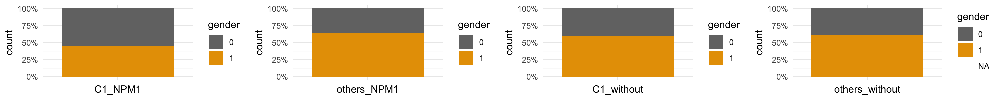

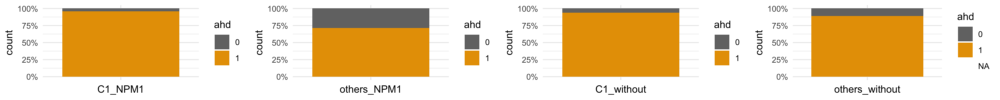

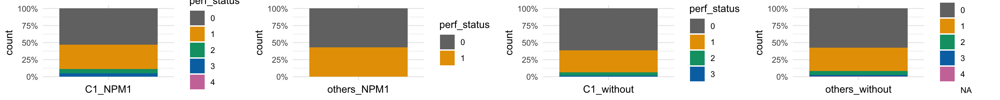

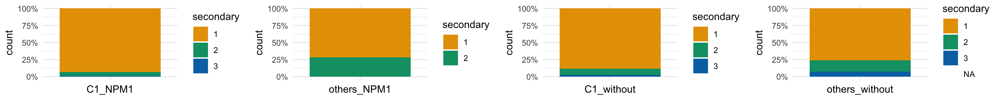

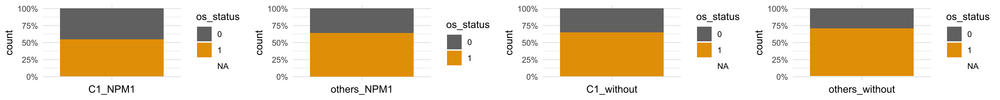

...

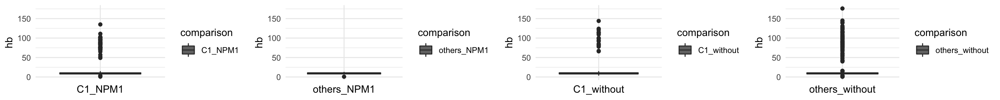

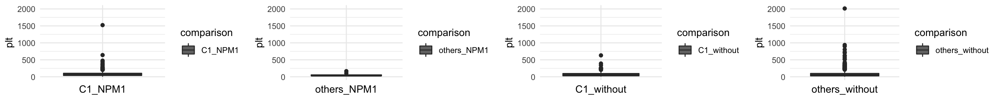

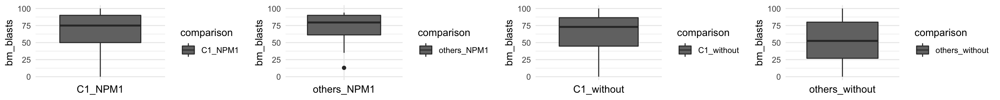

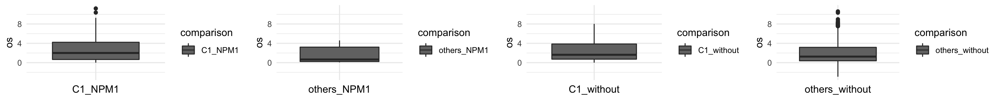

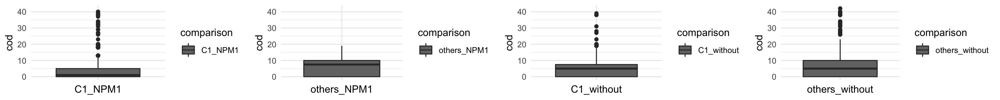

In [24]:
df_c_1$comparison <- ifelse((df_c_1$predicted_component==1)& (df_c_1$NPM1==1), "C1_NPM1", 
                     ifelse((df_c_1$predicted_component==1)& (df_c_1$NPM1==0), "C1_without",
                            ifelse((df_c_1$predicted_component!=1)& (df_c_1$NPM1==1), "others_NPM1","others_without" )))

plottings_comparison(df_c_1[df_c_1$comparison=="C1_NPM1",],df_c_1[df_c_1$comparison=="others_NPM1",],
                     df_c_1[df_c_1$comparison=="C1_without",],df_c_1[df_c_1$comparison=="others_without",],
                     many=4,x1="C1_NPM1",x2="others_NPM1",x3="C1_without",x4="others_without",width=15,height=1.5)

<a id='comp1'></a>


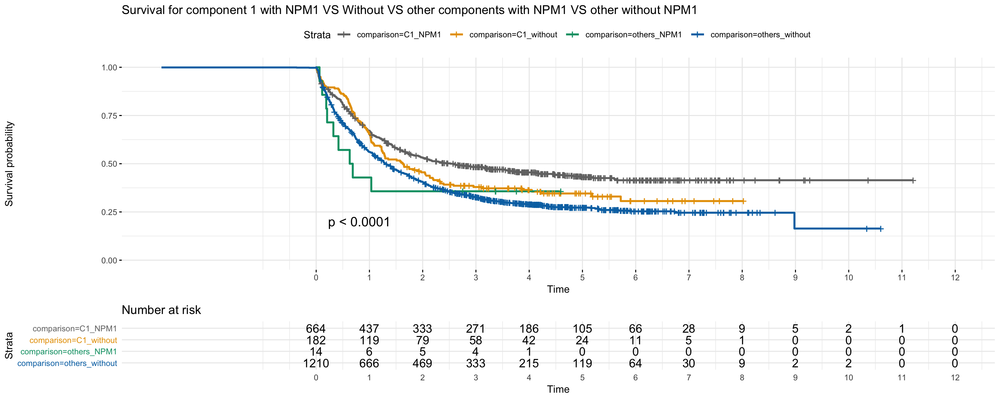

In [25]:
set_notebook_plot_size(15,6)
plot_surv(df_c_1,"Survival for component 1 with NPM1 VS Without VS other components with NPM1 VS other without NPM1")

# Component 2

#### The second component(correspond to component3 because of the new components) focuses on the additions, deletions, complex and TP53.

In [26]:
df_c_2 <- merge(df_w_correlates,df_initial[c("TP53","complex")],by=0)
rownames(df_c_2) <- df_c_2$Row.names
df_c_2 <- df_c_2 [,-1]

[1] "Count : C2_complex_TP53 : 150"
[1] "Count : C2_complex_only : 52"
[1] "Count : C2_TP53_only : 7"
[1] "Count : C2_without_both : 15"


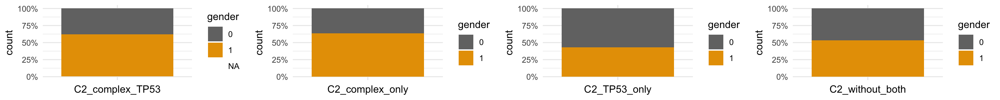

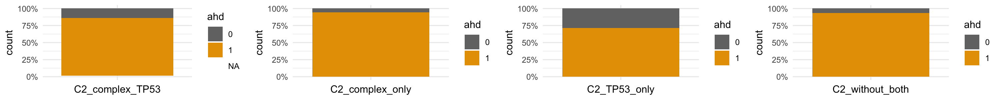

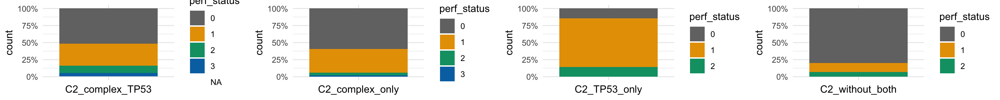

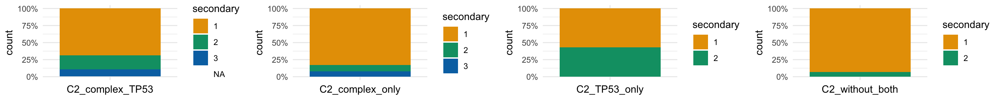

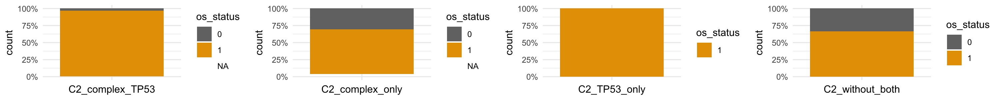

...

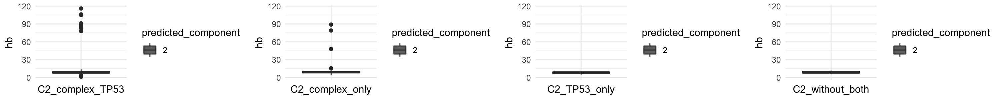

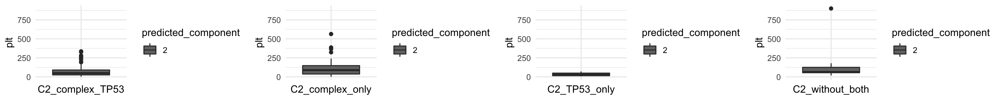

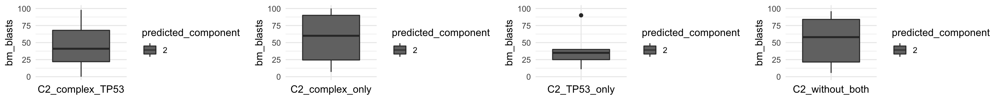

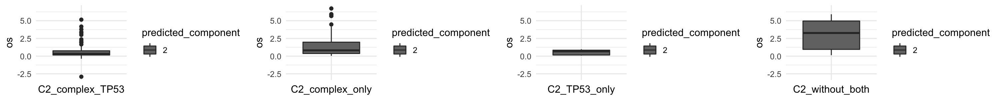

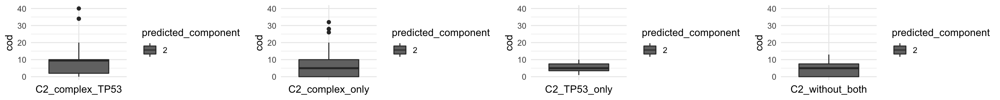

In [27]:
df_c_2$comparison <- ifelse((df_c_2$predicted_component==2)& (df_c_2$complex==1) & (df_c_2$TP53==1), "C2_complex_TP53", 
                     ifelse((df_c_2$predicted_component==2)& (df_c_2$complex==1) & (df_c_2$TP53==0), "C2_complex_only",
                            ifelse((df_c_2$predicted_component==2)& (df_c_2$complex==0) & (df_c_2$TP53==1), "C2_TP53_only",
                                   ifelse((df_c_2$predicted_component==2)& (df_c_2$complex==0) & (df_c_2$TP53==0),"C2_without_both",
                                   "others" ))))

plottings(df_c_2[(df_c_2$predicted_component==2)& (df_c_2$complex==1) & (df_c_2$TP53==1),],
          df_c_2[(df_c_2$predicted_component==2)& (df_c_2$complex==1) & (df_c_2$TP53==0),],
          df_c_2[(df_c_2$predicted_component==2)& (df_c_2$complex==0) & (df_c_2$TP53==1),],
          df_c_2[(df_c_2$predicted_component==2)& (df_c_2$complex==0) & (df_c_2$TP53==0),],
          x1="C2_complex_TP53",x2="C2_complex_only",x3="C2_TP53_only",x4="C2_without_both",many=4,width=15,height=1.5)

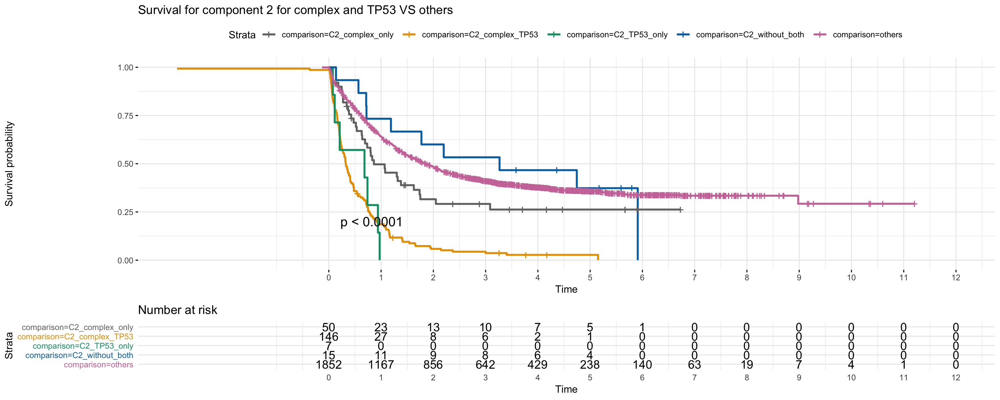

In [28]:
set_notebook_plot_size(15,6)
plot_surv(df_c_2,"Survival for component 2 for complex and TP53 VS others")

<a id='comp2'></a>

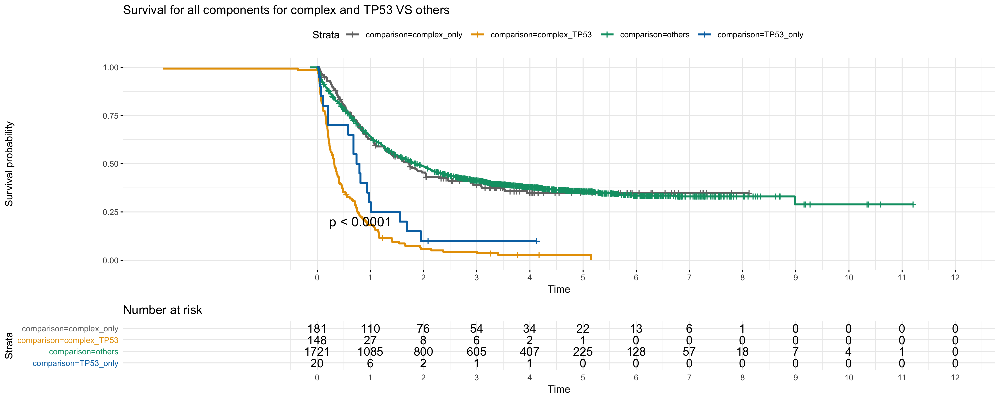

In [29]:
tmp <-df_c_2
tmp$comparison <- ifelse((tmp$complex==1) & (tmp$TP53==1), "complex_TP53", 
                     ifelse( (tmp$complex==1) & (tmp$TP53==0), "complex_only",
                            ifelse((tmp$complex==0) & (tmp$TP53==1), "TP53_only",
                                   "others" )))
set_notebook_plot_size(15,6)
plot_surv(tmp,"Survival for all components for complex and TP53 VS others")

# Component 3

## I- Let's compare when complex is activated in component 2 vs component 3 with TP53 activated for component 2

In [30]:
df_c_3 <- merge(df_w_correlates,df_all_components[c("TP53","complex","t_9_11","t_v_11","t_15_17","add_8")],by=0)
rownames(df_c_3) <- df_c_3$Row.names
df_c_3 <- df_c_3 [,-1]

[1] "Count : C3_complex_only : 22"
[1] "Count : C2_complex_AND_TP53 : 143"


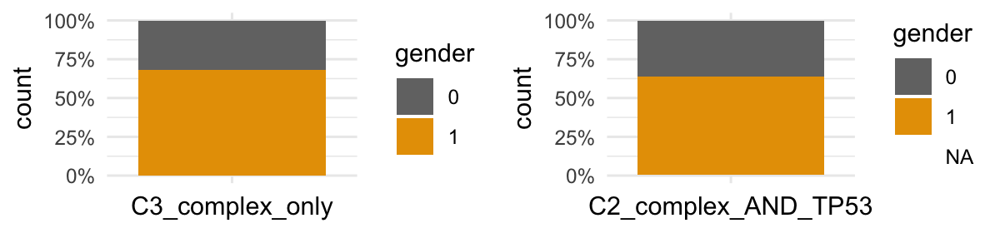

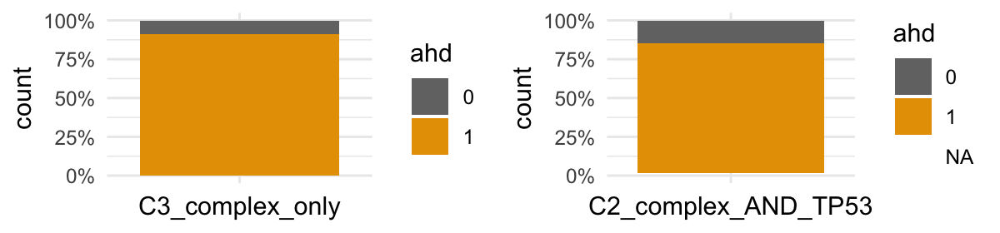

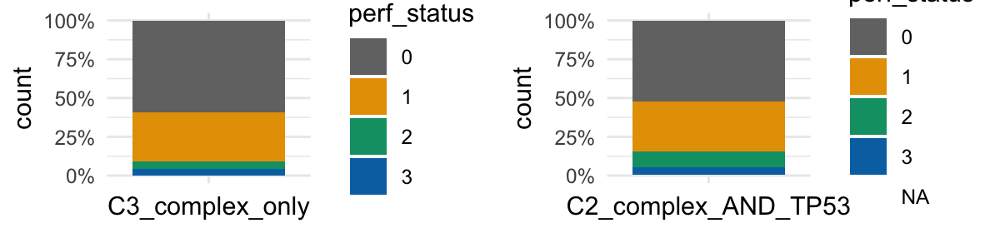

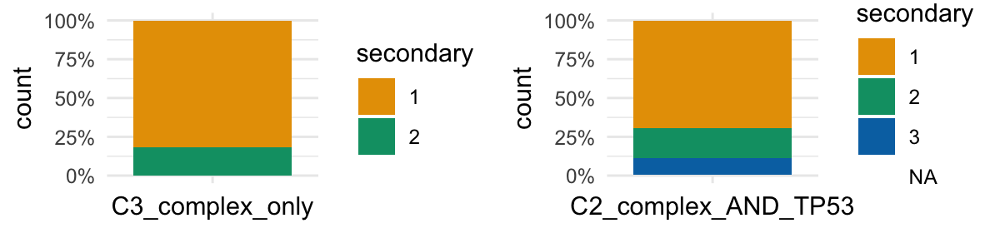

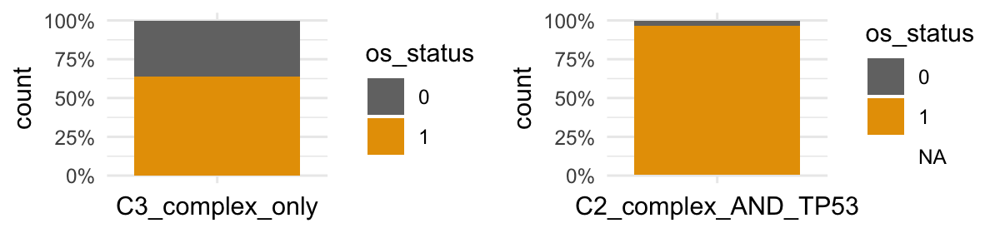

...

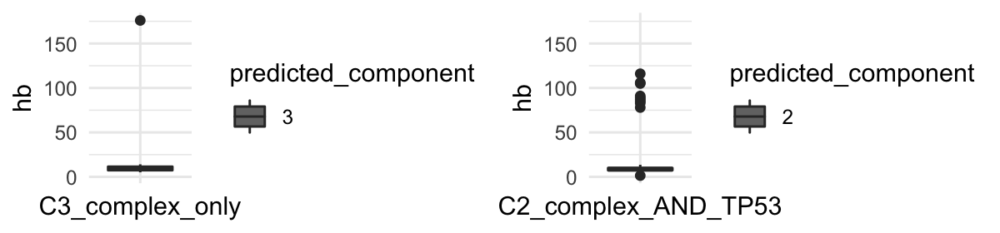

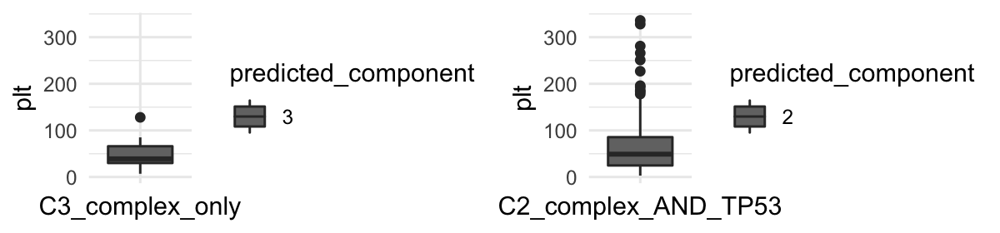

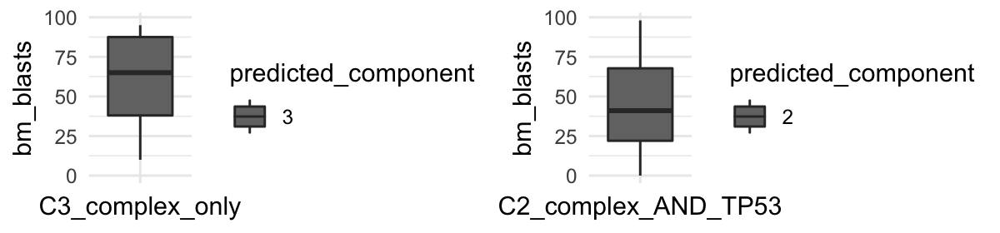

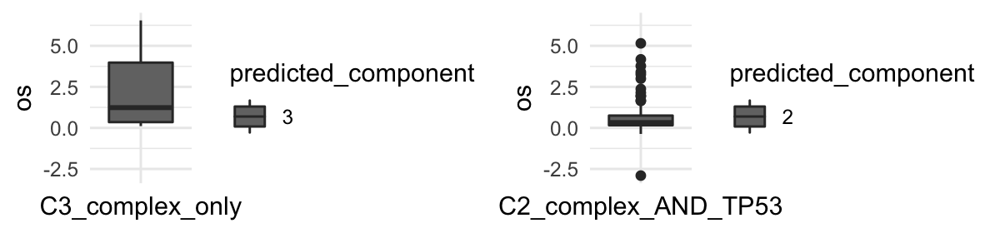

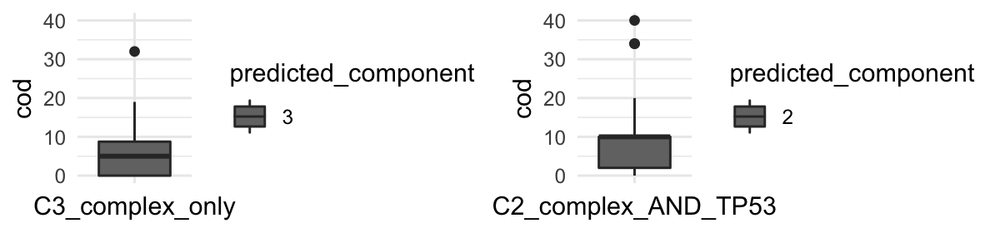

In [31]:
df_c_3$comparison <- ifelse((df_c_3$predicted_component==3)& (df_c_3$complex==1) & (df_c_3$TP53==0), "C3_complex_only", 
                     ifelse((df_c_3$predicted_component==2)& (df_c_3$complex==1) & (df_c_3$TP53==1), "C2_complex_AND_TP53",
                                   "others" ))
plottings(df_c_3[(df_c_3$predicted_component==3)& (df_c_3$complex==1) & (df_c_3$TP53==0),],
          df_c_3[(df_c_3$predicted_component==2)& (df_c_3$complex==1) & (df_c_3$TP53==1),],
          x1="C3_complex_only",x2="C2_complex_AND_TP53",many=2,width=6,height=1.4)

<a id='comp2-3'></a>

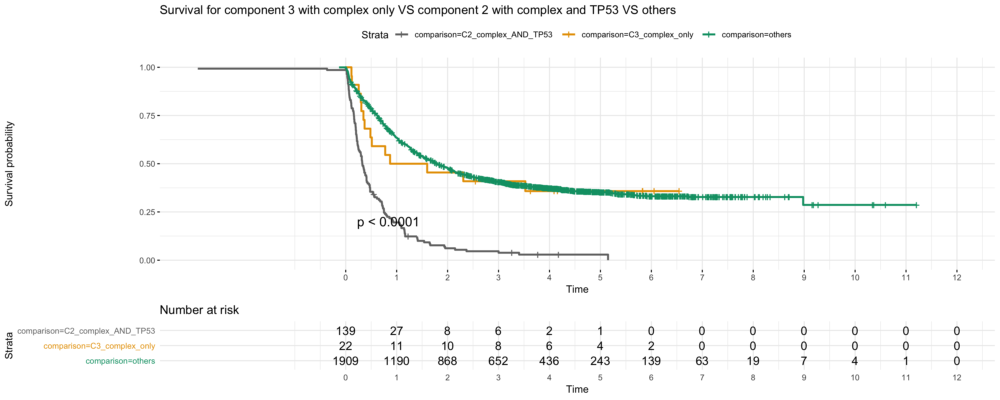

In [32]:
set_notebook_plot_size(15,5)
plot_surv(df_c_3,"Survival for component 3 with complex only VS component 2 with complex and TP53 VS others")

<a id='tp53_comp'></a>

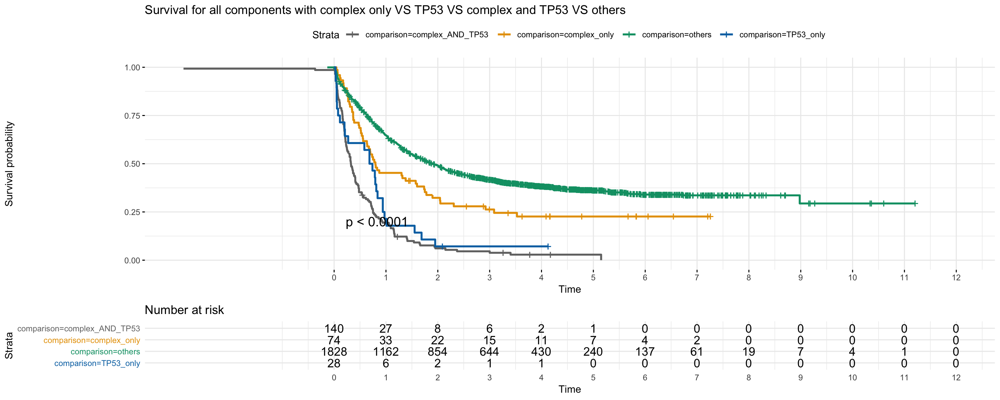

In [33]:
df_c_3$comparison <- ifelse((df_c_3$complex==1) & (df_c_3$TP53==0), "complex_only", 
                     ifelse((df_c_3$complex==1) & (df_c_3$TP53==1), "complex_AND_TP53",
                     ifelse((df_c_3$complex==0) & (df_c_3$TP53==1),"TP53_only",
                                   "others" )))
plot_surv(df_c_3,"Survival for all components with complex only VS TP53 VS complex and TP53 VS others")

## II- Let's compare when add8

[1] "Count : C3_add8 : 46"
[1] "Count : C3_no_add8 : 90"


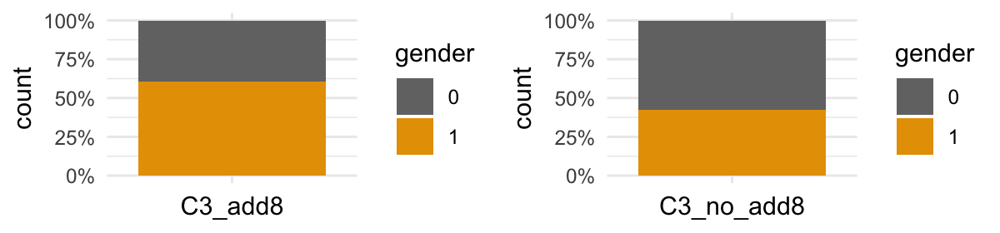

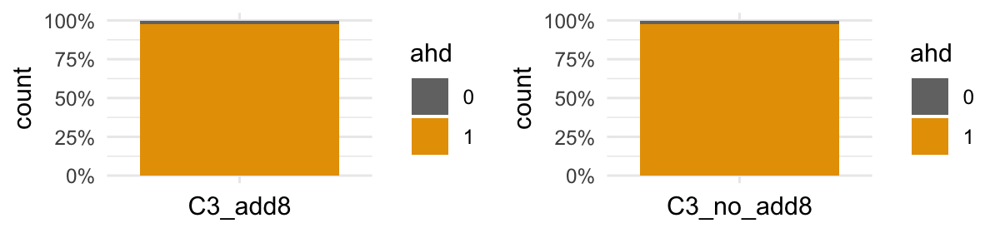

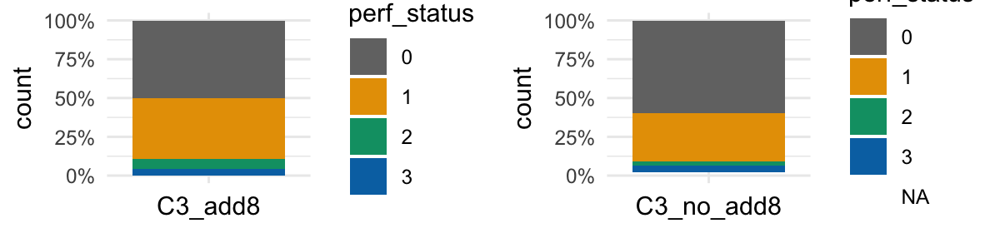

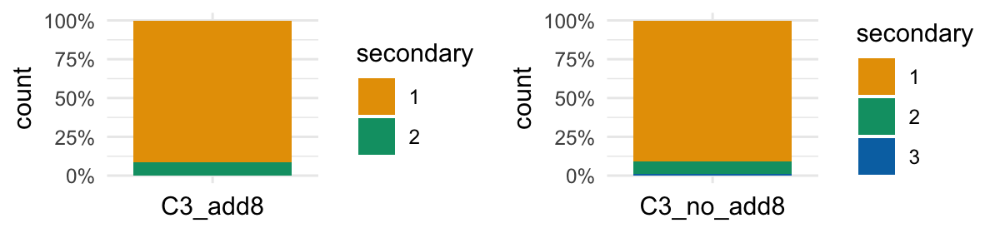

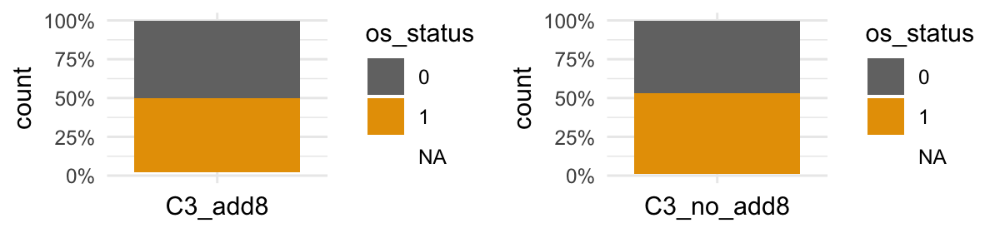

...

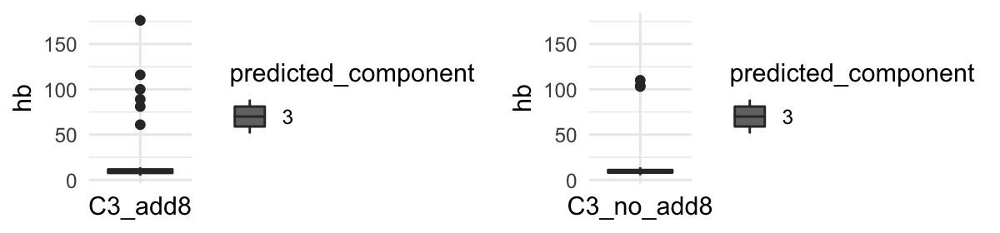

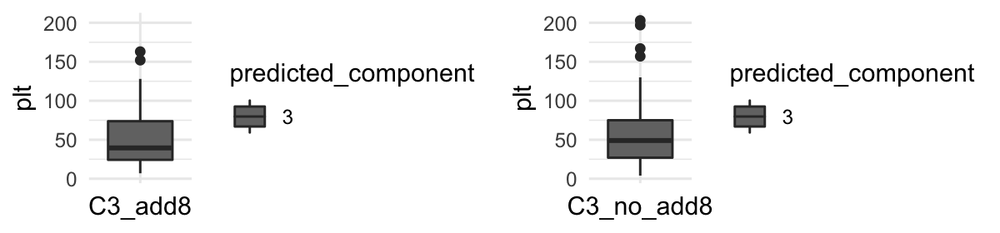

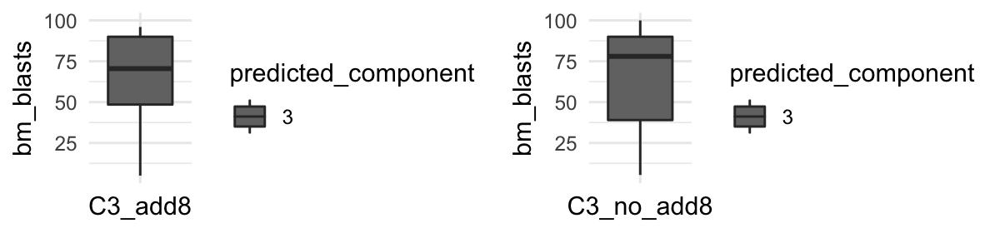

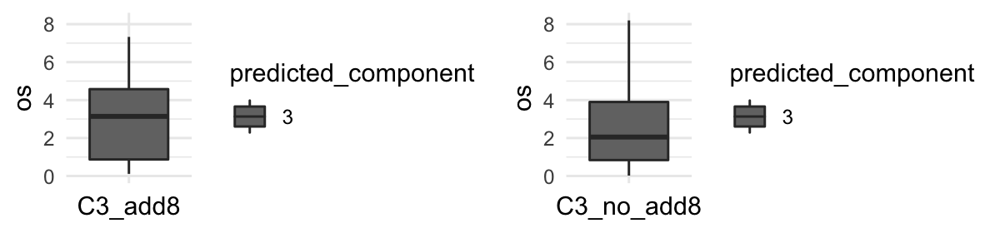

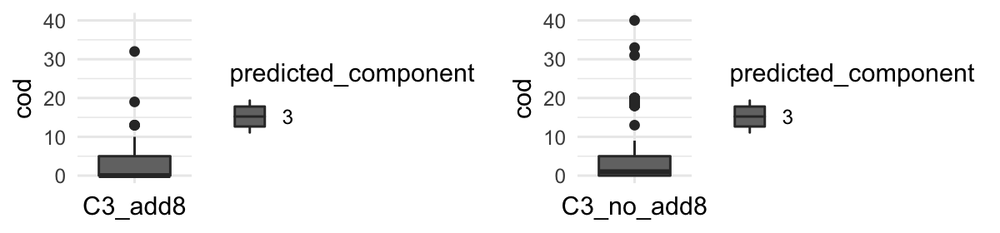

In [34]:
df_c_3$comparison <- ifelse((df_c_3$predicted_component==3) & (df_c_3$add_8==1), "C3_add8", 
                     ifelse((df_c_3$predicted_component==3)& (df_c_3$add_8==0) , "C3_no_add8",
                                   "others" ))
plottings(df_c_3[(df_c_3$predicted_component==3)& (df_c_3$add_8==1),],
          df_c_3[(df_c_3$predicted_component==3)& (df_c_3$add_8==0),],
          x1="C3_add8",x2="C3_no_add8",many=2,width=6,height=1.4)

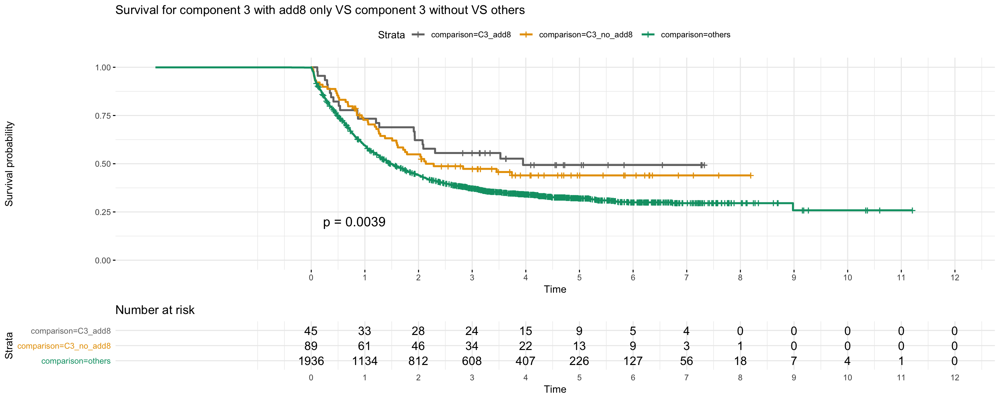

In [35]:
set_notebook_plot_size(15,5)
plot_surv(df_c_3,"Survival for component 3 with add8 only VS component 3 without VS others")

## III- t_v_11,t_9_11,t_15_17 and overlap

[1] "Count : C3_t_v_11_AND_t_9_11 : 1"
[1] "Count : C3_t_v_11_only : 27"
[1] "Count : C3_t_9_11_only : 27"
[1] "Count : C3_t_15_17_only : 9"


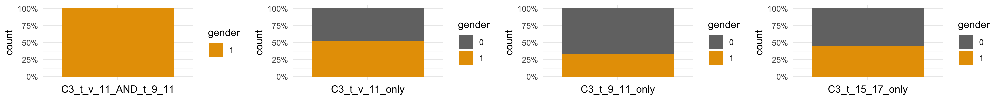

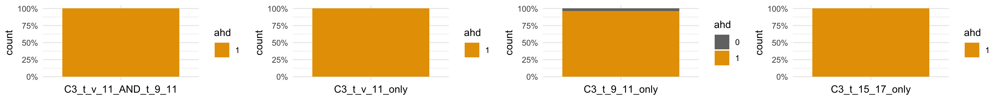

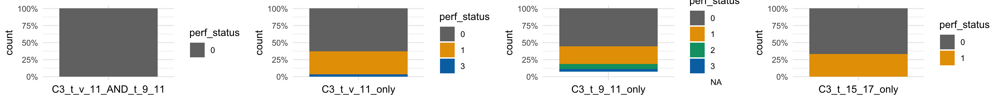

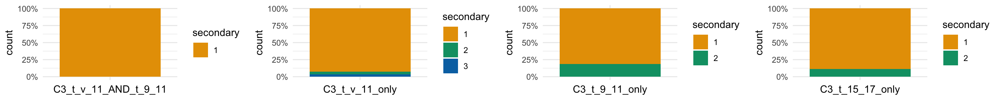

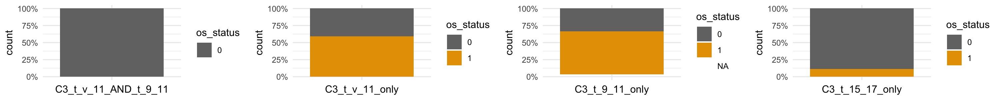

...

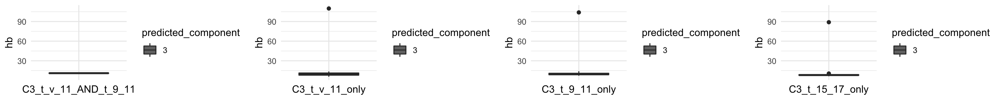

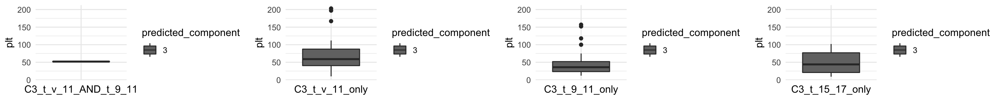

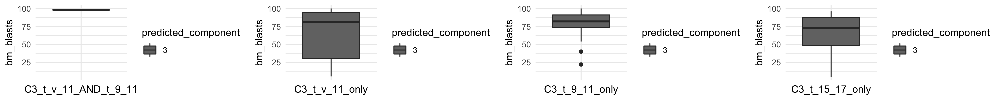

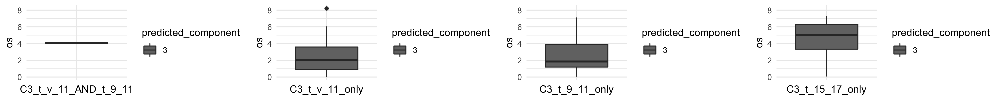

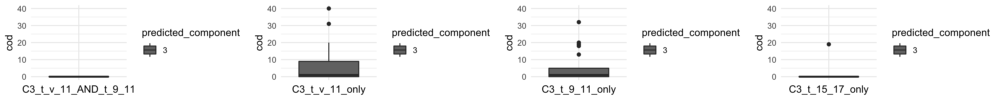

In [36]:
df_c_3$comparison <- ifelse((df_c_3$predicted_component==3) & (df_c_3$t_v_11==1) & (df_c_3$t_9_11==1), "C3_t_v_11_AND_t_9_11", #only 1 case for both
                     ifelse((df_c_3$predicted_component==3)& (df_c_3$t_v_11==1) , "C3_t_v_11_only",
                     ifelse((df_c_3$predicted_component==3)& (df_c_3$t_9_11==1),"C3_t_9_11_only",
                     ifelse((df_c_3$predicted_component==3)& (df_c_3$t_15_17==1),"C3_t_15_17_only",       
                                   "others" ))))
plottings(df_c_3[(df_c_3$predicted_component==3) & (df_c_3$t_v_11==1) & (df_c_3$t_9_11==1),],
          df_c_3[(df_c_3$predicted_component==3)& (df_c_3$t_v_11==1),],
          df_c_3[(df_c_3$predicted_component==3)& (df_c_3$t_9_11==1),],
          df_c_3[(df_c_3$predicted_component==3)& (df_c_3$t_15_17==1),],
          x1="C3_t_v_11_AND_t_9_11",x2="C3_t_v_11_only",x3="C3_t_9_11_only",x4="C3_t_15_17_only",many=4,width=15,height=1.5)

<a id='comp3'></a>

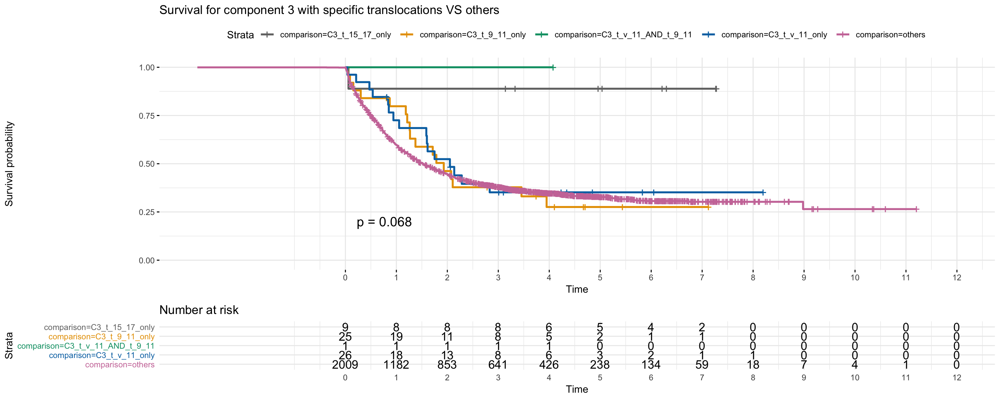

In [37]:
set_notebook_plot_size(14,6)
plot_surv(df_c_3,"Survival for component 3 with specific translocations VS others")

# Component 4

## I-Compare minusy when t_8_21 activated

In [38]:
df_c_4 <- merge(df_w_correlates,df_all_components[c("ASXL2","KIT","minusy","del_9","t_8_21")],by=0)
rownames(df_c_4) <- df_c_4$Row.names
df_c_4 <- df_c_4 [,-1]

[1] "Count : C4_t_8_21_minusy=0 : 47"
[1] "Count : C4_t_8_21_minusy=1 : 27"


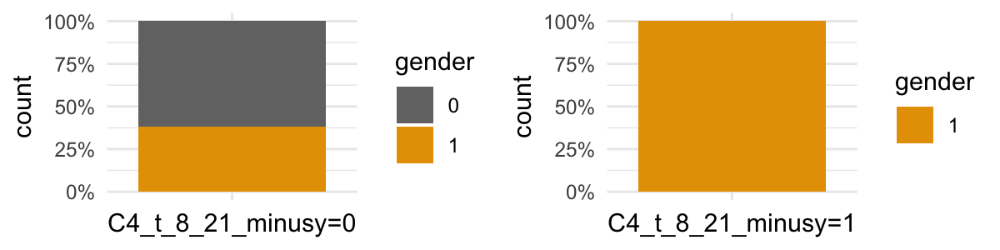

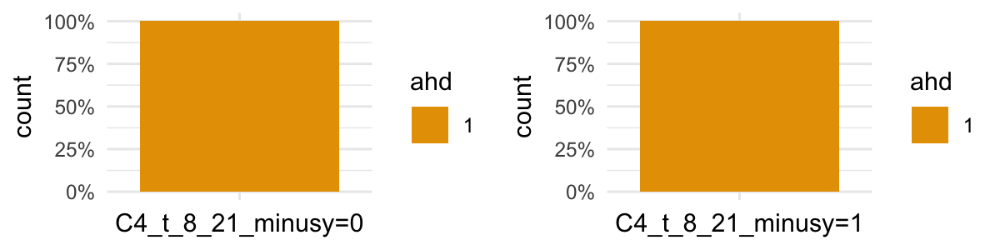

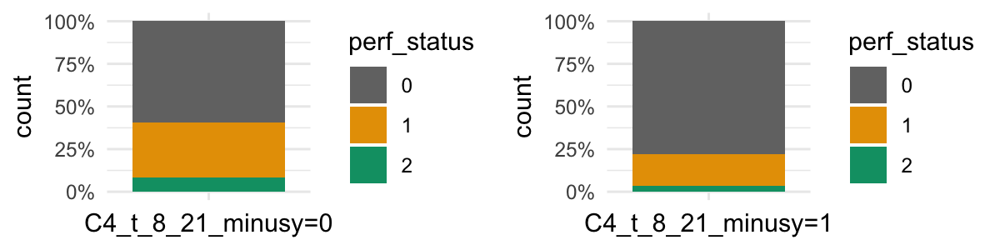

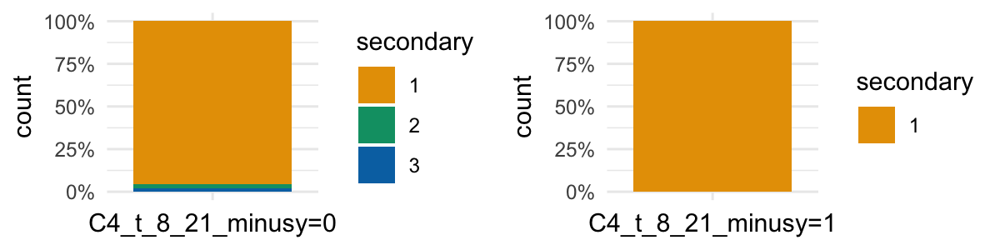

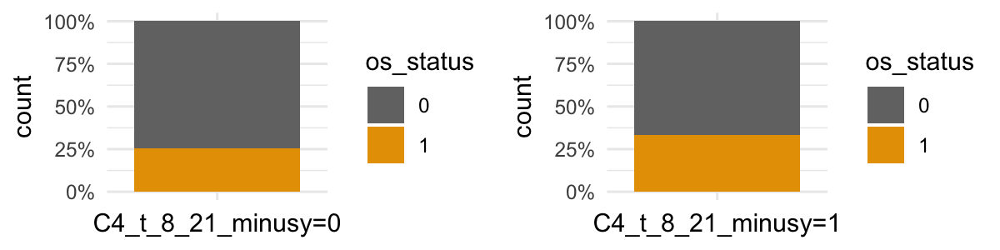

...

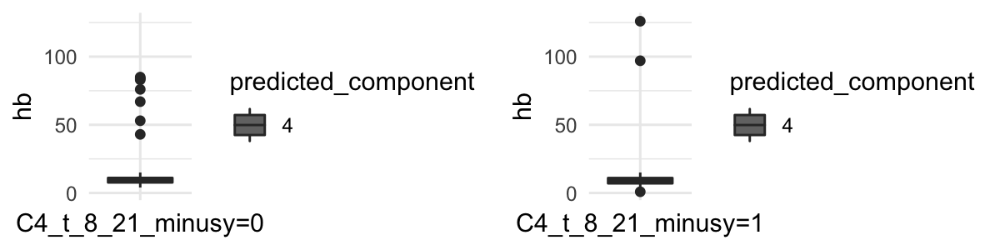

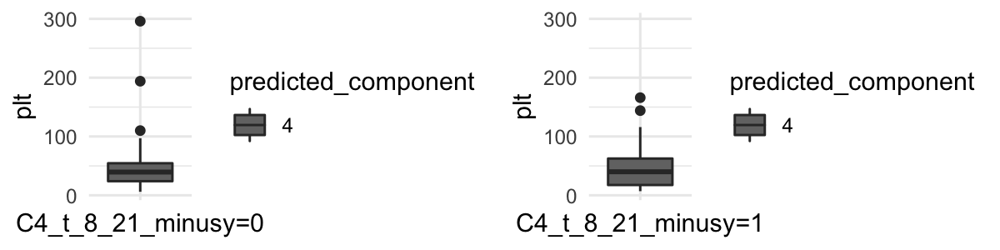

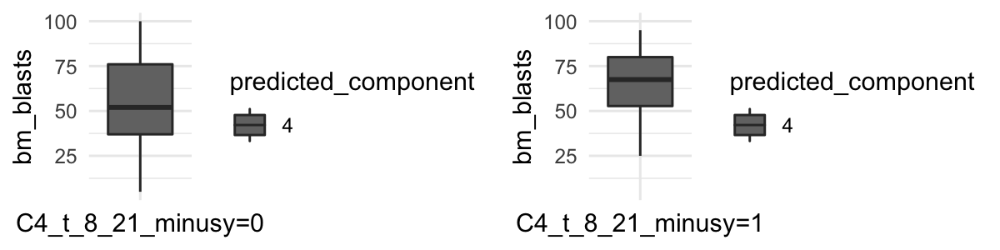

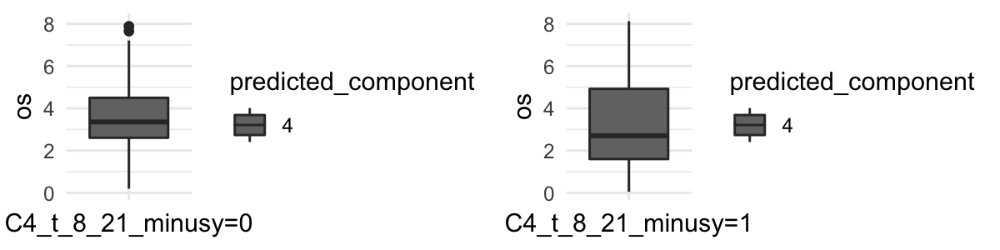

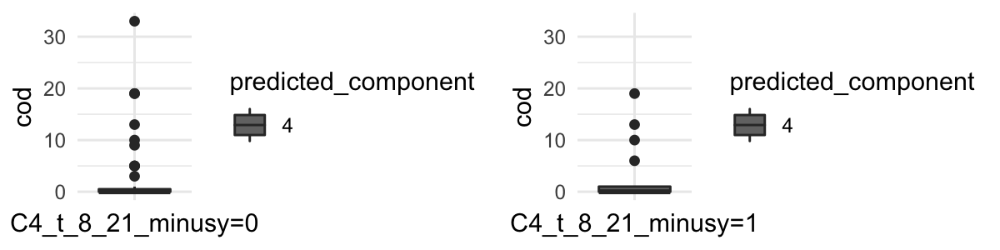

In [39]:
df_c_4$comparison <- ifelse((df_c_4$predicted_component==4)& (df_c_4$minusy==0) & (df_c_4$t_8_21==1), "C4_t_8_21_minusy=0", 
                  ifelse((df_c_4$predicted_component==4)& (df_c_4$minusy==1) & (df_c_4$t_8_21==1), "C4_t_8_21_minusy=1",
                                 "others" ))
plottings(df_c_4[(df_c_4$predicted_component==4)& (df_c_4$minusy==0) & (df_c_4$t_8_21==1),],
          df_c_4[(df_c_4$predicted_component==4)& (df_c_4$minusy==1) & (df_c_4$t_8_21==1),],
          x1="C4_t_8_21_minusy=0",x2="C4_t_8_21_minusy=1",many=2,width=6,height=1.5)

<a id='comp4minusy'></a>

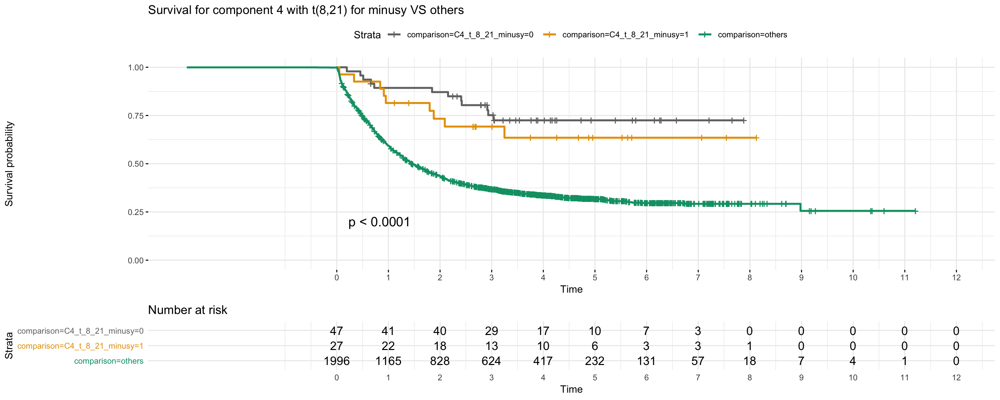

In [40]:
set_notebook_plot_size(15,4.8)
plot_surv(df_c_4,"Survival for component 4 with t(8,21) for minusy VS others")

## II-Compare KIT when t_8_21 activated

In [41]:
df_c_4$comparison <- ifelse((df_c_4$predicted_component==4)& (df_c_4$KIT==0) & (df_c_4$t_8_21==1), "C4_t_8_21_KIT=0", 
                  ifelse((df_c_4$predicted_component==4)& (df_c_4$KIT==1) & (df_c_4$t_8_21==1), "C4_t_8_21_KIT=1",
                                 "others" ))

[1] "Count : C4_t_8_21_KIT=0 : 55"
[1] "Count : C4_t_8_21_KIT=1 : 19"


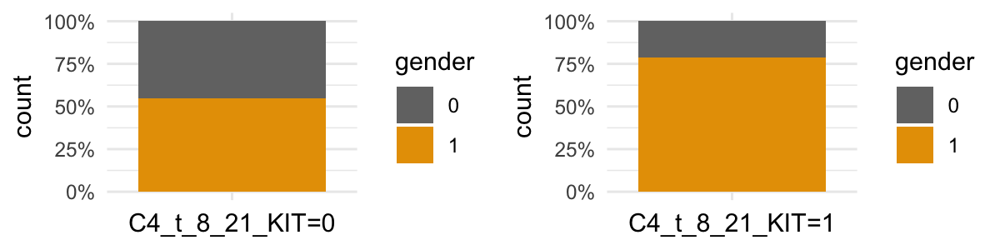

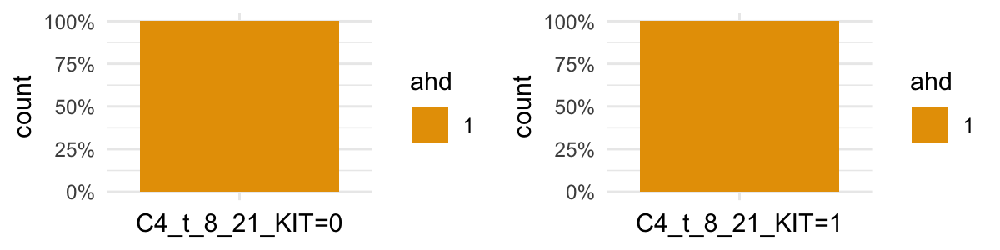

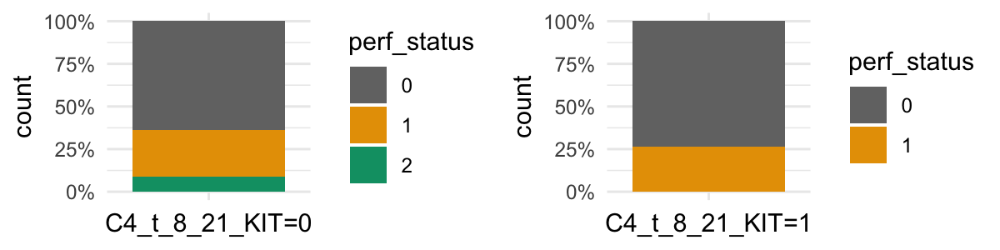

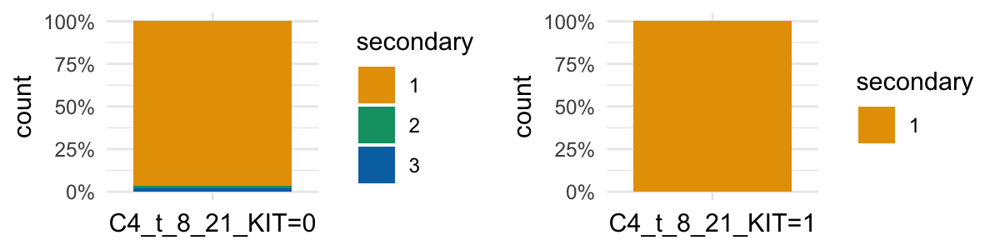

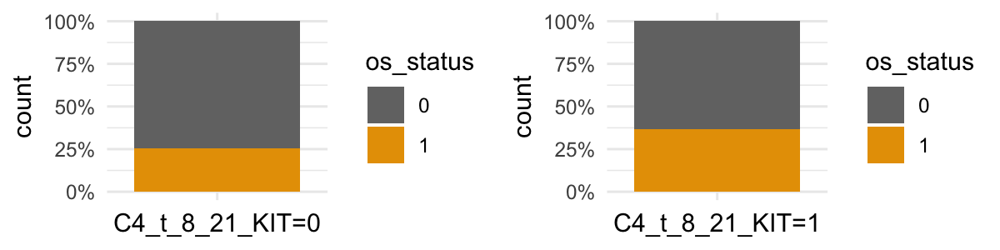

...

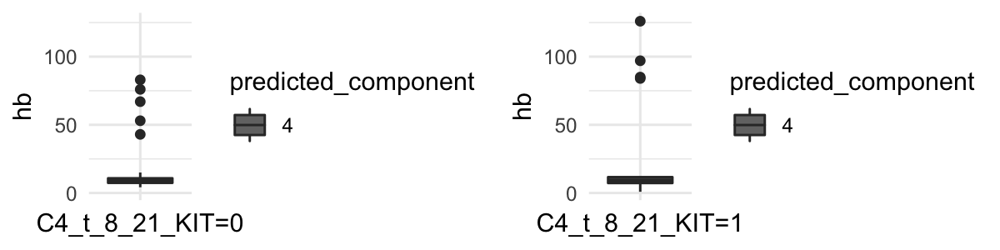

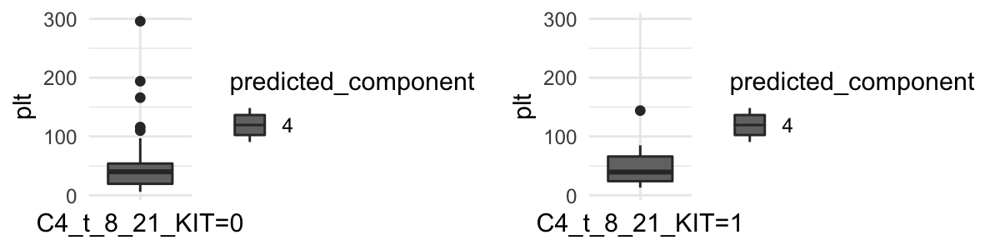

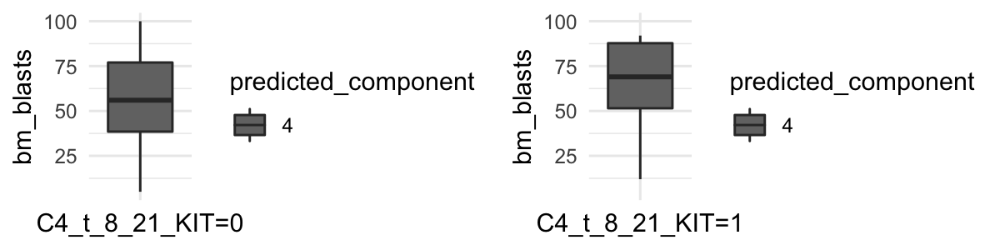

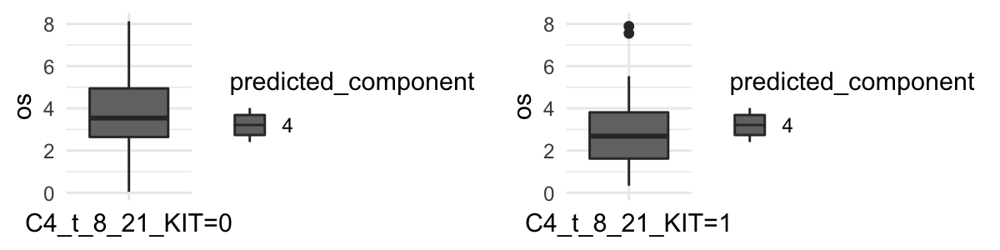

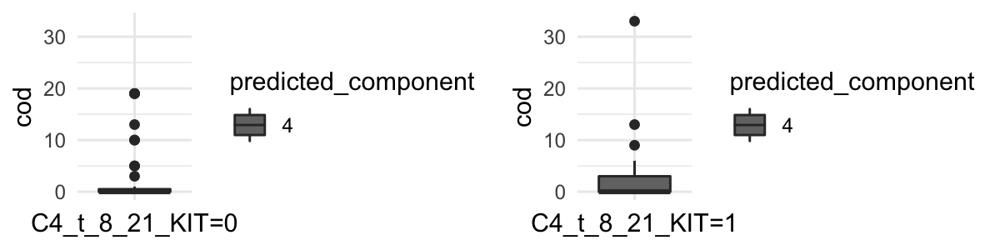

In [42]:
plottings(df_c_4[(df_c_4$predicted_component==4)& (df_c_4$KIT==0) & (df_c_4$t_8_21==1),],
          df_c_4[(df_c_4$predicted_component==4)& (df_c_4$KIT==1) & (df_c_4$t_8_21==1),],
          x1="C4_t_8_21_KIT=0",x2="C4_t_8_21_KIT=1",many=2,width=6,height=1.5)

<a id='comp4KIT'></a>

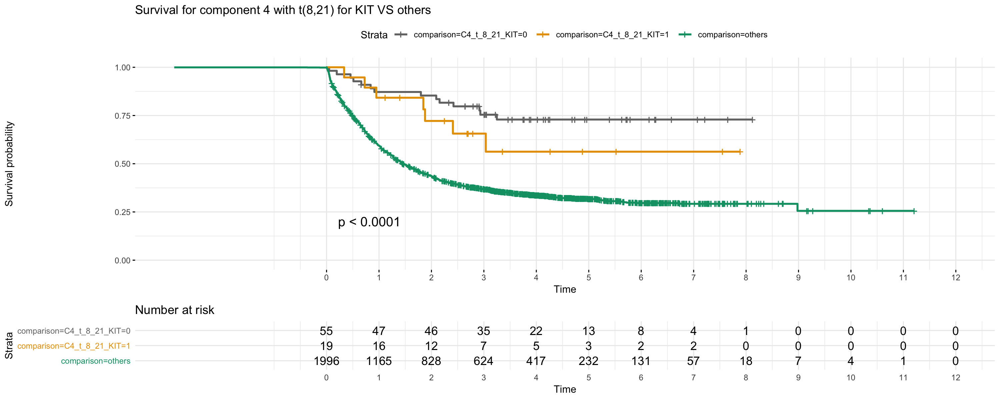

In [43]:
set_notebook_plot_size(12,5.5)
plot_surv(df_c_4,"Survival for component 4 with t(8,21) for KIT VS others")

## III- Analysis with del9 and t_8_21

[1] "Count : C4_t_8_21_AND_del_9=0 : 56"
[1] "Count : C4_t_8_21_AND_del_9=1 : 18"


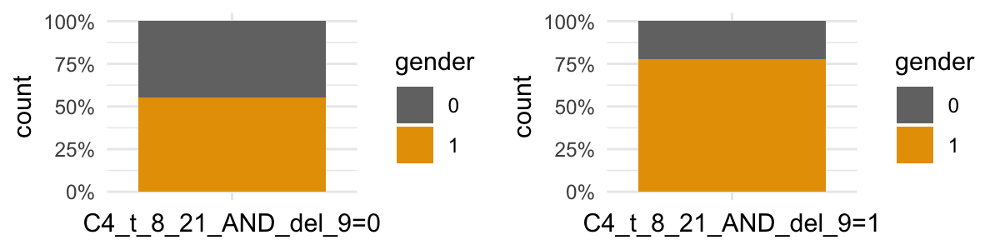

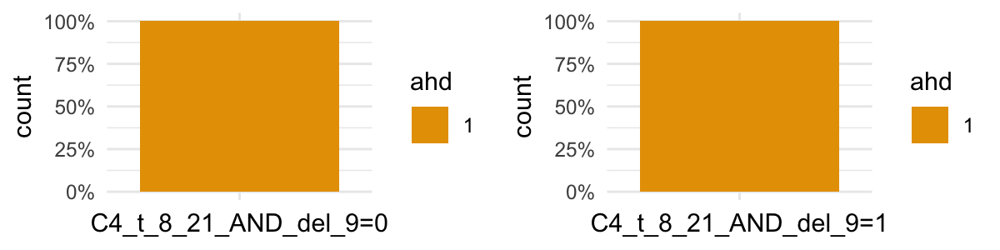

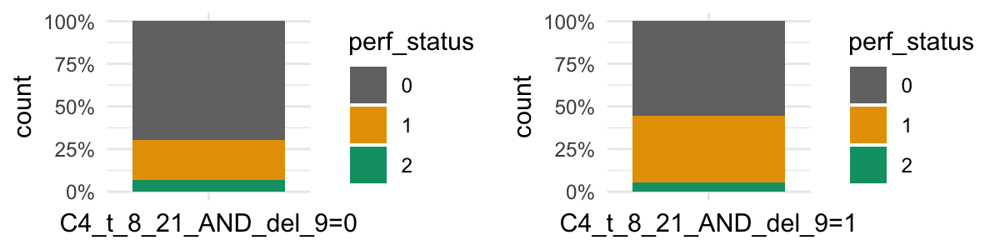

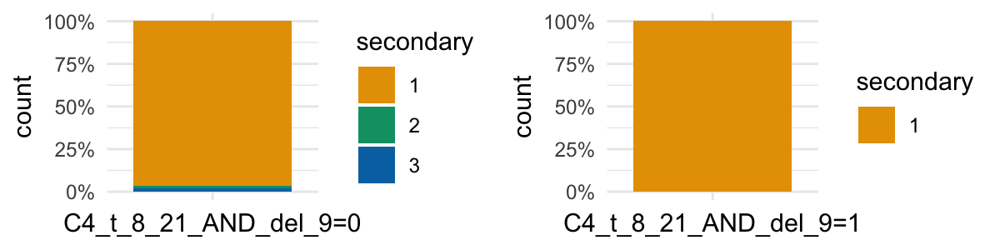

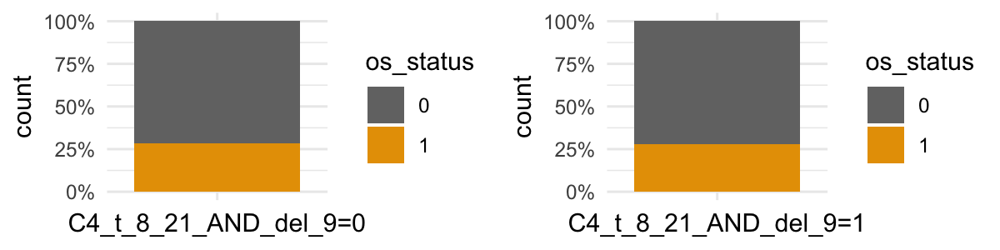

...

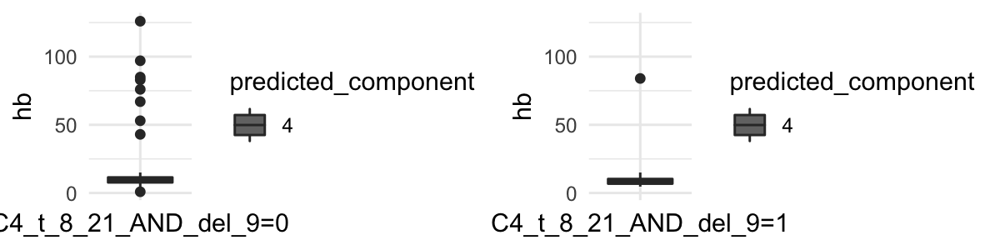

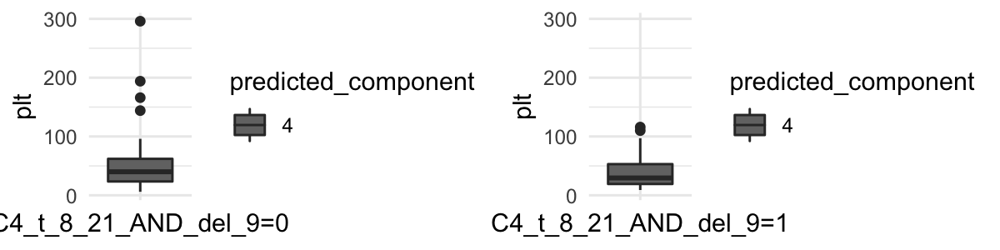

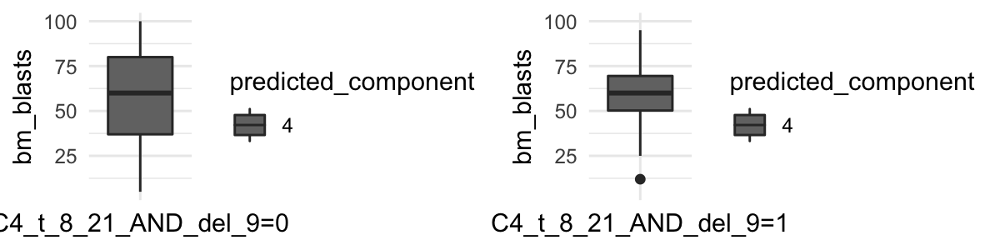

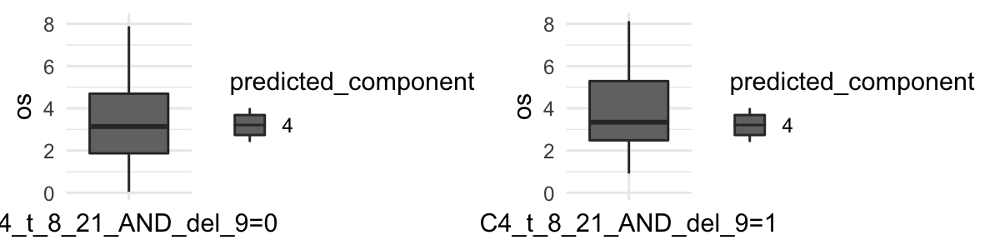

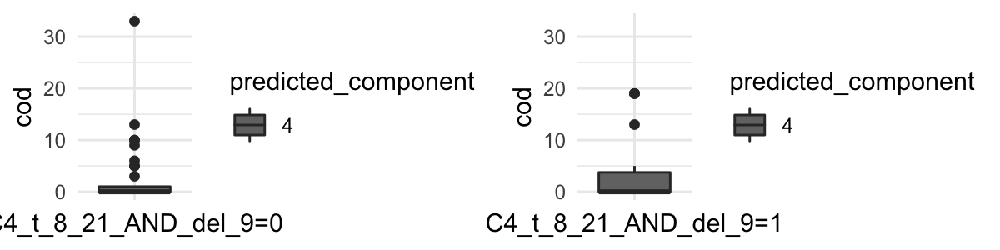

In [44]:
df_c_4$comparison <- ifelse((df_c_4$predicted_component==4)& (df_c_4$del_9==0) & (df_c_4$t_8_21==1), "C4_t_8_21_AND_del_9=0", 
                  ifelse((df_c_4$predicted_component==4)& (df_c_4$del_9==1) & (df_c_4$t_8_21==1), "C4_t_8_21_AND_del_9=1",
                              "others" ))
plottings(df_c_4[(df_c_4$predicted_component==4)& (df_c_4$del_9==0) & (df_c_4$t_8_21==1),],
          df_c_4[(df_c_4$predicted_component==4)& (df_c_4$del_9==1) & (df_c_4$t_8_21==1),],
          x1="C4_t_8_21_AND_del_9=0",x2="C4_t_8_21_AND_del_9=1",many=2,width=6,height=1.5)

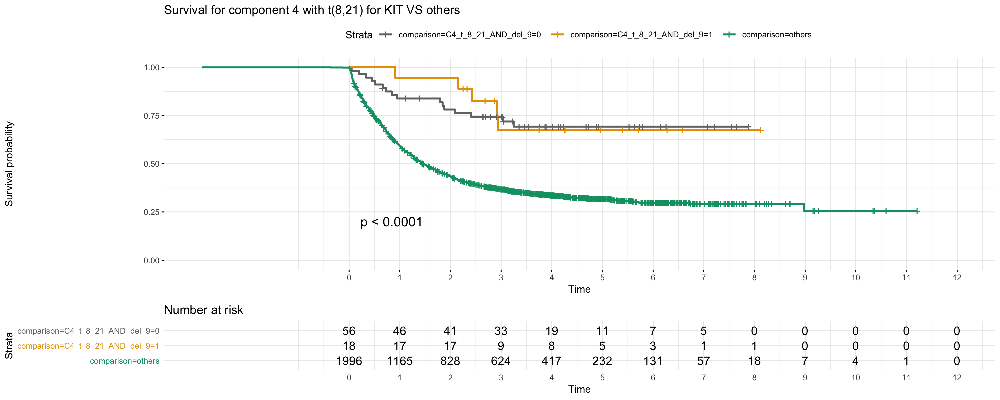

In [45]:
set_notebook_plot_size(15,5)
plot_surv(df_c_4,"Survival for component 4 with t(8,21) for KIT VS others")

# Component 4 compared with 5 on KIT when t(8,21) activated

[1] "Count : C4_t_8_21_KIT=0 : 55"
[1] "Count : C4_t_8_21_KIT=1 : 19"
[1] "Count : C5_t_8_21_KIT=0 : 15"
[1] "Count : C5_t_8_21_KIT=1 : 9"


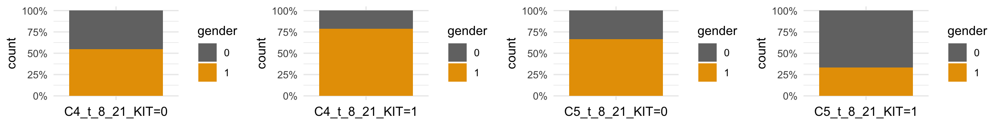

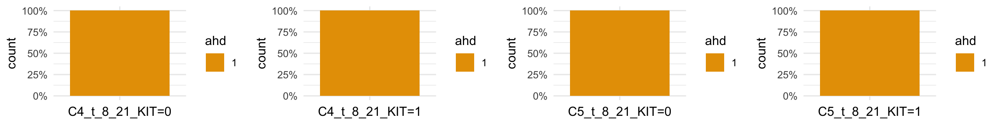

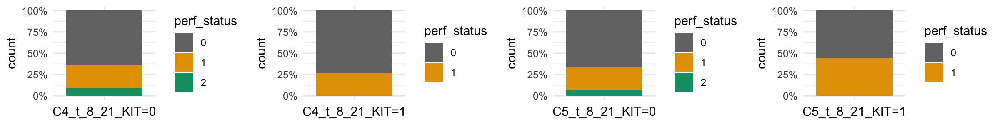

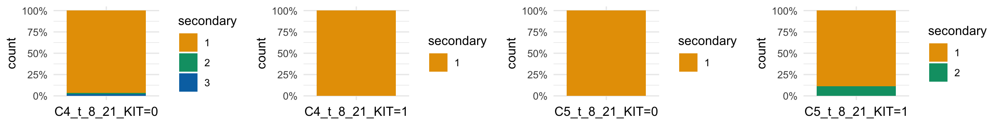

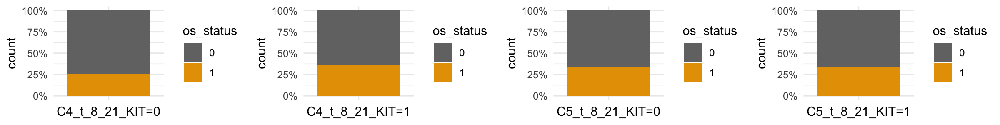

...

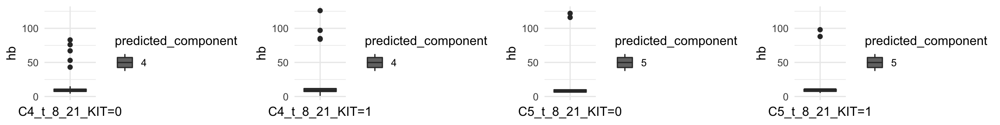

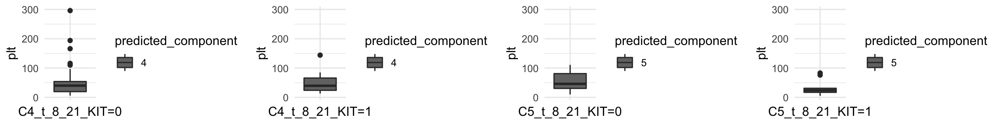

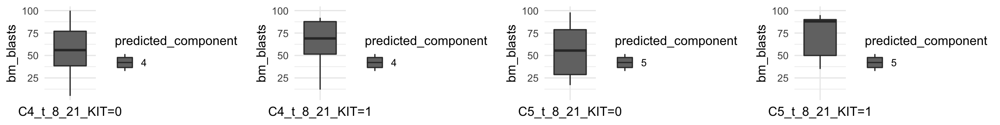

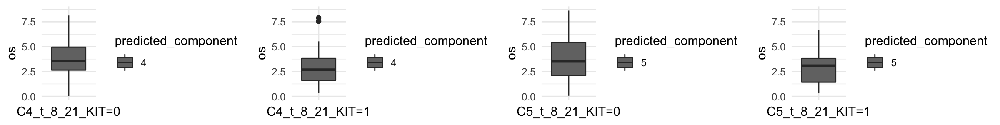

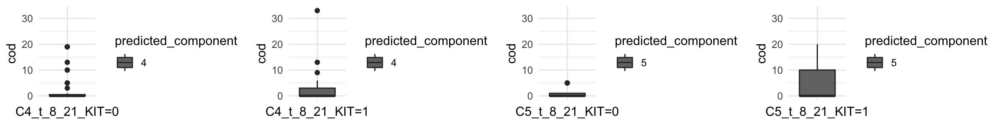

In [46]:
plottings(df_c_4[(df_c_4$predicted_component==4)& (df_c_4$KIT==0) & (df_c_4$t_8_21==1),],
          df_c_4[(df_c_4$predicted_component==4)& (df_c_4$KIT==1) & (df_c_4$t_8_21==1),],
          df_c_4[(df_c_4$predicted_component==5)& (df_c_4$KIT==0) & (df_c_4$t_8_21==1),],
          df_c_4[(df_c_4$predicted_component==5)& (df_c_4$KIT==1) & (df_c_4$t_8_21==1),],
          x1="C4_t_8_21_KIT=0",x2="C4_t_8_21_KIT=1",x3="C5_t_8_21_KIT=0",x4="C5_t_8_21_KIT=1",many=4,width=12,height=1.5)

<a id='comp4-5'></a>

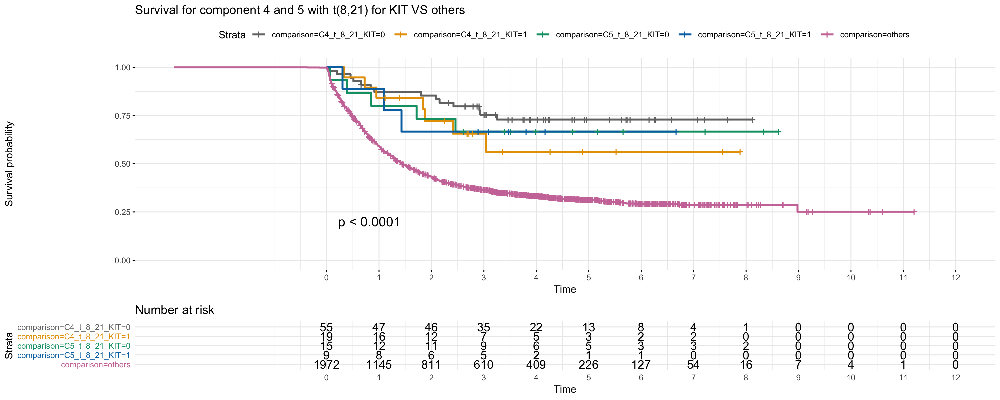

In [47]:
df_c_4$comparison <- ifelse((df_c_4$predicted_component==4)& (df_c_4$KIT==0) & (df_c_4$t_8_21==1), "C4_t_8_21_KIT=0", 
                     ifelse((df_c_4$predicted_component==4)& (df_c_4$KIT==1) & (df_c_4$t_8_21==1), "C4_t_8_21_KIT=1",
                     ifelse((df_c_4$predicted_component==5)& (df_c_4$KIT==0) & (df_c_4$t_8_21==1), "C5_t_8_21_KIT=0", 
                     ifelse((df_c_4$predicted_component==5)& (df_c_4$KIT==1) & (df_c_4$t_8_21==1), "C5_t_8_21_KIT=1",      
                                 "others" ))))
set_notebook_plot_size(15,5.8)
plot_surv(df_c_4,"Survival for component 4 and 5 with t(8,21) for KIT VS others")

# All components KIT and t(8,21)

<a id='t_8_21'></a>

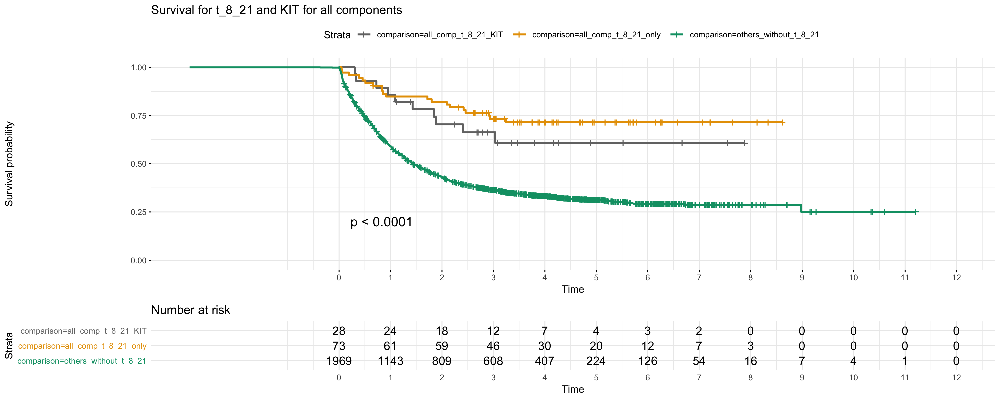

In [48]:
set_notebook_plot_size(15,5.5)
tmp <- merge(df_w_correlates,df_all_components[c("t_8_21","KIT")],by=0)
rownames(tmp) <- tmp$Row.names
tmp <- tmp [,-1]
tmp$comparison <- ifelse((tmp$t_8_21==1) & (tmp$KIT==1)  ,"all_comp_t_8_21_KIT",
                  ifelse((tmp$t_8_21==1) & (tmp$KIT==0),"all_comp_t_8_21_only","others_without_t_8_21"))
plot_surv(tmp,"Survival for t_8_21 and KIT for all components")

# Component 5

In [49]:
df_c_5 <- merge(df_w_correlates,df_all_components[c("KIT","minusy","t_8_21","NRAS_p.G12_13","NRAS_p.Q61_62")],by=0)
rownames(df_c_5) <- df_c_5$Row.names
df_c_5 <- df_c_5 [,-1]
df_c_5$comparison <- ifelse((df_c_5$predicted_component==5) & (df_c_5$t_8_21==1) &(df_c_5$NRAS_p.Q61_62==1 | df_c_5$NRAS_p.G12_13==1), "C5_t_8_21=1_AND_NRAS=1", 
                     ifelse((df_c_5$predicted_component==5) & (df_c_5$t_8_21==1) &(df_c_5$NRAS_p.Q61_62==0) & (df_c_5$NRAS_p.G12_13==0), "C5_t_8_21=1_AND_NRAS=0",
                     ifelse((df_c_5$predicted_component==5) & (df_c_5$t_8_21==0) &(df_c_5$NRAS_p.Q61_62==1 | df_c_5$NRAS_p.G12_13==1), "C5_T_8_21=0_AND_NRAS=1", 
                     ifelse((df_c_5$predicted_component==5) & (df_c_5$t_8_21==0) &(df_c_5$NRAS_p.Q61_62==0) & (df_c_5$NRAS_p.G12_13==0), "C5_t_8_21=0_AND_NRAS=0",
                                 "others" ))))

[1] "Count : C5_t_8_21=1_AND_NRAS=1 : 14"
[1] "Count : C5_t_8_21=1_AND_NRAS=0 : 10"
[1] "Count : C5_T_8_21=0_AND_NRAS=1 : 20"
[1] "Count : C5_t_8_21=0_AND_NRAS=0 : 18"


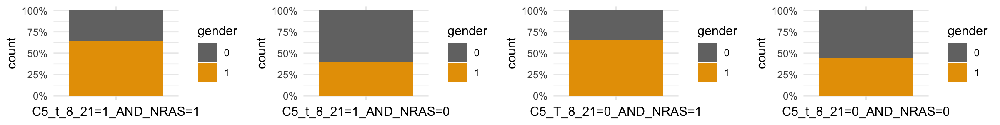

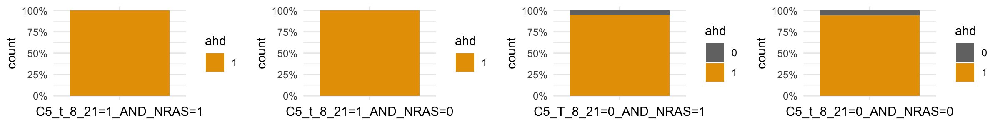

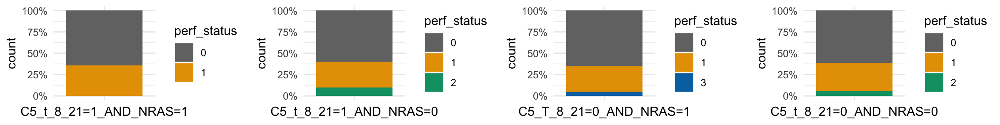

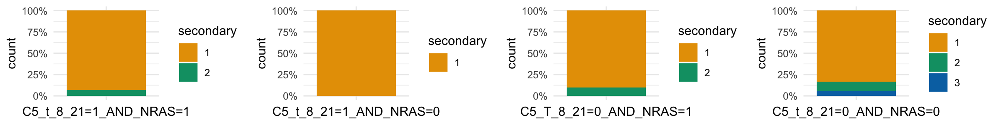

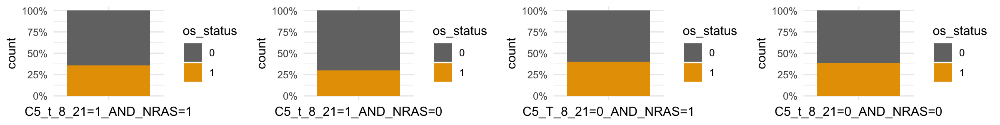

...

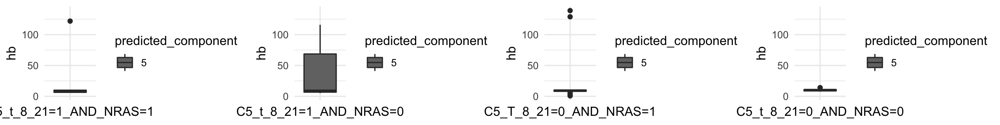

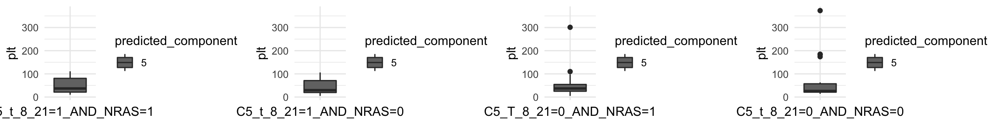

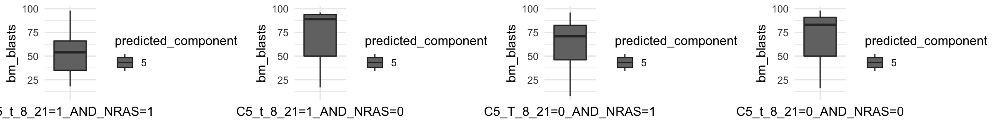

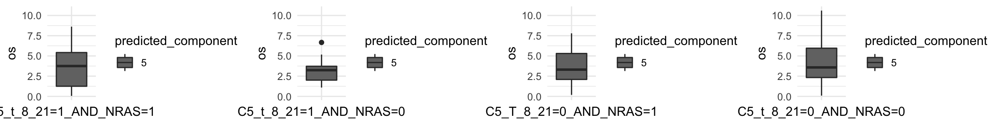

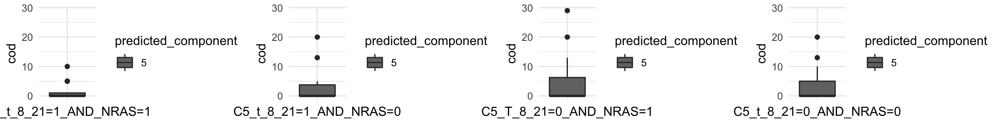

In [50]:
plottings(df_c_5[(df_c_5$predicted_component==5) & (df_c_5$t_8_21==1) &(df_c_5$NRAS_p.Q61_62==1 | df_c_5$NRAS_p.G12_13==1),],
          df_c_5[(df_c_5$predicted_component==5) & (df_c_5$t_8_21==1) &(df_c_5$NRAS_p.Q61_62==0) & (df_c_5$NRAS_p.G12_13==0),],
          df_c_5[(df_c_5$predicted_component==5) & (df_c_5$t_8_21==0) &(df_c_5$NRAS_p.Q61_62==1 | df_c_5$NRAS_p.G12_13==1),],
          df_c_5[(df_c_5$predicted_component==5) & (df_c_5$t_8_21==0) &(df_c_5$NRAS_p.Q61_62==0) & (df_c_5$NRAS_p.G12_13==0),],
          x1="C5_t_8_21=1_AND_NRAS=1",x2="C5_t_8_21=1_AND_NRAS=0",x3="C5_T_8_21=0_AND_NRAS=1",x4="C5_t_8_21=0_AND_NRAS=0",many=4,width=12,height=1.5)

<a id='comp5'></a>

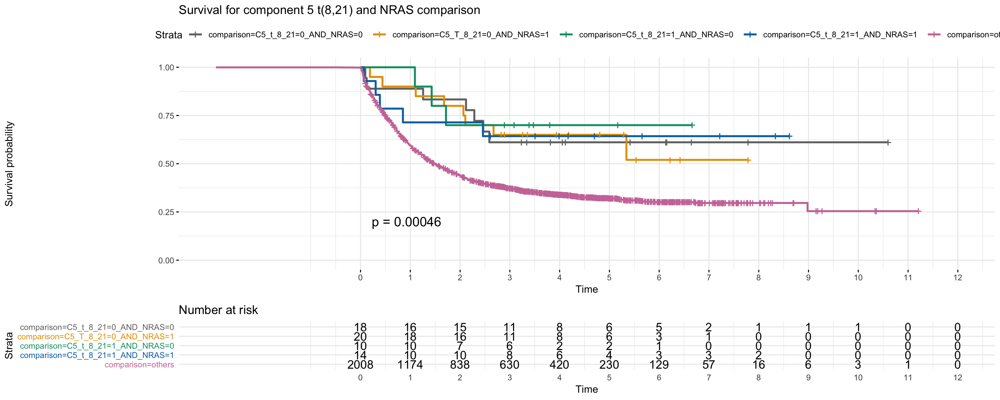

In [51]:
set_notebook_plot_size(15,5.8)
plot_surv(df_c_5,"Survival for component 5 t(8,21) and NRAS comparison")

<a id='NRAS'></a>

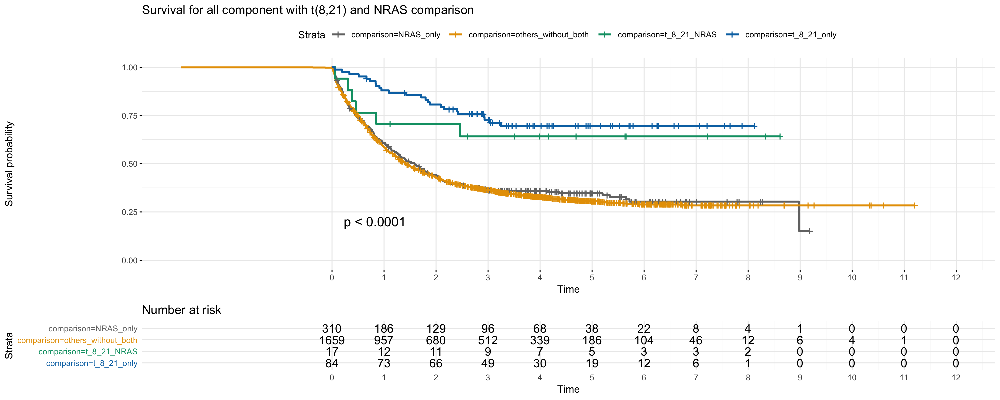

In [52]:
tmp <- df_c_5
tmp$comparison <- ifelse( (df_c_5$t_8_21==1) &(df_c_5$NRAS_p.Q61_62==1 | df_c_5$NRAS_p.G12_13==1), "t_8_21_NRAS", 
                     ifelse( (df_c_5$t_8_21==1) &(df_c_5$NRAS_p.Q61_62==0) & (df_c_5$NRAS_p.G12_13==0), "t_8_21_only",
                     ifelse( (df_c_5$t_8_21==0) &(df_c_5$NRAS_p.Q61_62==1 | df_c_5$NRAS_p.G12_13==1), "NRAS_only",
                                 "others_without_both" )))
plot_surv(tmp,"Survival for all component with t(8,21) and NRAS comparison")

# Component 6

In [53]:
df_c_6 <- merge(df_w_correlates,df_all_components[c("CEBPA_bi","GATA2","KIT")],by=0)
rownames(df_c_6) <- df_c_6$Row.names
df_c_6 <- df_c_6 [,-1]

In [54]:
dim(df_c_6[(df_c_6$predicted_component==6) & (df_c_6$CEBPA_bi==1) & (df_c_6$GATA2==0),])

[1] 18 17

[1] "Count : C6_CEBPAbi_GATA2 : 17"
[1] "Count : C6_CEBPAbi_only : 18"
[1] "Count : C6_GATA2_only : 10"
[1] "Count : C6_others : 3"


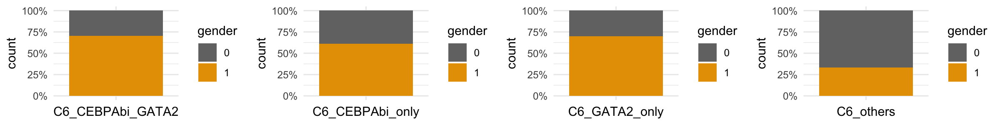

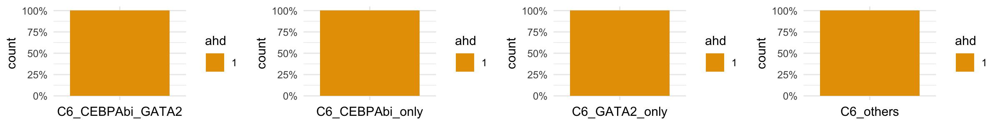

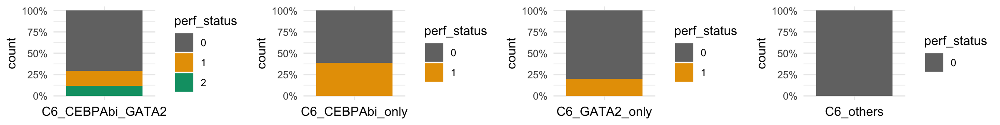

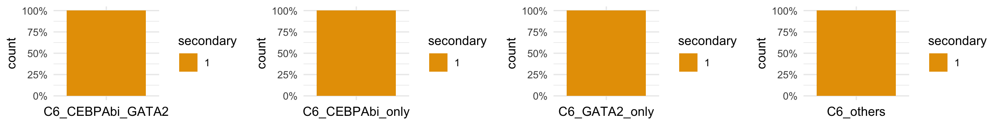

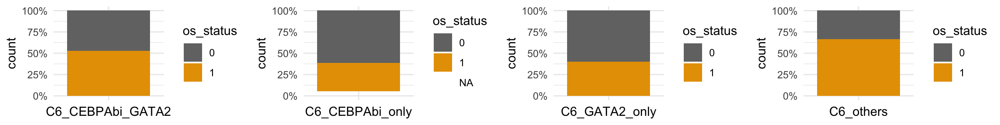

...

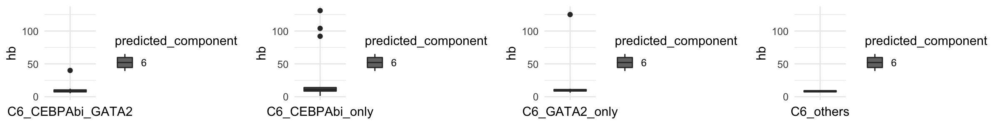

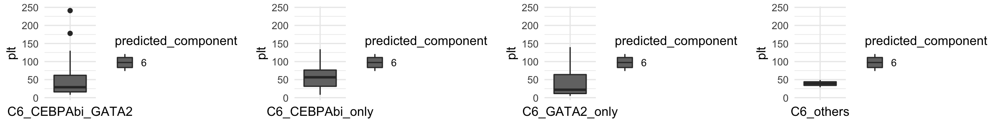

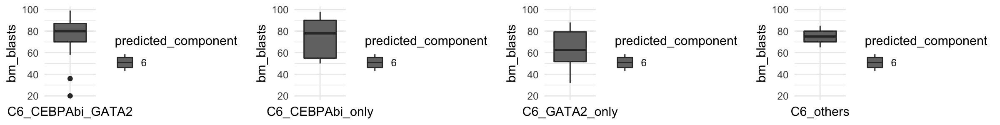

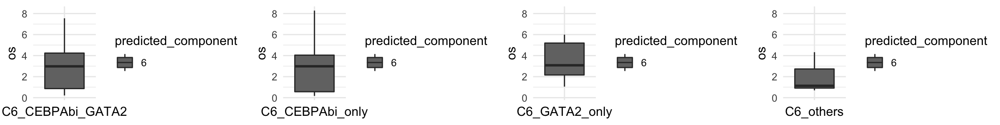

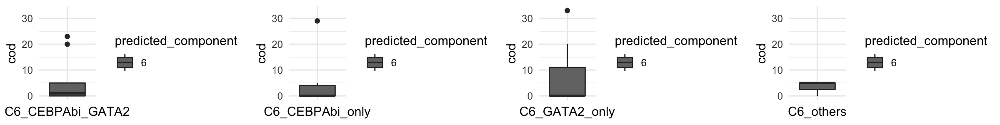

In [55]:
df_c_6$comparison <- ifelse((df_c_6$predicted_component==6) & (df_c_6$CEBPA_bi==1) & (df_c_6$GATA2==1), "C6_CEBPAbi_GATA2",
                     ifelse((df_c_6$predicted_component==6) & (df_c_6$CEBPA_bi==1) & (df_c_6$GATA2==0),"C6_CEBPAbi_only",
                     ifelse((df_c_6$predicted_component==6) & (df_c_6$CEBPA_bi==0) & (df_c_6$GATA2==1),"C6_GATA2_only",
                     ifelse((df_c_6$predicted_component==6) & (df_c_6$CEBPA_bi==0) & (df_c_6$GATA2==0),"C6_others","others" ))))
plottings(df_c_6[(df_c_6$predicted_component==6) & (df_c_6$CEBPA_bi==1) & (df_c_6$GATA2==1),],
          df_c_6[(df_c_6$predicted_component==6) & (df_c_6$CEBPA_bi==1) & (df_c_6$GATA2==0),],
          df_c_6[(df_c_6$predicted_component==6) & (df_c_6$CEBPA_bi==0) & (df_c_6$GATA2==1),],
          df_c_6[(df_c_6$predicted_component==6) & (df_c_6$CEBPA_bi==0) & (df_c_6$GATA2==0),],
          x1="C6_CEBPAbi_GATA2",x2="C6_CEBPAbi_only",x3="C6_GATA2_only",x4="C6_others",many=4,width=12,height=1.5)

<a id='comp6'></a>

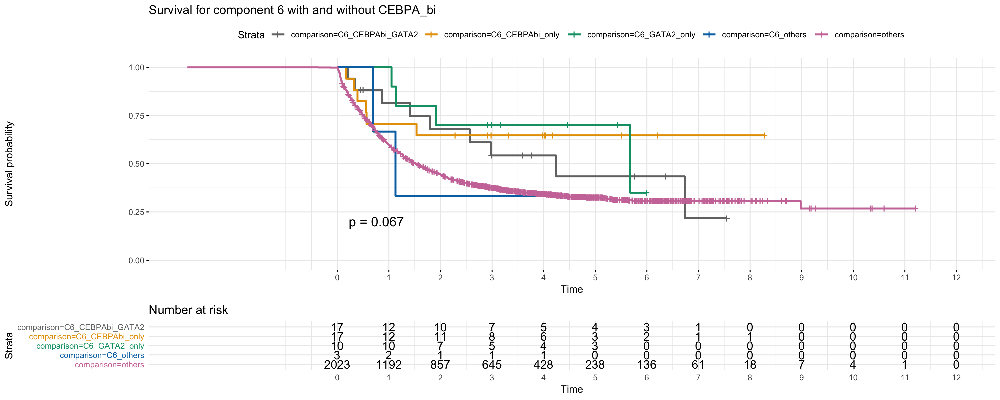

In [56]:
set_notebook_plot_size(15,6)
plot_surv(df_c_6,"Survival for component 6 with and without CEBPA_bi ")

# Component 7

## I- SF3B1,inv3 and del7 

In [57]:
df_c_7 <- merge(df_w_correlates,df_all_components[c("SF3B1","inv_3","del_7")],by=0)
rownames(df_c_7) <- df_c_7$Row.names
df_c_7 <- df_c_7 [,-1]

[1] "Count : C7_SF3B1=1_inv3=1_del7=1 : 3"
[1] "Count : others_C7 : 24"


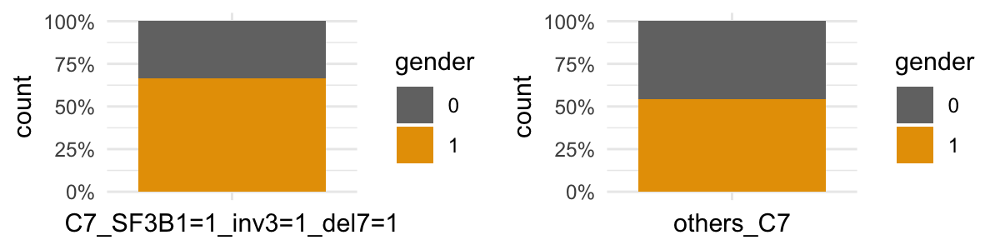

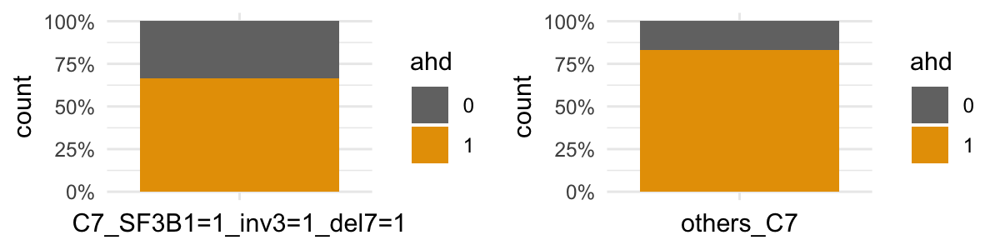

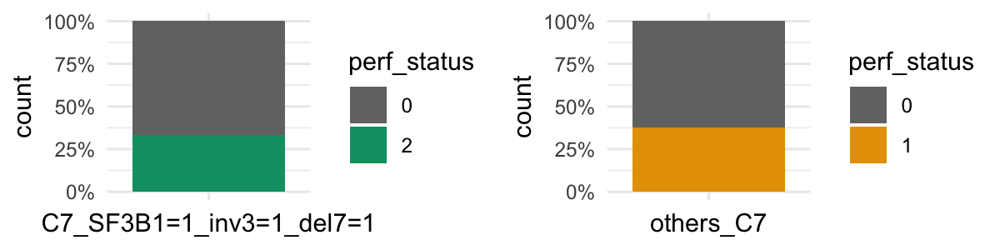

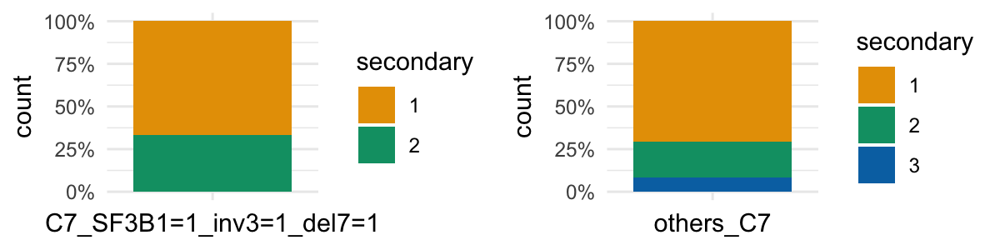

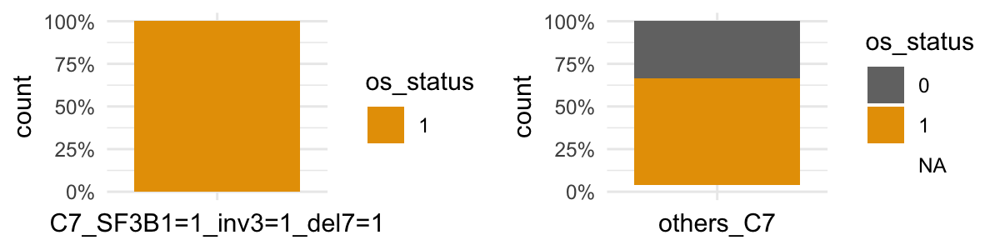

...

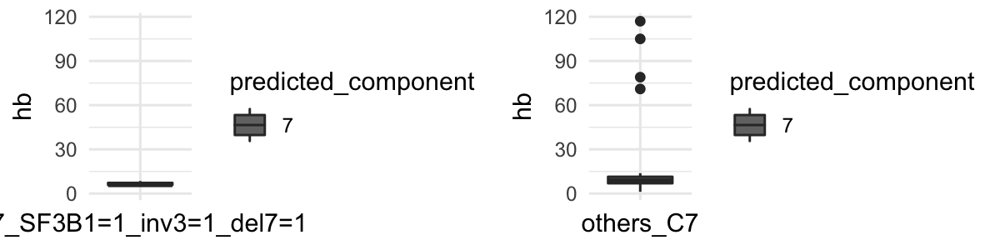

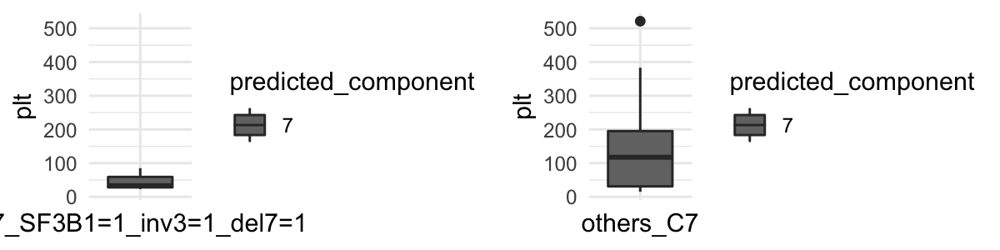

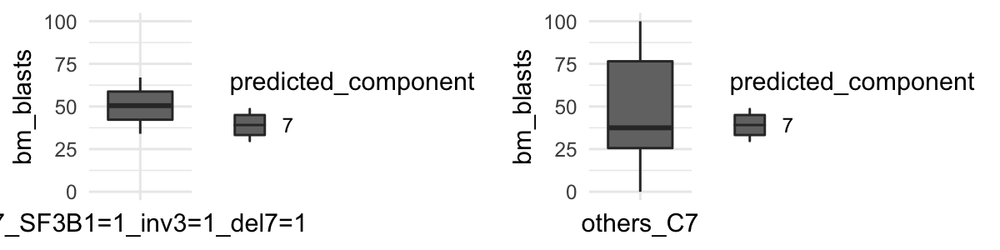

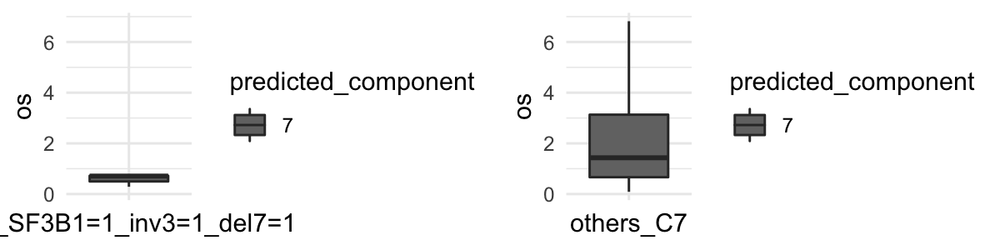

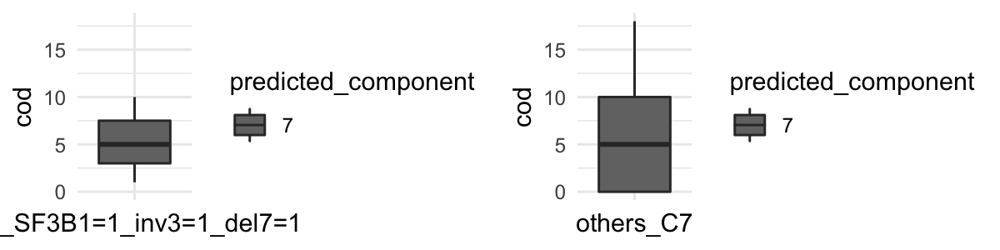

In [58]:
df_c_7$comparison <- ifelse((df_c_7$predicted_component==7) & (df_c_7$SF3B1==1) & (df_c_7$inv_3==1) & (df_c_7$del_7==1), "C7_SF3B1,inv3,del7",
                            ifelse((df_c_7$predicted_component==7) & !((df_c_7$SF3B1==1) & (df_c_7$inv_3==1) & (df_c_7$del_7==1)),"C7_others","others" ))
plottings(df_c_7[(df_c_7$predicted_component==7) & (df_c_7$SF3B1==1) & (df_c_7$inv_3==1) & (df_c_7$del_7==1),],
          df_c_7[(df_c_7$predicted_component==7) & !((df_c_7$SF3B1==1) & (df_c_7$inv_3==1) & (df_c_7$del_7==1)),],
          x1="C7_SF3B1=1_inv3=1_del7=1",x2="others_C7",many=2,width=6,height=1.5)


<a id='comp7'></a>

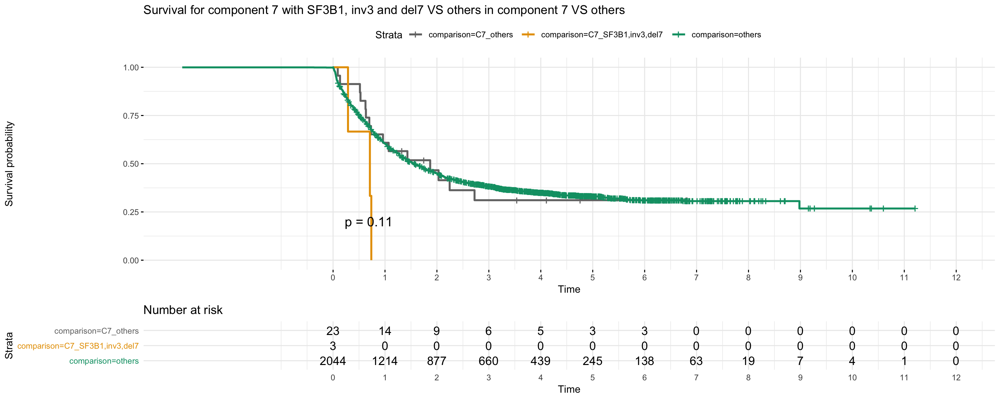

In [59]:
set_notebook_plot_size(15,5)
plot_surv(df_c_7,"Survival for component 7 with SF3B1, inv3 and del7 VS others in component 7 VS others")

## II- SF3B1,inv3 

[1] "Count : C7_SF3B1_inv3 : 6"
[1] "Count : C7_SF3B1_only : 8"
[1] "Count : C7_inv3_only : 2"


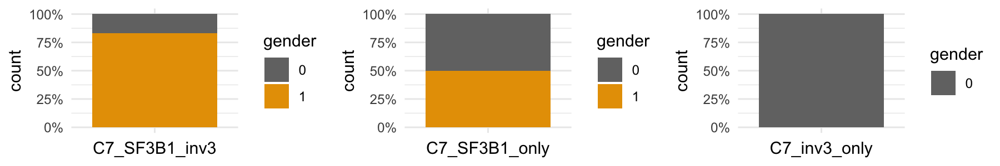

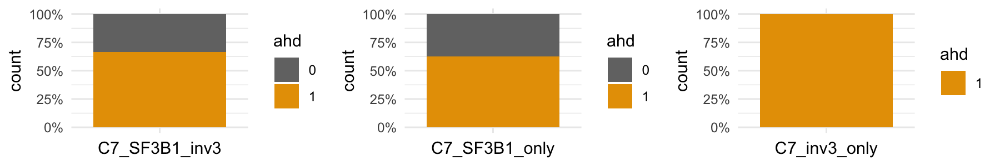

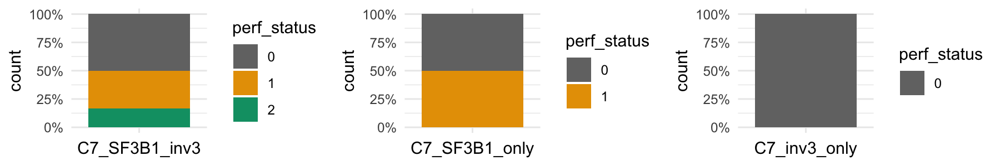

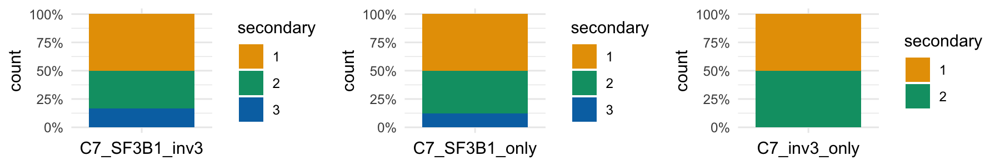

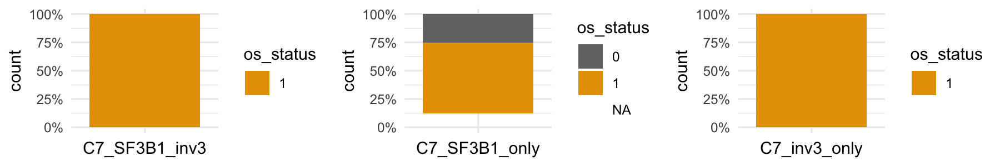

...

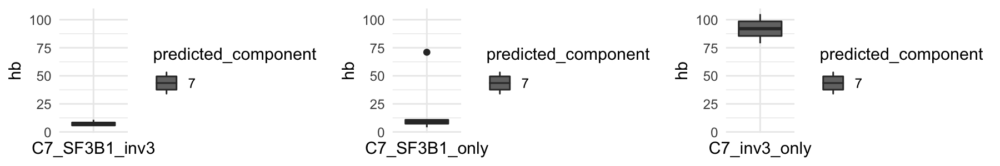

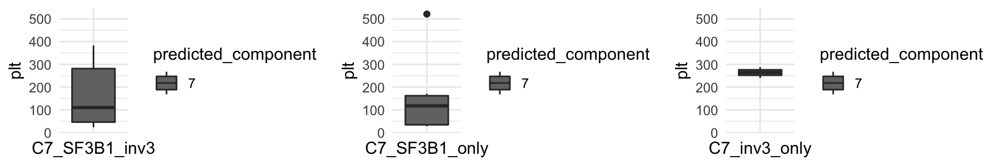

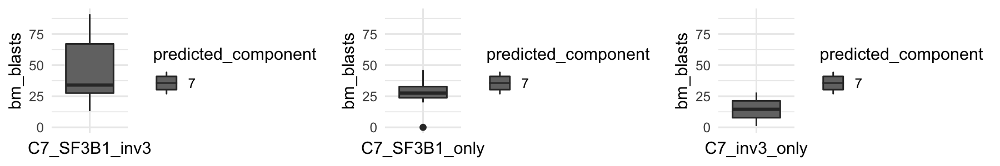

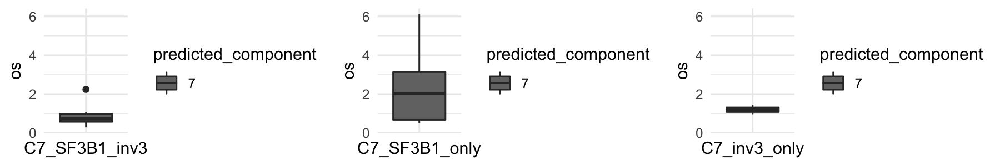

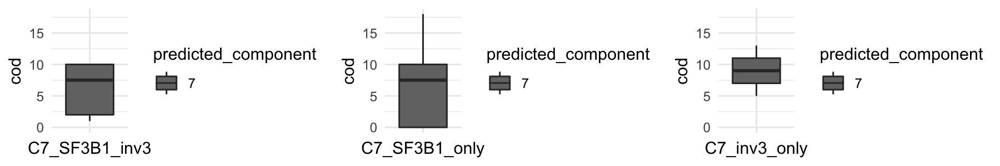

In [60]:
df_c_7$comparison <- ifelse((df_c_7$predicted_component==7) & (df_c_7$SF3B1==1) & (df_c_7$inv_3==1) , "C7_SF3B1_inv3",
                            ifelse((df_c_7$predicted_component==7) & (df_c_7$SF3B1==1) & (df_c_7$inv_3==0),"C7_SF3B1_only",
                            ifelse((df_c_7$predicted_component==7)  & (df_c_7$SF3B1==0) & (df_c_7$inv_3==1),"C7_inv3_only","others" )))
plottings(df_c_7[(df_c_7$predicted_component==7) & (df_c_7$SF3B1==1) & (df_c_7$inv_3==1),],
          df_c_7[(df_c_7$predicted_component==7) & (df_c_7$SF3B1==1) & (df_c_7$inv_3==0),],
          df_c_7[(df_c_7$predicted_component==7) & (df_c_7$SF3B1==0) & (df_c_7$inv_3==1),],
          x1="C7_SF3B1_inv3",x2="C7_SF3B1_only",x3="C7_inv3_only",many=3,width=9,height=1.5)


<a id='comp7_bis'></a>

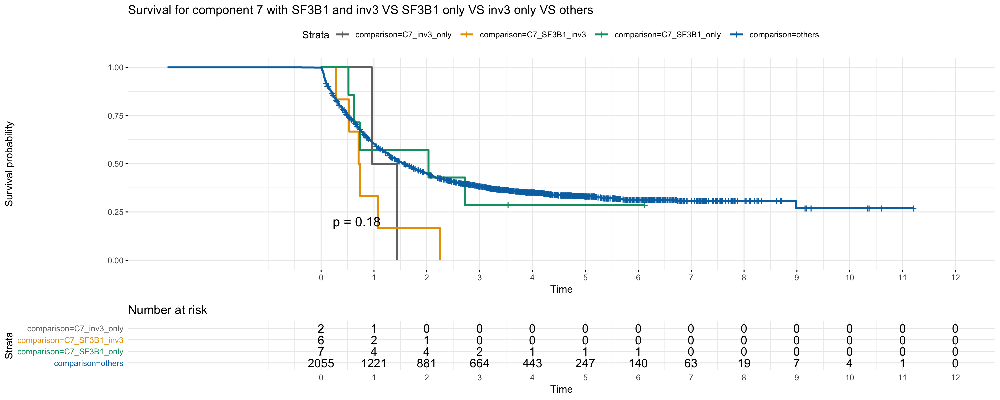

In [61]:
set_notebook_plot_size(15,6)
plot_surv(df_c_7,"Survival for component 7 with SF3B1 and inv3 VS SF3B1 only VS inv3 only VS others")

<a id='inv3_sf3b1'></a>

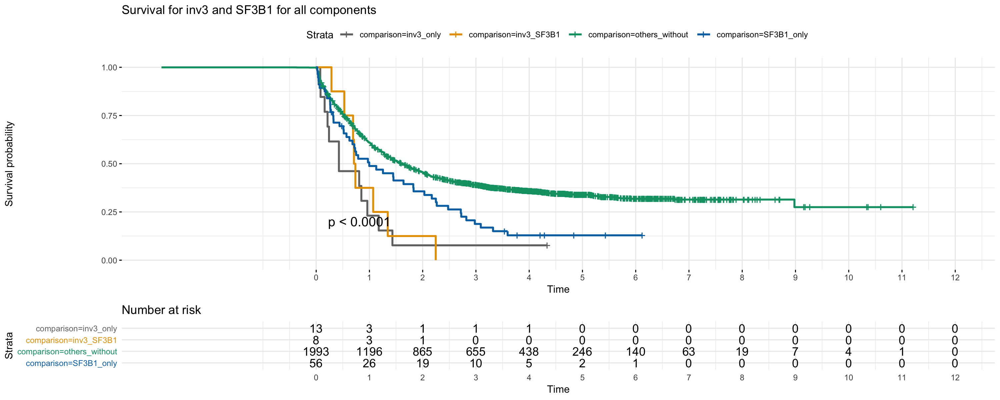

In [62]:
set_notebook_plot_size(15,5.5)
df_c_7$comparison <- ifelse((df_c_7$inv_3==1) & (df_c_7$SF3B1==1), "inv3_SF3B1",
                     ifelse((df_c_7$inv_3==1) & (df_c_7$SF3B1==0),"inv3_only",
                     ifelse((df_c_7$inv_3==0) & (df_c_7$SF3B1==1), "SF3B1_only","others_without")))
plot_surv(df_c_7, "Survival for inv3 and SF3B1 for all components")

## III- SF3B1,del7

[1] "Count : C7_SF3B1_del7 : 6"
[1] "Count : C7_SF3B1_no_del7 : 8"
[1] "Count : C7_del7_no_SF3B1 : 4"


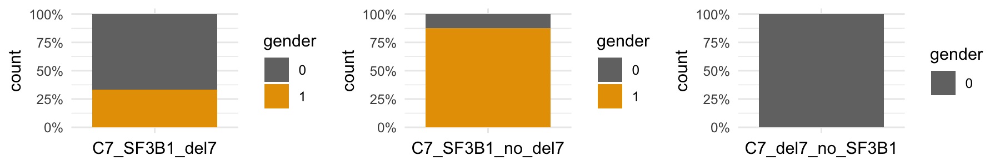

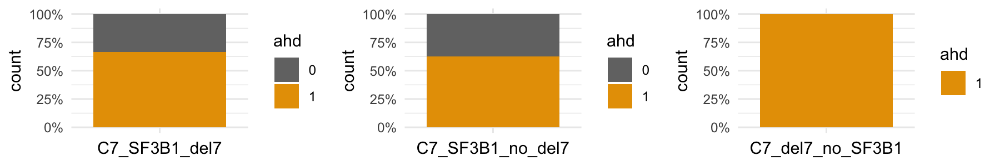

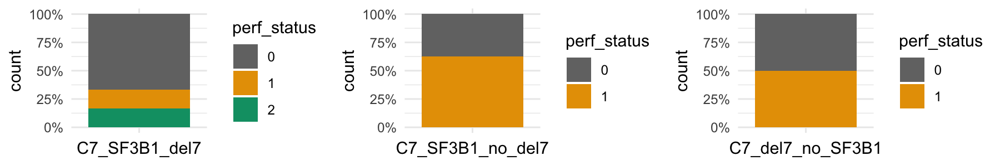

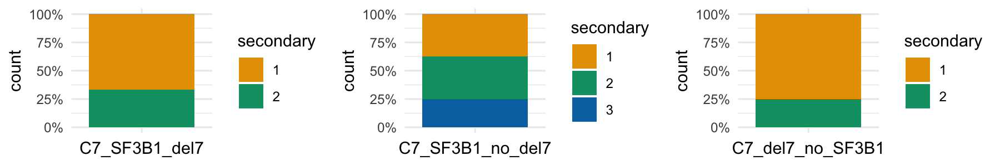

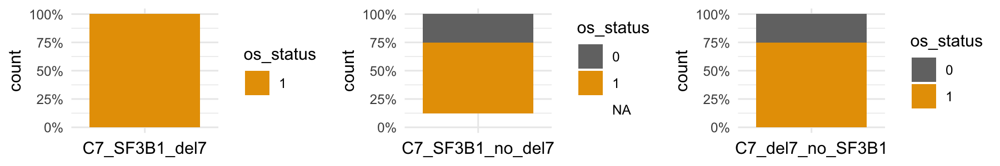

...

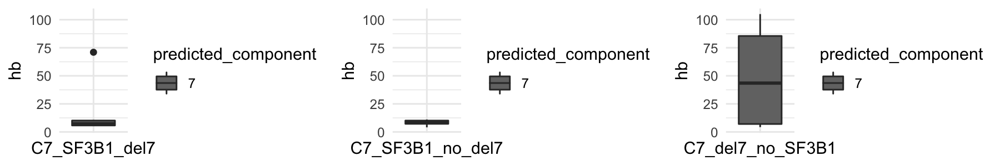

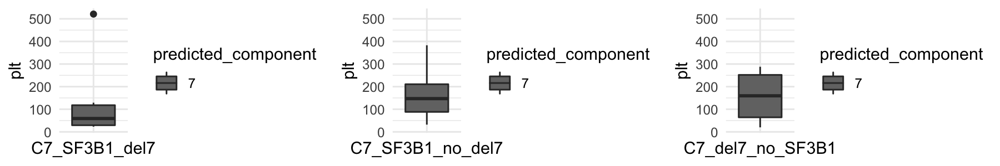

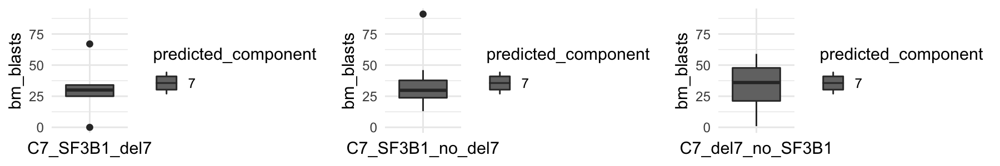

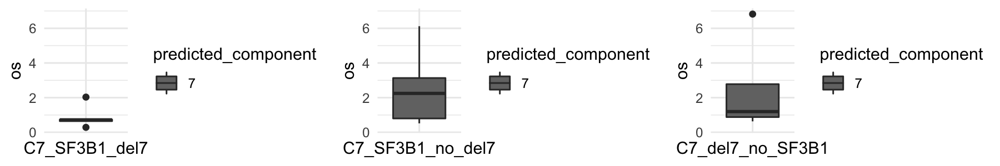

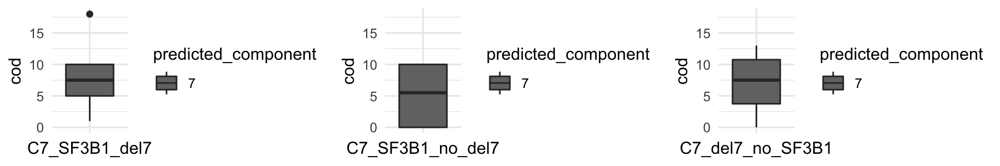

In [63]:
df_c_7$comparison <- ifelse((df_c_7$predicted_component==7) & (df_c_7$SF3B1==1) & (df_c_7$del_7==1) , "C7_SF3B1_del7",
                            ifelse((df_c_7$predicted_component==7) & (df_c_7$SF3B1==1) & (df_c_7$del_7==0),"C7_SF3B1_no_del7",
                            ifelse((df_c_7$predicted_component==7)  & (df_c_7$SF3B1==0) & (df_c_7$del_7==1),"C7_del7_no_SF3B1","others" )))
plottings(df_c_7[(df_c_7$predicted_component==7) & (df_c_7$SF3B1==1) & (df_c_7$del_7==1),],
          df_c_7[(df_c_7$predicted_component==7) & (df_c_7$SF3B1==1) & (df_c_7$del_7==0),],
          df_c_7[(df_c_7$predicted_component==7) & (df_c_7$SF3B1==0) & (df_c_7$del_7==1),],
          x1="C7_SF3B1_del7",x2="C7_SF3B1_no_del7",x3="C7_del7_no_SF3B1",many=3,width=9,height=1.5)


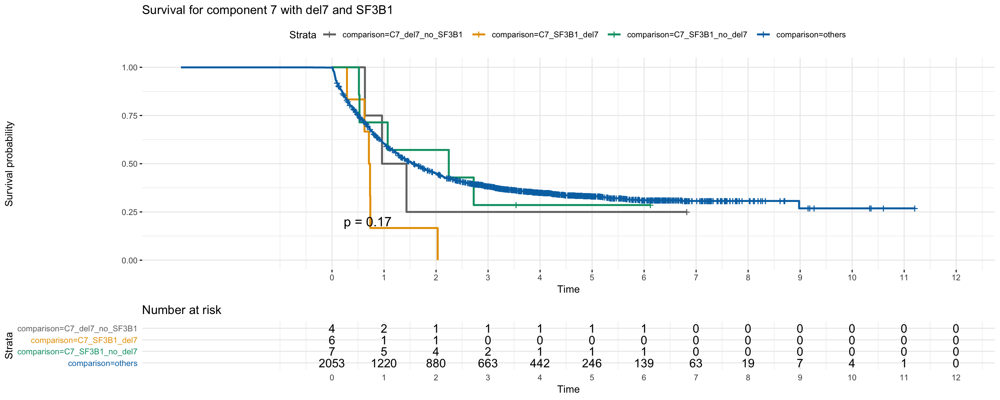

In [64]:
set_notebook_plot_size(15,6)
plot_surv(df_c_7,"Survival for component 7 with del7 and SF3B1")

# Component 8

In [65]:
df_c_8 <- merge(df_w_correlates,df_all_components[c("BAGE3","KMT2C")],by=0)
rownames(df_c_8) <- df_c_8$Row.names
df_c_8 <- df_c_8 [,-1]

[1] "Count : C8_BAGE3_KMT2C : 8"
[1] "Count : others : 2086"


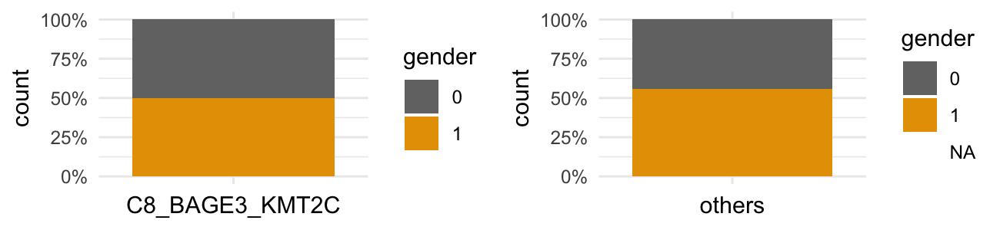

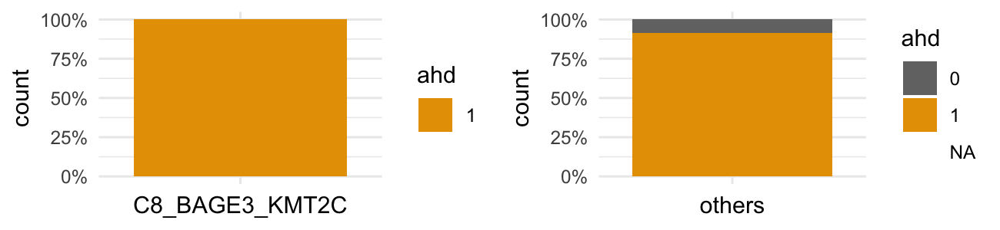

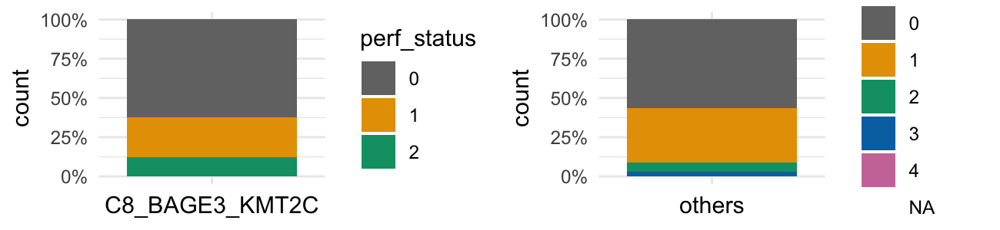

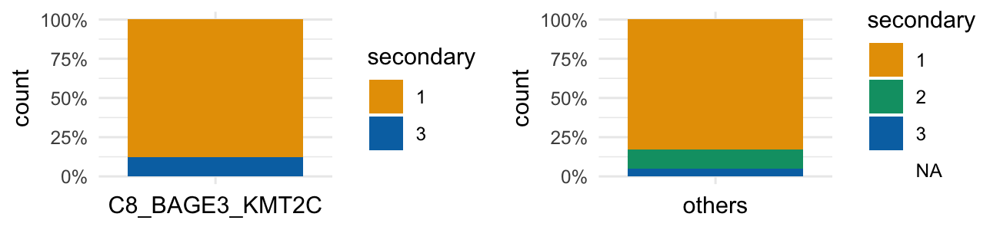

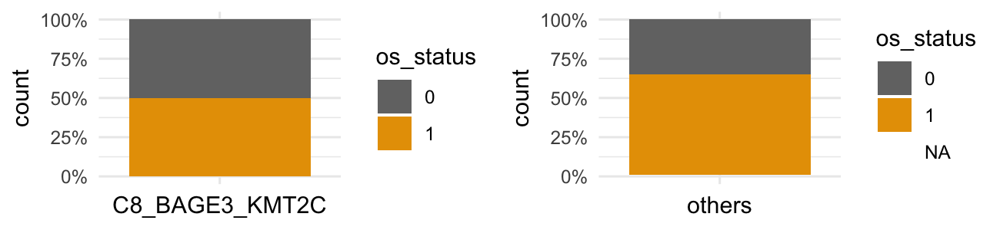

...

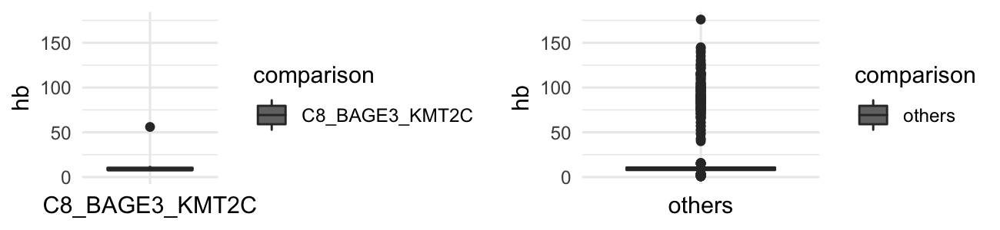

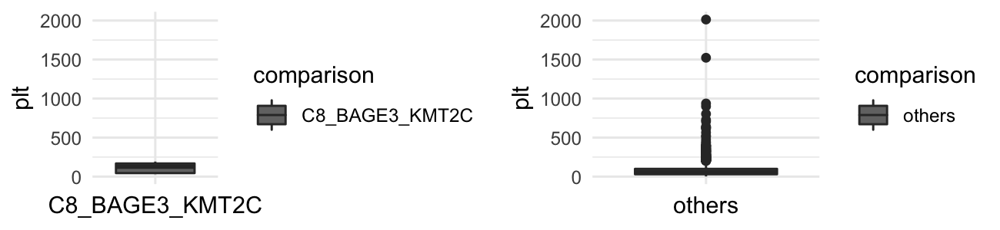

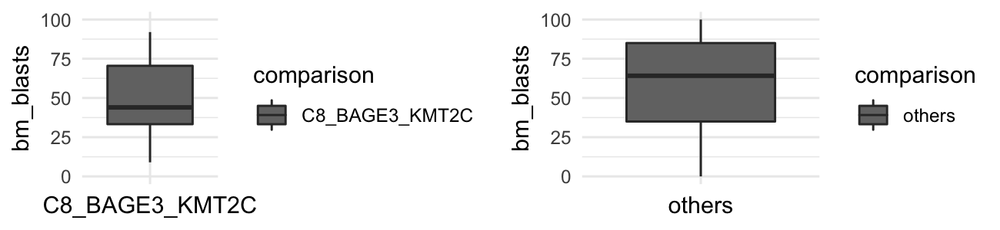

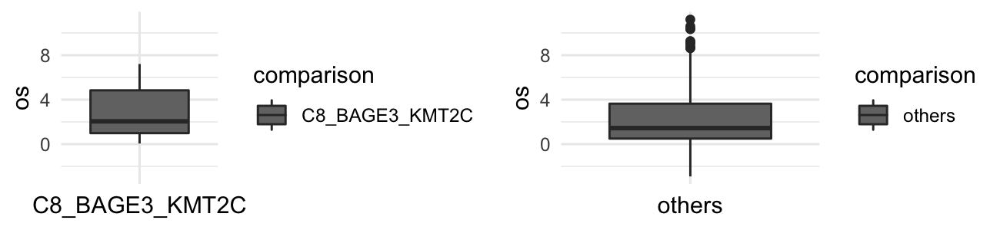

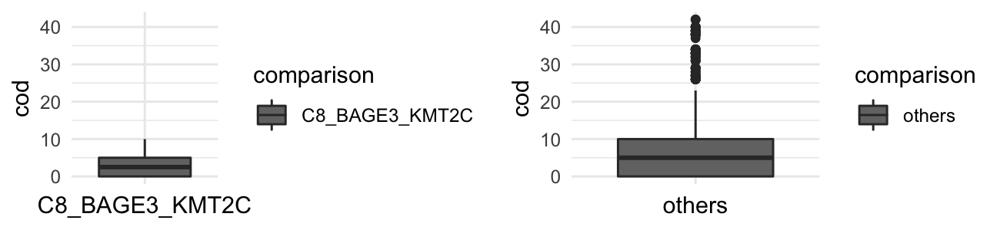

In [66]:
df_c_8$comparison <- ifelse((df_c_8$predicted_component==8) & (df_c_8$BAGE3==1) & (df_c_8$KMT2C==1) , "C8_BAGE3_KMT2C","others" )
plottings_comparison(df_c_8[df_c_8$comparison=="C8_BAGE3_KMT2C",],df_c_8[(df_c_8$comparison=="others"),],x1="C8_BAGE3_KMT2C",x2="others",many=2,width=6.5,height=1.5)
#set_notebook_plot_size(6.5,1.5)

<a id='comp8'></a>

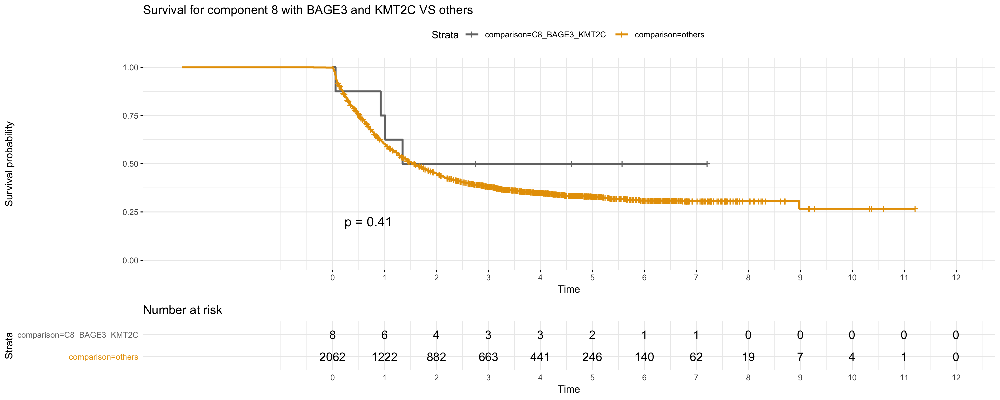

In [67]:
set_notebook_plot_size(15,5)
plot_surv(df_c_8,"Survival for component 8 with BAGE3 and KMT2C VS others")

# New Component 1 AND 2 comparison

In [68]:
df_c_9 <- merge(df_w_correlates,df_all_components[c("SRSF2","RUNX1","STAG2","U2AF1","MLL","TET2","NF1","SETBP1")],by=0)
rownames(df_c_9) <- df_c_9$Row.names
df_c_9 <- df_c_9 [,-1]

[1] "Count : NC1_SRSF2_RUNX1_STAG2 : 25"
[1] "Count : NC2_U2AF1_MLL : 25"
[1] "Count : NC1_others : 279"
[1] "Count : NC2_others : 145"


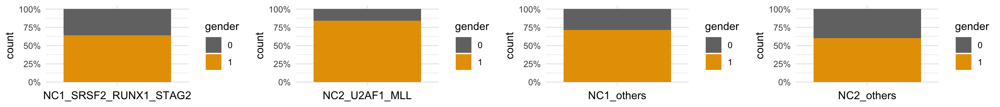

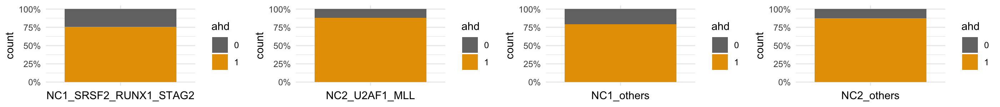

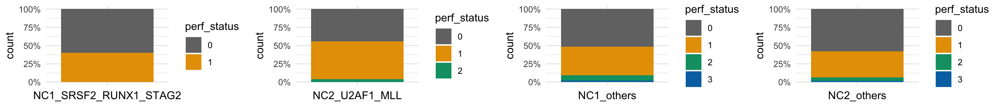

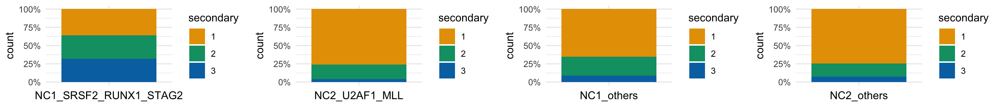

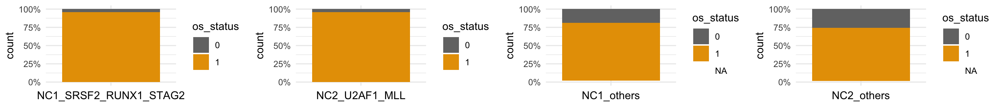

...

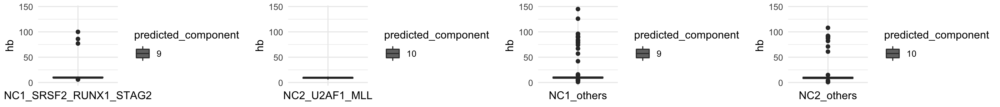

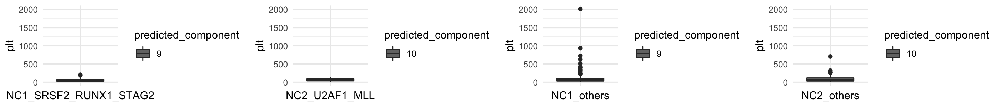

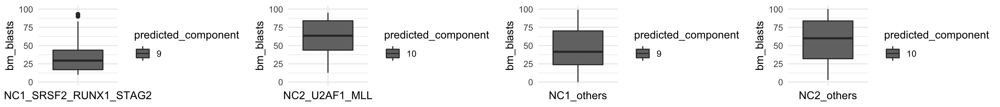

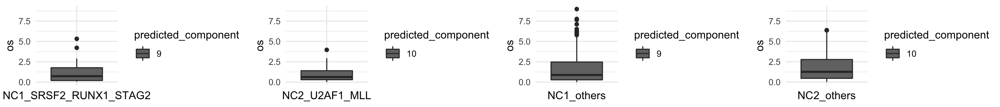

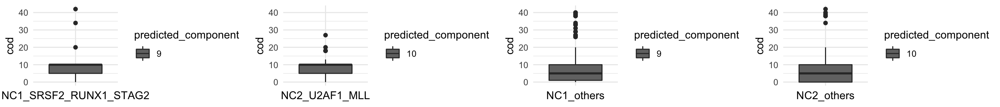

In [69]:
df_c_9$comparison <- ifelse((df_c_9$predicted_component==9) & (df_c_9$SRSF2==1) & (df_c_9$RUNX1==1) &(df_c_9$STAG2==1) , "NC1_SRSF2_RUNX1_STAG2",
                            ifelse((df_c_9$predicted_component==10) & (df_c_9$U2AF1==1) & (df_c_9$MLL==1),"NC2_U2AF1_MLL", 
                            ifelse((df_c_9$predicted_component==9)  & !((df_c_9$SRSF2==1) & (df_c_9$RUNX1==1) &(df_c_9$STAG2==1)),"NC1_others",
                            ifelse((df_c_9$predicted_component==10)  & !((df_c_9$U2AF1==1) & (df_c_9$MLL==1)),"NC2_others",
                                   "others" ))))
plottings(df_c_9[(df_c_9$predicted_component==9) & (df_c_9$SRSF2==1) & (df_c_9$RUNX1==1) &(df_c_9$STAG2==1),],
          df_c_9[(df_c_9$predicted_component==10) & (df_c_9$U2AF1==1) & (df_c_9$MLL==1),],
          df_c_9[(df_c_9$predicted_component==9)  & !((df_c_9$SRSF2==1) & (df_c_9$RUNX1==1) &(df_c_9$STAG2==1)),],
          df_c_9[(df_c_9$predicted_component==10)  & !((df_c_9$U2AF1==1) & (df_c_9$MLL==1)),],       
          x1="NC1_SRSF2_RUNX1_STAG2",x2="NC2_U2AF1_MLL",x3="NC1_others",x4="NC2_others",many=4,width=14,height=1.5)

<a id='nc1-2'></a>

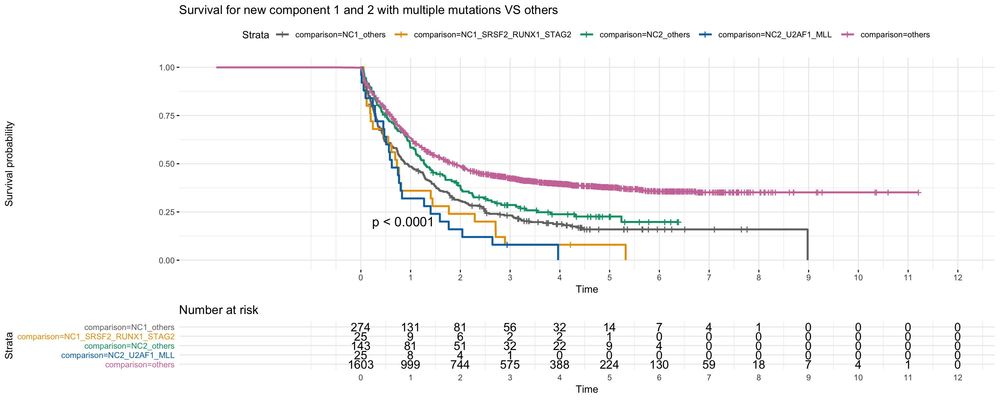

In [70]:
set_notebook_plot_size(15,6)
plot_surv(df_c_9,"Survival for new component 1 and 2 with multiple mutations VS others")

# Component 2 when DNMT3A and ITD mutation

In [71]:
df_c_10 <- merge(df_w_correlates,df_all_components[c("DNMT3A","ITD")],by=0)
rownames(df_c_10) <- df_c_10$Row.names
df_c_10 <- df_c_10 [,-1]

[1] "Count : NC2_DNMT3A_ITD : 30"
[1] "Count : others_DNMT3A_ITD : 172"
[1] "Count : NC2_without : 140"
[1] "Count : others_without : 1752"


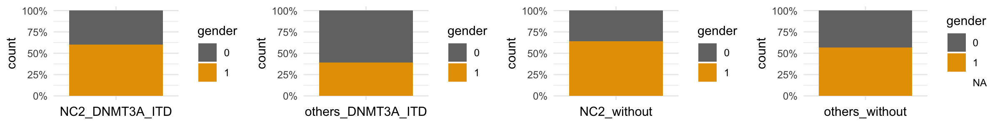

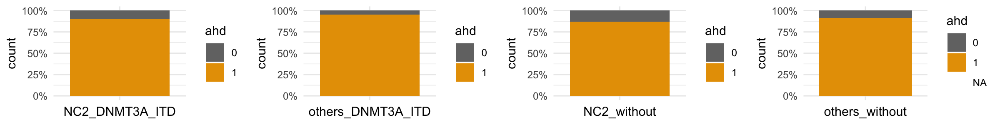

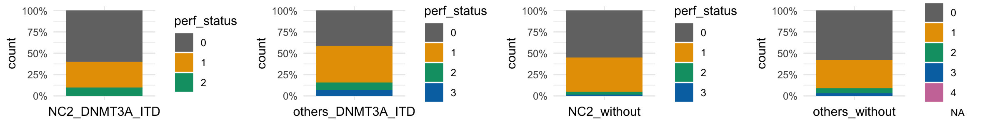

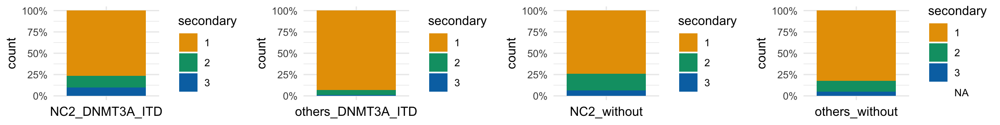

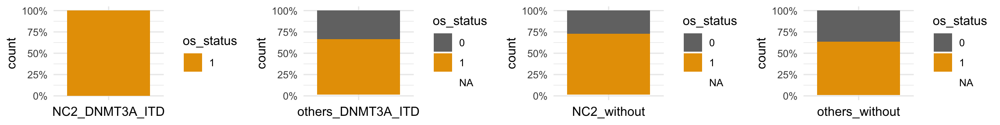

...

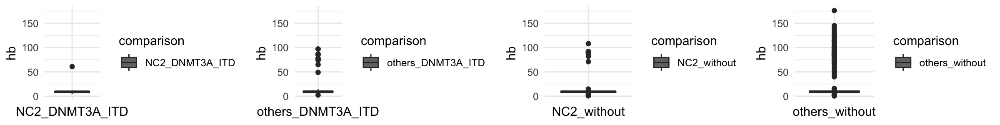

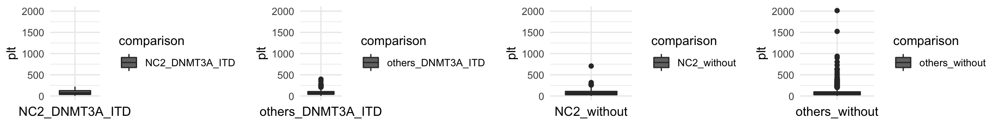

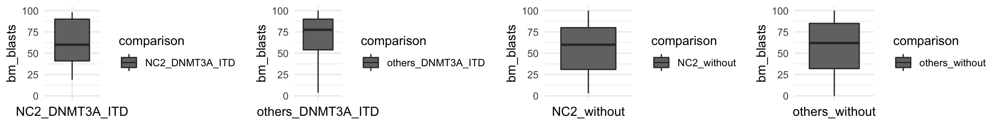

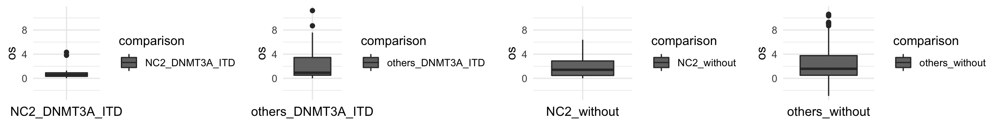

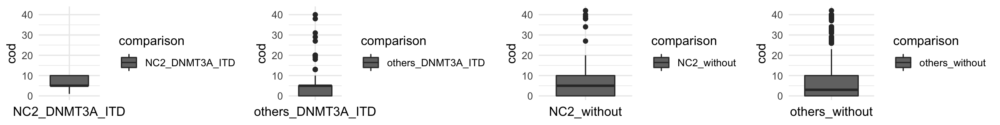

In [72]:
df_c_10$comparison <- ifelse((df_c_10$predicted_component==10) & (df_c_10$DNMT3A==1) & (df_c_10$ITD==1) , "NC2_DNMT3A_ITD",
                      ifelse((df_c_10$predicted_component==10) & !((df_c_10$DNMT3A==1) & (df_c_10$ITD==1)),"NC2_without",
                      ifelse((df_c_10$predicted_component!=10) & (df_c_10$DNMT3A==1) & (df_c_10$ITD==1),"others_DNMT3A_ITD","others_without")))
plottings_comparison(df_c_10[(df_c_10$comparison=="NC2_DNMT3A_ITD"),],
                     df_c_10[(df_c_10$comparison=="others_DNMT3A_ITD"),],
                     df_c_10[(df_c_10$comparison=="NC2_without"),],
                     df_c_10[(df_c_10$comparison=="others_without"),],
          x1="NC2_DNMT3A_ITD",x2="others_DNMT3A_ITD",x3="NC2_without",x4="others_without",many=4,width=12,height=1.5)


<a id='nc2'></a>

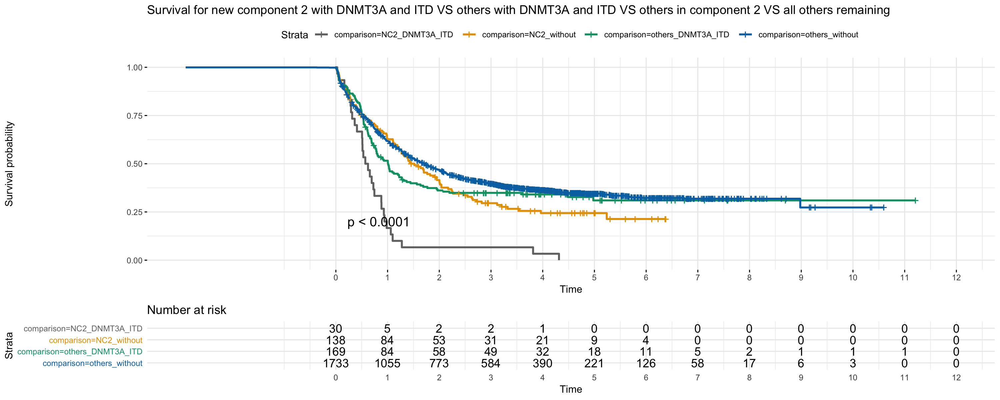

In [73]:
set_notebook_plot_size(15,5.5)
plot_surv(df_c_10,"Survival for new component 2 with DNMT3A and ITD VS others with DNMT3A and ITD VS others in component 2 VS all others remaining")

<a id='investigation'></a>

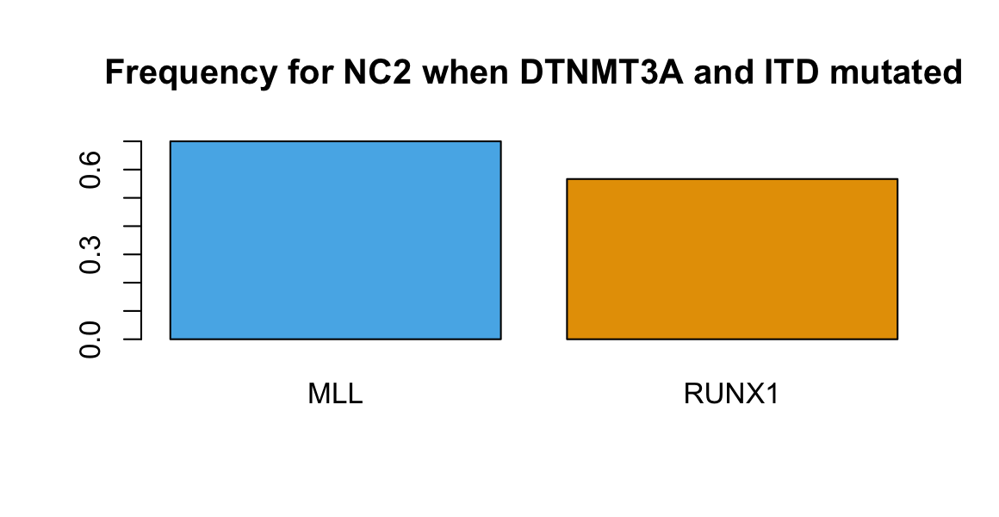

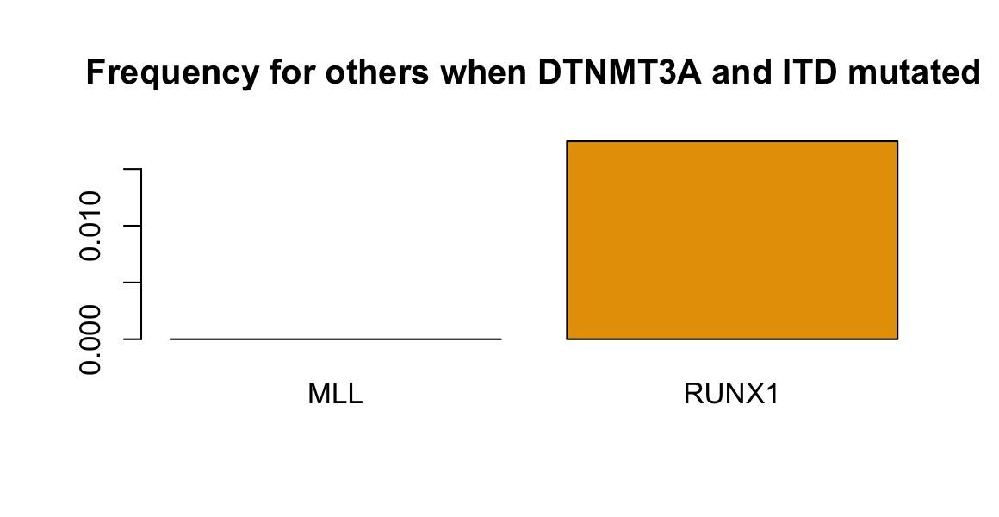

In [74]:
tmp <- merge(df_w_correlates,df_all_components[c("DNMT3A","ITD","BCOR","FLT3_other","MLL","PHF6","RUNX1","SF3B1","U2AF1","WT1")],by=0)
rownames(tmp) <- tmp$Row.names
tmp <- tmp [,-1]

set_notebook_plot_size(5.8,3)
barplot(colSums(tmp[tmp$predicted_component==10 & tmp$DNMT3A==1 & tmp$ITD==1,c(19,21)])/dim(tmp[tmp$predicted_component==10 & tmp$DNMT3A==1 & tmp$ITD==1,c(19,21)])[1],col=c("#56B4E9","#E69F00"),main="Frequency for NC2 when DTNMT3A and ITD mutated")
barplot(colSums(tmp[tmp$predicted_component!=10 & tmp$DNMT3A==1 & tmp$ITD==1,c(19,21)])/dim(tmp[tmp$predicted_component!=10 & tmp$DNMT3A==1 & tmp$ITD==1,c(19,21)])[1],col=c("#56B4E9","#E69F00"),main="Frequency for others when DTNMT3A and ITD mutated")


# Comparison new component 1 VS new component 3 for SRSF2

In [75]:
df_c_11 <- merge(df_w_correlates,df_all_components[c("SRSF2","RUNX1","STAG2")],by=0)
rownames(df_c_11) <- df_c_11$Row.names
df_c_11 <- df_c_11 [,-1]

[1] "Count : NC1_SRSF2_RUNX1_STAG2 : 25"
[1] "Count : NC3_SRSF2 : 44"
[1] "Count : NC1_SRSF2_others : 132"
[1] "Count : NC3_others : 8"


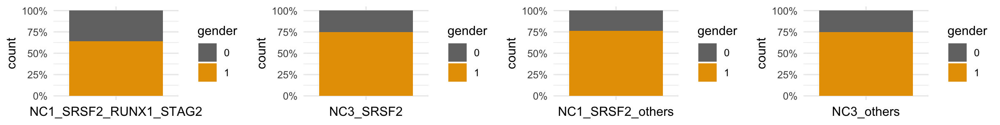

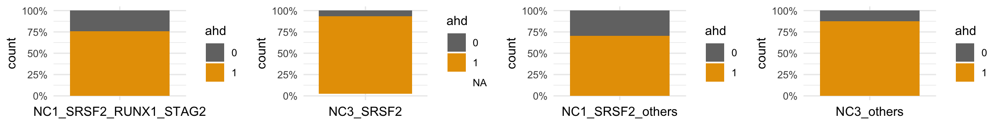

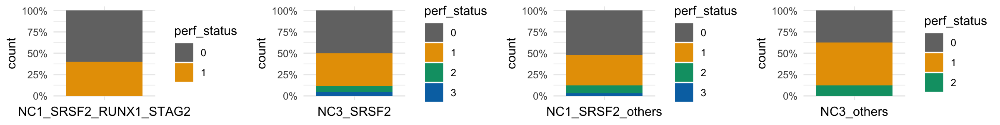

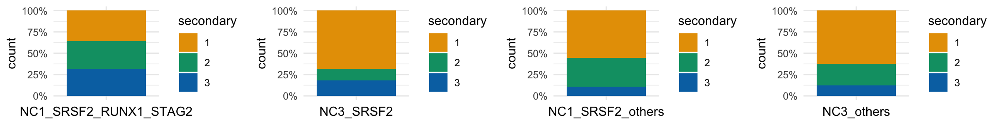

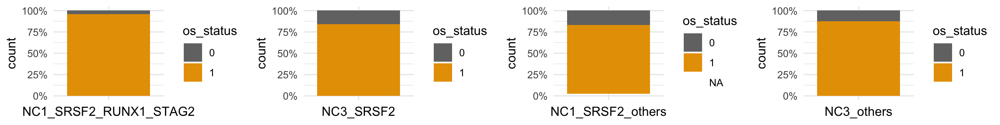

...

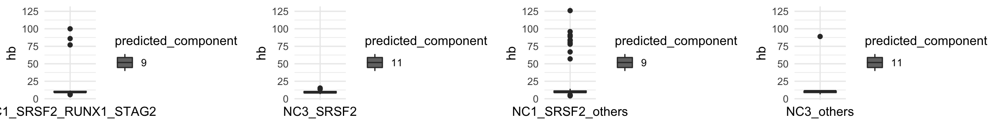

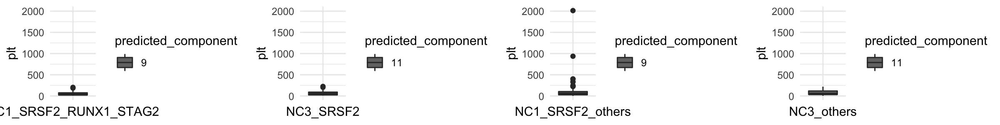

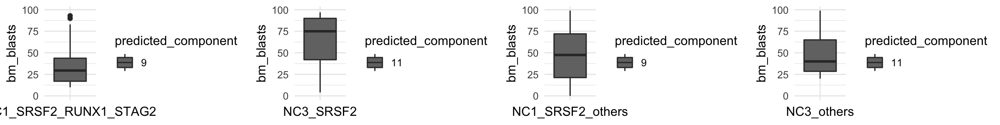

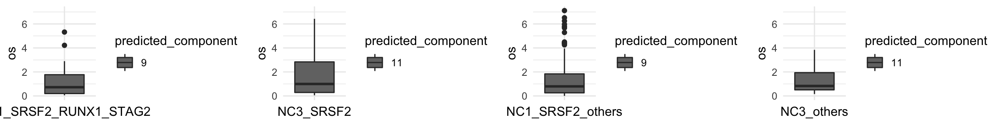

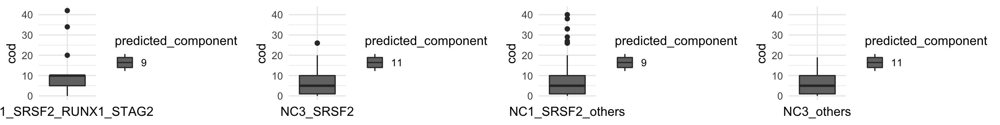

In [76]:
df_c_11$comparison <- ifelse((df_c_11$predicted_component==9) & (df_c_11$SRSF2==1) & (df_c_11$RUNX1==1) & (df_c_11$STAG2==1) , "NC1_SRSF2_RUNX1_STAG2",
                      ifelse((df_c_11$predicted_component==9) & (df_c_11$SRSF2==1) & !((df_c_11$RUNX1==1) & (df_c_11$STAG2==1)),"NC1_SRSF2_others",
                      ifelse((df_c_11$predicted_component==11) & (df_c_11$SRSF2==1),"NC3_SRSF2",
                      ifelse((df_c_11$predicted_component==11) & !(df_c_11$SRSF2==1),"NC3_others","others"))))
plottings(df_c_11[df_c_11$comparison=="NC1_SRSF2_RUNX1_STAG2",],
          df_c_11[df_c_11$comparison=="NC3_SRSF2",],
          df_c_11[df_c_11$comparison=="NC1_SRSF2_others",],
          df_c_11[df_c_11$comparison=="NC3_others",],
          x1="NC1_SRSF2_RUNX1_STAG2",x2="NC3_SRSF2",x3="NC1_SRSF2_others",x4="NC3_others",many=4,width=12,height=1.5)


<a id='nc1-3'></a>

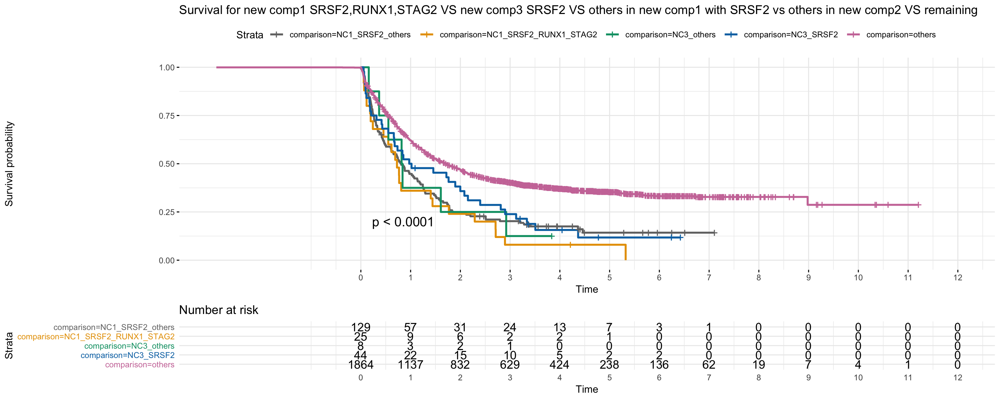

In [77]:
set_notebook_plot_size(15,6)
plot_surv(df_c_11,"Survival for new comp1 SRSF2,RUNX1,STAG2 VS new comp3 SRSF2 VS others in new comp1 with SRSF2 vs others in new comp2 VS remaining")

# New Component 4

In [78]:
df_c_12 <- merge(df_w_correlates,df_all_components[c("DNMT3A","IDH2_p.R172","IDH2_p.R140")],by=0)
rownames(df_c_12) <- df_c_12$Row.names
df_c_12 <- df_c_12 [,-1]

[1] "Count : NC4_DNMT3A_IDH2 : 44"
[1] "Count : NC4_DNMT3A : 5"
[1] "Count : NC4_IDH2 : 8"


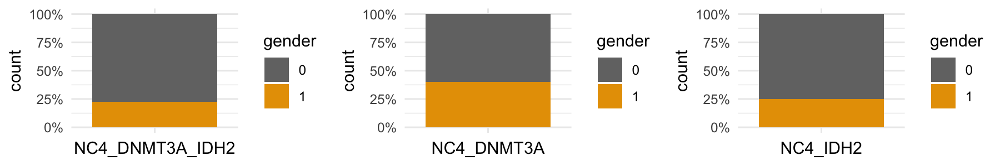

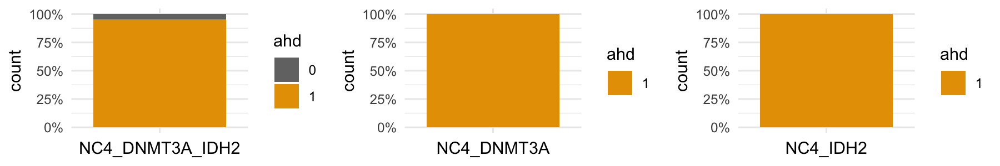

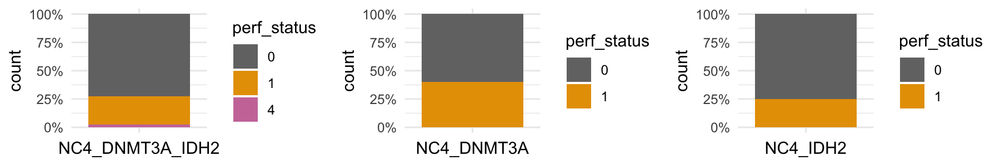

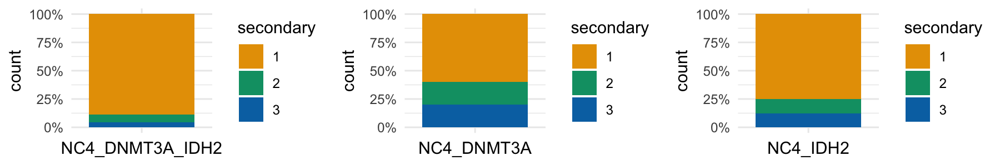

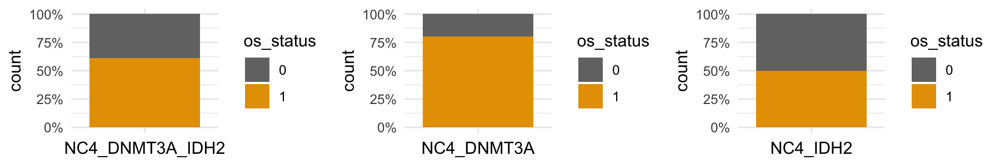

...

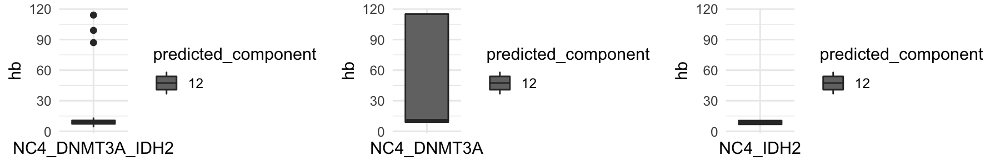

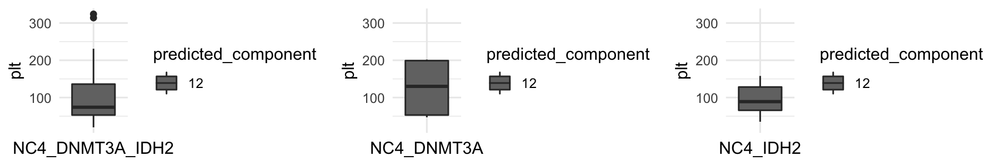

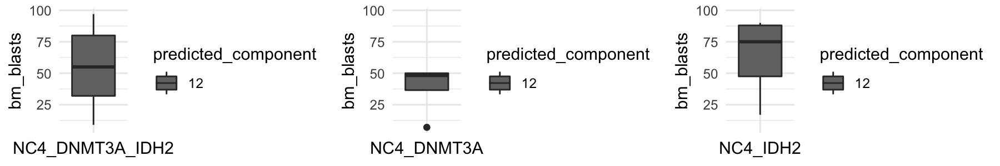

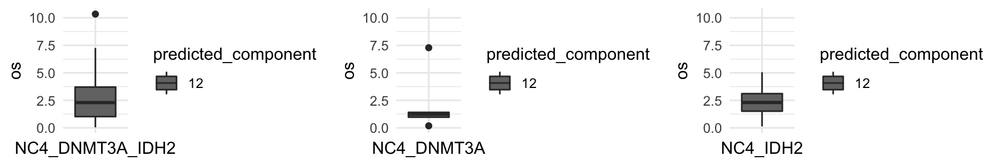

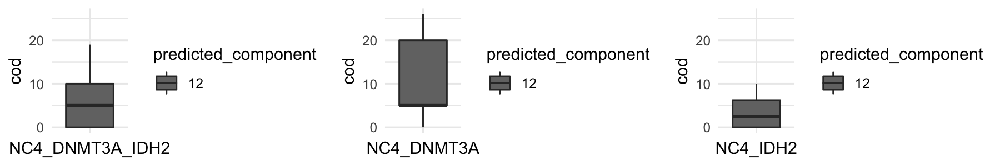

In [79]:
df_c_12$comparison <- ifelse((df_c_12$predicted_component==12) & (df_c_12$DNMT3A==1) & (df_c_12$IDH2_p.R172==1 | df_c_12$IDH2_p.R140==1) , "NC4_DNMT3A_IDH2",
                      ifelse((df_c_12$predicted_component==12) & (df_c_12$DNMT3A==1) & (df_c_12$IDH2_p.R172==0) & (df_c_12$IDH2_p.R140==0),"NC4_DNMT3A",
                      ifelse((df_c_12$predicted_component==12) & (df_c_12$DNMT3A==0) & (df_c_12$IDH2_p.R172==1 | df_c_12$IDH2_p.R140==1),"NC4_IDH2","others")))
plottings(df_c_12[(df_c_12$predicted_component==12) & (df_c_12$DNMT3A==1) & (df_c_12$IDH2_p.R172==1 | df_c_12$IDH2_p.R140==1),],
          df_c_12[(df_c_12$predicted_component==12) & (df_c_12$DNMT3A==1) & (df_c_12$IDH2_p.R172==0) & (df_c_12$IDH2_p.R140==0),],
          df_c_12[(df_c_12$predicted_component==12) & (df_c_12$DNMT3A==0) & (df_c_12$IDH2_p.R172==1 | df_c_12$IDH2_p.R140==1),],
          x1="NC4_DNMT3A_IDH2",x2="NC4_DNMT3A",x3="NC4_IDH2",many=3,width=9,height=1.5)

<a id='nc4'></a>

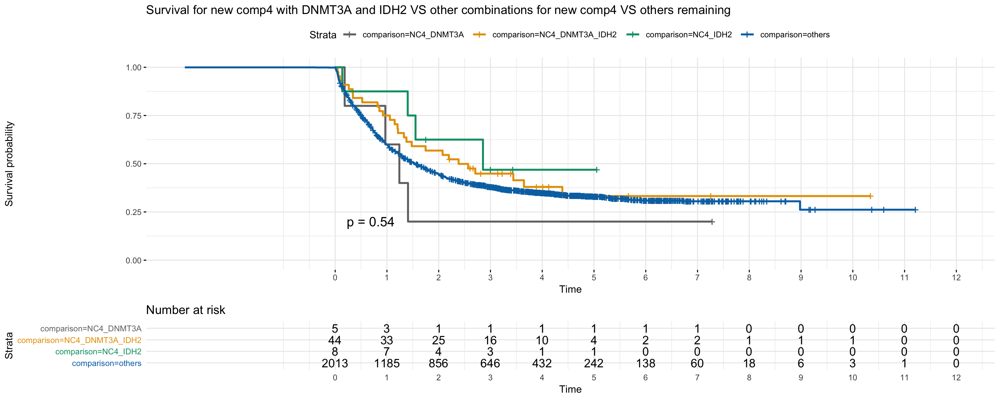

In [80]:
set_notebook_plot_size(15,5.5)
plot_surv(df_c_12,"Survival for new comp4 with DNMT3A and IDH2 VS other combinations for new comp4 VS others remaining")

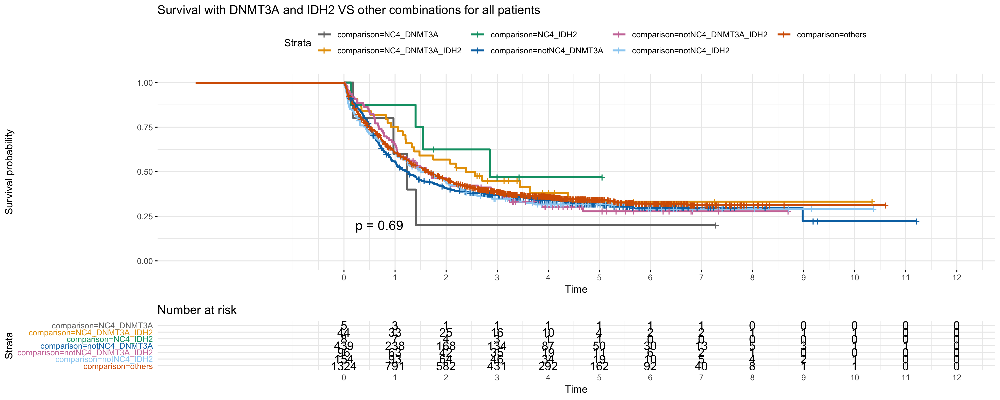

In [81]:
tmp <-df_c_12
tmp$comparison <- ifelse((tmp$predicted_component==12) & (tmp$DNMT3A==1) & (tmp$IDH2_p.R172==1 | tmp$IDH2_p.R140==1) , "NC4_DNMT3A_IDH2",
                  ifelse((tmp$predicted_component==12) & (tmp$DNMT3A==1) & (tmp$IDH2_p.R172==0) & (tmp$IDH2_p.R140==0),"NC4_DNMT3A",
                  ifelse((tmp$predicted_component==12) & (tmp$DNMT3A==0) & (tmp$IDH2_p.R172==1 | tmp$IDH2_p.R140==1),"NC4_IDH2",
                  ifelse((tmp$predicted_component!=12) & (tmp$DNMT3A==1) & (tmp$IDH2_p.R172==1 | tmp$IDH2_p.R140==1) , "notNC4_DNMT3A_IDH2",
                  ifelse((tmp$predicted_component!=12) & (tmp$DNMT3A==1) & (tmp$IDH2_p.R172==0) & (tmp$IDH2_p.R140==0),"notNC4_DNMT3A",
                  ifelse((tmp$predicted_component!=12) & (tmp$DNMT3A==0) & (tmp$IDH2_p.R172==1 | tmp$IDH2_p.R140==1),"notNC4_IDH2",
                             "others"))))))
set_notebook_plot_size(15,9)
plot_surv(tmp,"Survival with DNMT3A and IDH2 VS other combinations for all patients")

# New component 5

In [82]:
df_c_13 <- merge(df_w_correlates,df_all_components[c("t_15_17","complex","RUNX1")],by=0)
rownames(df_c_13) <- df_c_13$Row.names
df_c_13 <- df_c_13 [,-1]

[1] "Count : NC5_t_15_17 : 10"
[1] "Count : NC5_without : 20"
[1] "Count : others_t_15_17 : 11"


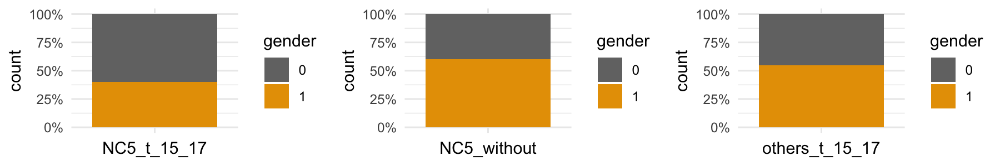

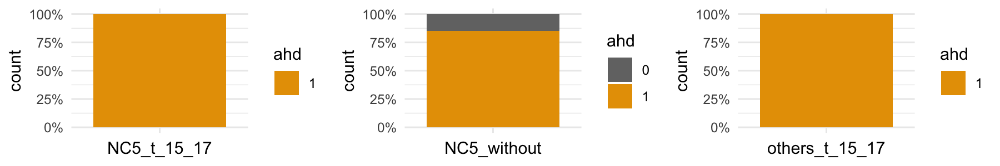

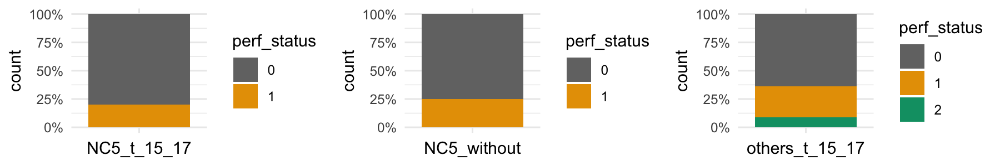

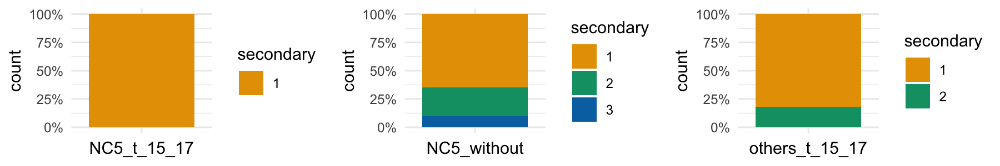

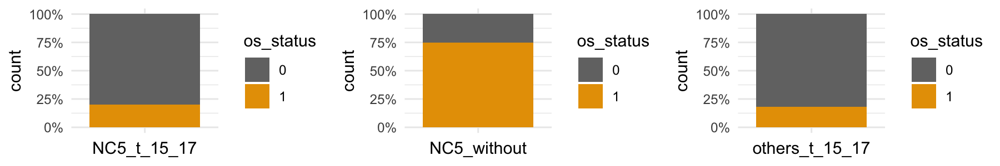

...

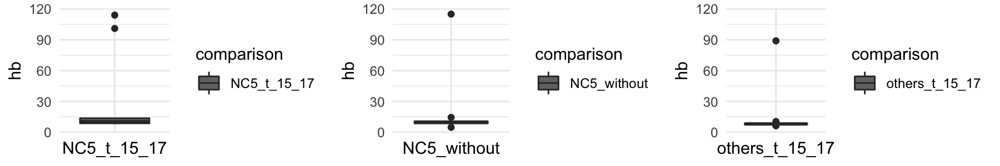

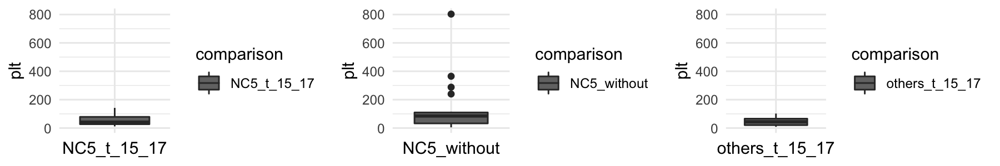

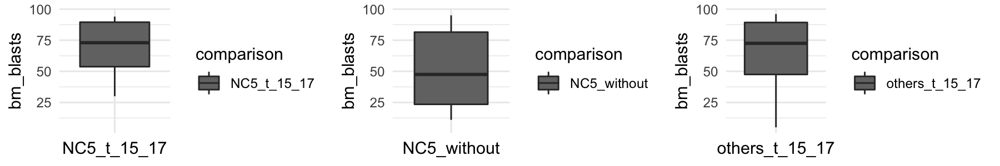

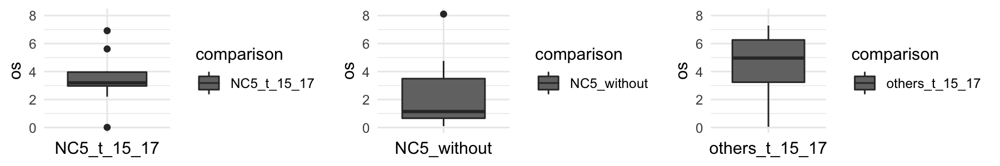

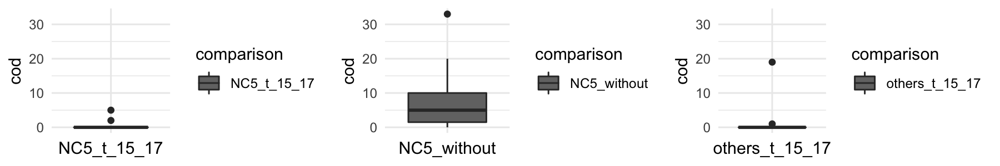

In [83]:
df_c_13$comparison <- ifelse((df_c_13$predicted_component==13) & (df_c_13$t_15_17==1), "NC5_t_15_17",
                      ifelse((df_c_13$predicted_component==13) & (df_c_13$t_15_17==0),"NC5_without",
                      ifelse((df_c_13$predicted_component!=13) & (df_c_13$t_15_17==1),"others_t_15_17","others_without")))

plottings_comparison(df_c_13[df_c_13$comparison=="NC5_t_15_17",],
                     df_c_13[df_c_13$comparison=="NC5_without",],
                     df_c_13[df_c_13$comparison=="others_t_15_17",],
                     x1="NC5_t_15_17",x2="NC5_without",x3="others_t_15_17",many=3,width=9,height=1.5)



<a id='nc5'></a>

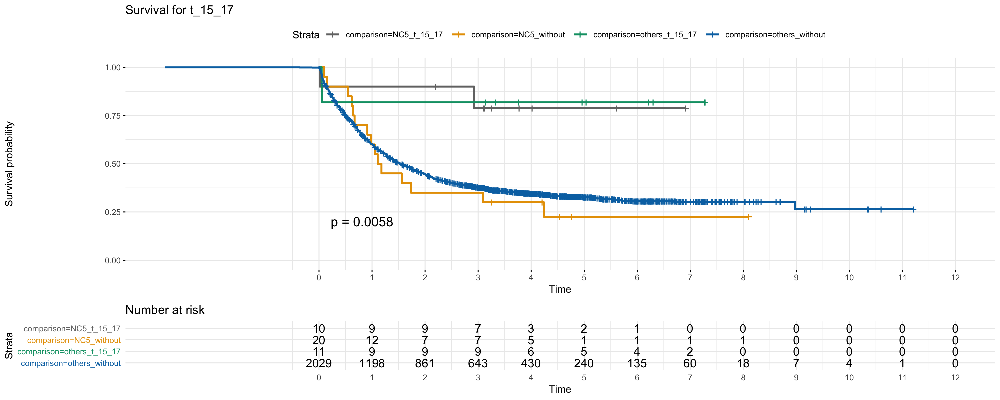

In [84]:
set_notebook_plot_size(15,5.5)
plot_surv(df_c_13,"Survival for t_15_17")

# New component 6

In [85]:
df_c_14 <- merge(df_w_correlates,df_all_components[c("U2AF1","SETBP1","NF1")],by=0)
rownames(df_c_14) <- df_c_14$Row.names
df_c_14 <- df_c_14 [,-1]

[1] "Count : NC6_U2AF1_NF1 : 6"
[1] "Count : NC6_U2AF1_SETBP1 : 6"
[1] "Count : NC6_NF1_SETBP1 : 6"
[1] "Count : NC6_others : 21"


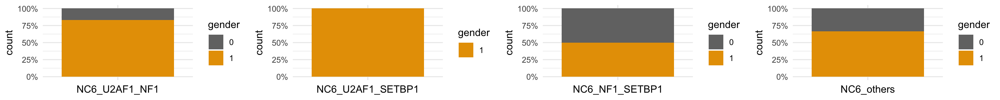

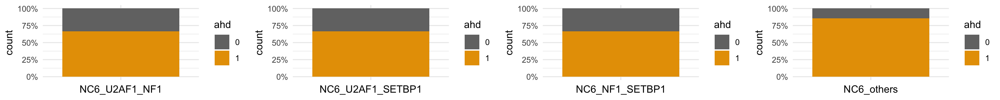

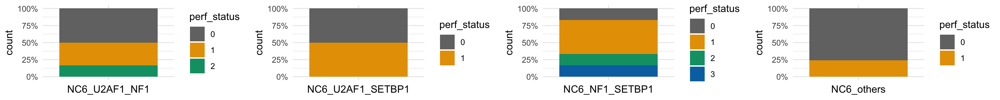

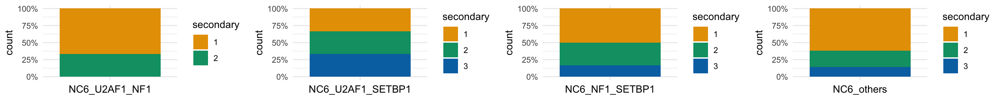

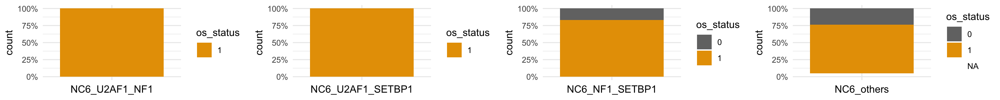

...

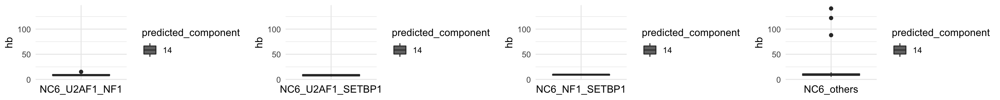

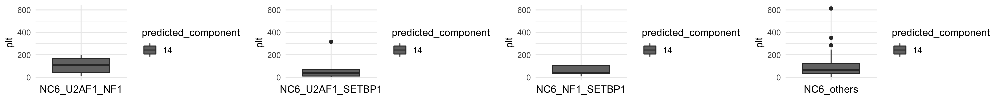

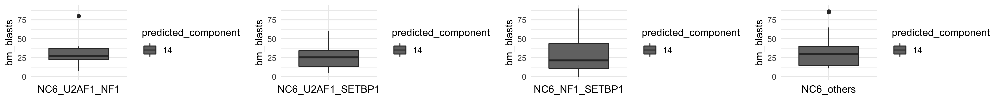

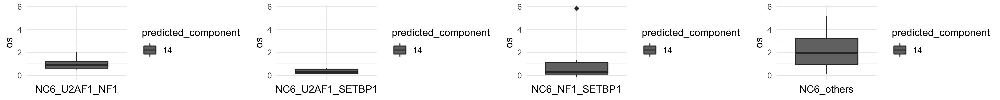

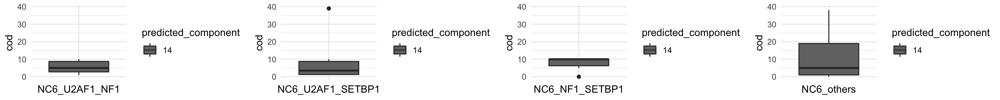

In [86]:
df_c_14$comparison <- ifelse((df_c_14$predicted_component==14) & (df_c_14$U2AF1==1) & (df_c_14$NF1==1) & (df_c_14$SETBP1==0) , "NC6_U2AF1_NF1",
                      ifelse((df_c_14$predicted_component==14) & (df_c_14$U2AF1==1) & (df_c_14$NF1==0) & (df_c_14$SETBP1==1),"NC6_U2AF1_SETBP1",
                      ifelse((df_c_14$predicted_component==14) & (df_c_14$U2AF1==0) & (df_c_14$NF1==1) & (df_c_14$SETBP1==1),"NC6_NF1_SETBP1",
                      ifelse((df_c_14$predicted_component==14) & !((df_c_14$U2AF1==1) & (df_c_14$NF1==1) & (df_c_14$SETBP1==0)) & !((df_c_14$U2AF1==1) & (df_c_14$NF1==0) & (df_c_14$SETBP1==1)) & !((df_c_14$U2AF1==0) & (df_c_14$NF1==1) & (df_c_14$SETBP1==1)),"NC6_others","others"))))
plottings(df_c_14[(df_c_14$predicted_component==14) & (df_c_14$U2AF1==1) & (df_c_14$NF1==1) & (df_c_14$SETBP1==0),],
          df_c_14[(df_c_14$predicted_component==14) & (df_c_14$U2AF1==1) & (df_c_14$NF1==0) & (df_c_14$SETBP1==1),],
          df_c_14[(df_c_14$predicted_component==14) & (df_c_14$U2AF1==0) & (df_c_14$NF1==1) & (df_c_14$SETBP1==1),],
          df_c_14[(df_c_14$predicted_component==14) & !((df_c_14$U2AF1==1) & (df_c_14$NF1==1) & (df_c_14$SETBP1==0)) & !((df_c_14$U2AF1==1) & (df_c_14$NF1==0) & (df_c_14$SETBP1==1)) & !((df_c_14$U2AF1==0) & (df_c_14$NF1==1) & (df_c_14$SETBP1==1)),],
          x1="NC6_U2AF1_NF1",x2="NC6_U2AF1_SETBP1",x3="NC6_NF1_SETBP1",x4="NC6_others",many=4,width=15,height=1.5)

<a id='nc6'></a>

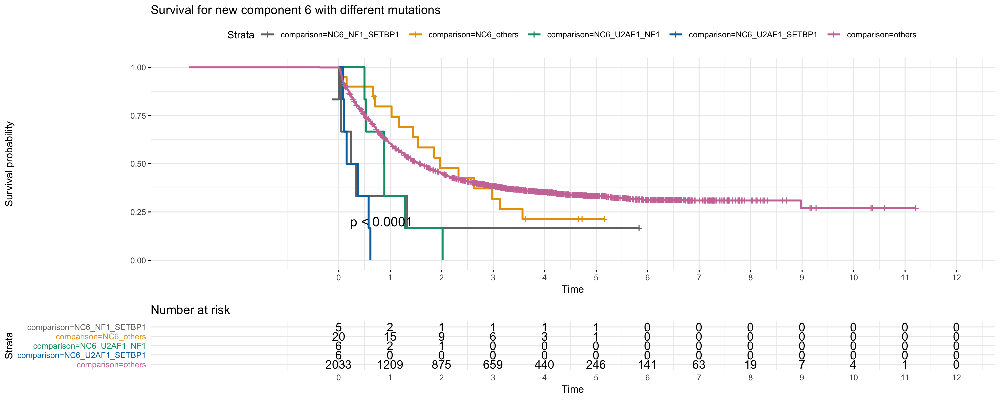

In [87]:
set_notebook_plot_size(15,6)
plot_surv(df_c_14,"Survival for new component 6 with different mutations")

<a id='u2af1'></a>

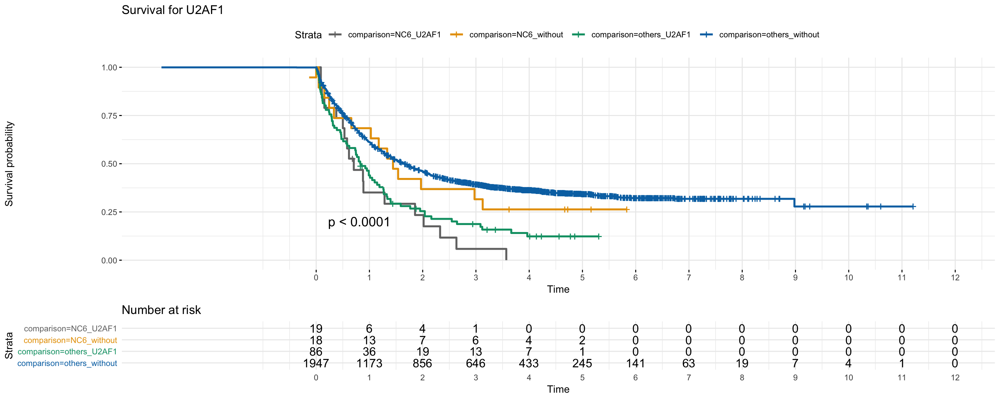

In [88]:
tmp <- merge(df_w_correlates,df_all_components[c("U2AF1","NF1","SETBP1")],by=0)
rownames(tmp) <- tmp$Row.names
tmp <- tmp [,-1]
tmp$comparison <- ifelse((tmp$predicted_component==14) & (tmp$U2AF1==1)   , "NC6_U2AF1",
                  ifelse((tmp$predicted_component==14) & (tmp$U2AF1==0),"NC6_without",
                  ifelse((tmp$predicted_component!=14) & (tmp$U2AF1==1),"others_U2AF1",   
                             "others_without")))
plot_surv(tmp,"Survival for U2AF1 ")

# New component 7

In [89]:
df_c_15 <- merge(df_w_correlates,df_all_components[c("GATA1","JAK3","RAD21")],by=0)
rownames(df_c_15) <- df_c_15$Row.names
df_c_15 <- df_c_15 [,-1]

[1] "Count : NC7_GATA1_JAK3 : 3"
[1] "Count : NC7_others : 2"


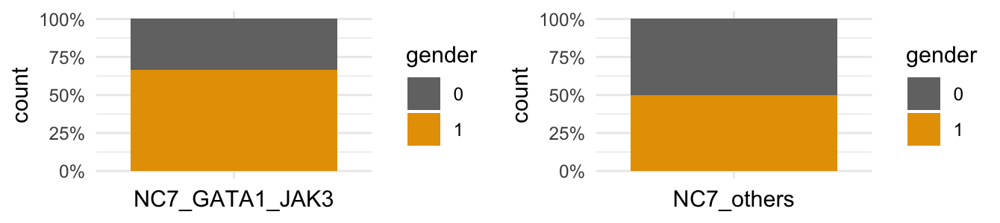

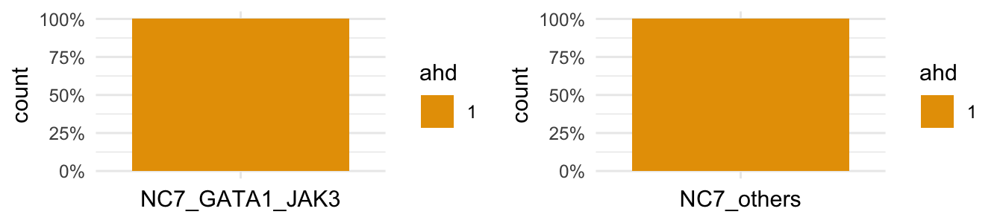

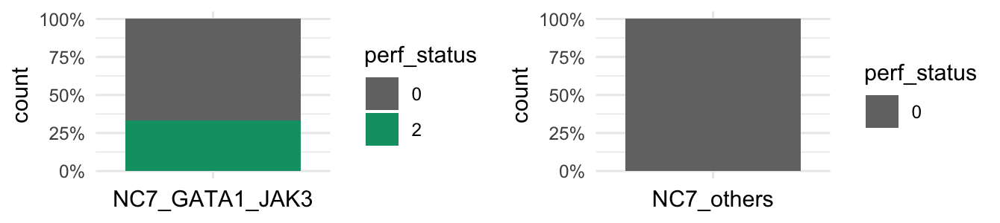

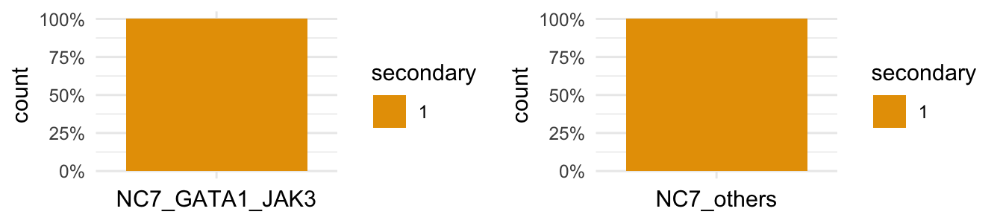

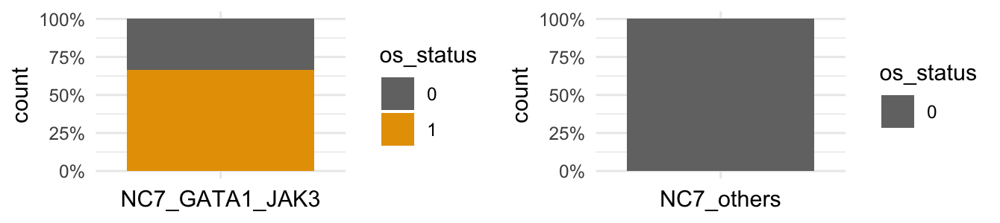

...

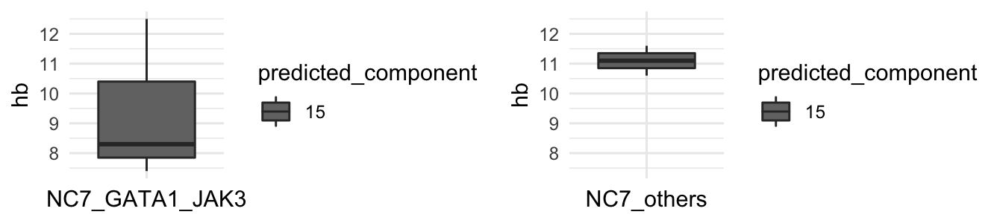

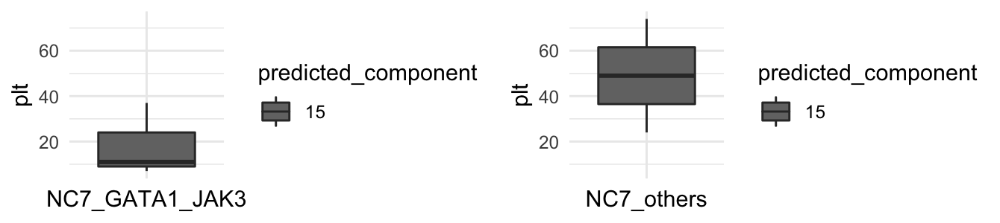

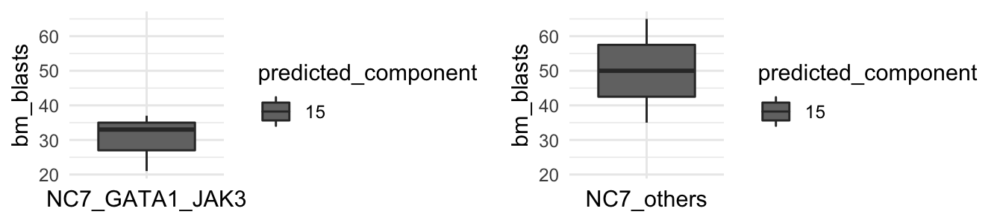

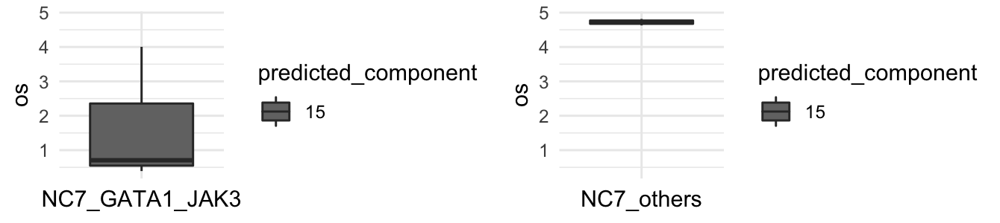

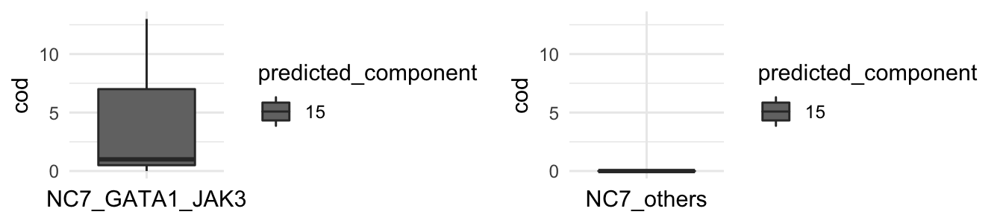

In [90]:
df_c_15$comparison <- ifelse((df_c_15$predicted_component==15) & (df_c_15$GATA1==1) & (df_c_15$JAK3==1) , "NC7_GATA1_JAK3",
                      ifelse((df_c_15$predicted_component==15) & !((df_c_15$GATA1==1) & (df_c_15$JAK3==1)) ,"NC7_others","others"))
plottings(df_c_15[(df_c_15$predicted_component==15) & (df_c_15$GATA1==1) & (df_c_15$JAK3==1),],
          df_c_15[(df_c_15$predicted_component==15) & !((df_c_15$GATA1==1) & (df_c_15$JAK3==1)),],
          x1="NC7_GATA1_JAK3",x2="NC7_others",many=2,width=6.7,height=1.5)
                             


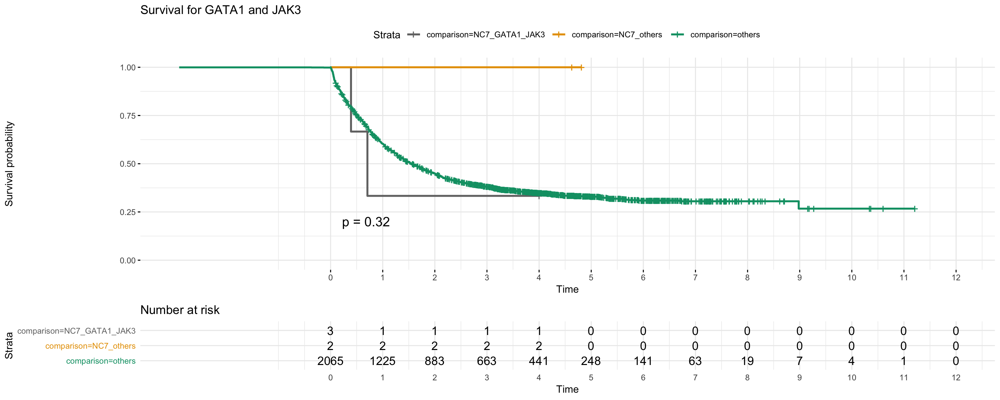

In [91]:
set_notebook_plot_size(15,5)
plot_surv(df_c_15,"Survival for GATA1 and JAK3 ")

<a id='nc7'></a>

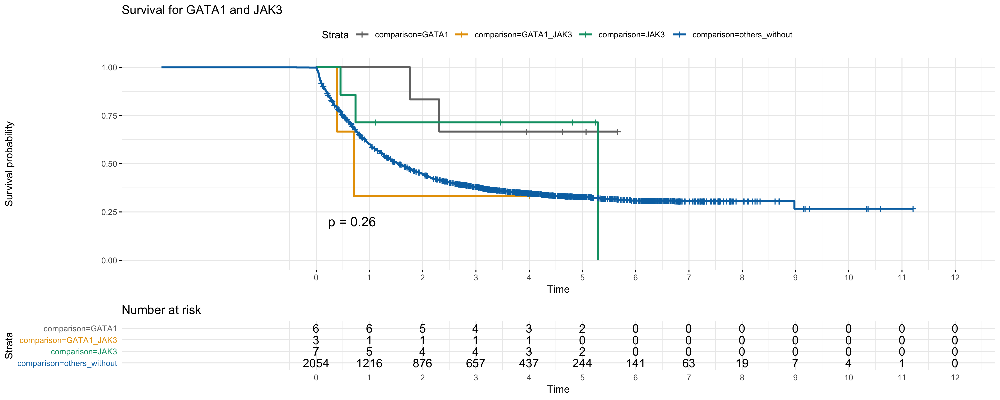

In [92]:
set_notebook_plot_size(15,5.5)
tmp <- merge(df_w_correlates,df_all_components[c("GATA1","JAK3")],by=0)
rownames(tmp) <- tmp$Row.names
tmp <- tmp [,-1]
tmp$comparison <- ifelse((tmp$GATA1==1) & (tmp$JAK3==1)  ,"GATA1_JAK3",
                  ifelse((tmp$JAK3==1),"JAK3",
                  ifelse((tmp$GATA1==1), "GATA1","others_without")))
plot_surv(tmp,"Survival for GATA1 and JAK3")